# MultiOmics RNA + ATAC for Chao dataset (MORNAATACC) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

This notebook starts after reads alignment made by cellranger-arc2 for multiomics data.

Samples have been aggregate using cellranger-arcs aggregate without read normalization

In [ ]:
#Memory needed for a full run : 256Gb

In [17]:
#Early1               = P21208_1003_EAE_ARC
#PeakCtrl2            = P21208_1004_EAE_ARC
#Peak2                = P21208_1005_EAE_ARC
#LateCtrl1            = MORNAATACC_1002 (P21520_1002)
#Late1                = MORNAATACC_1003 (P21520_1003)
#Early2               = P23605_1001
#EarlyCtrl2           = P23605_1002
#Peak3                = P23605_1003
#PeakCtrl3            = P23605_1004
#EarlyCtrl3           = P24115_1001
#EarlyFemale3         = P24115_1002
#EarlyMale3           = P24115_1003
#Late2                = P25316_1001
#LateCtrl2            = P25316_1002
#Late3                = P25316_1003
#LateCtrl3            = P25316_1004
#PeakMale4            = P27208_1001
#PeakFemale4          = P27208_1002
#LateMale4            = P27208_1003
#LateFemale4          = P27208_1004
#Naive1               = P26203_1003
#Naive2               = P26203_1004
#Peak5                = P29557_1001
#Late5                = P29557_1002
#Naive3               = P29557_1004
#EarlyCtrl4           = P29557_1005
#EarlyCtrlMale5       = P29557_1006
#EarlyCtrlFemale5     = P29557_1007
#Early4               = P29557_1008
#EarlyMale5           = P29557_1009
#EarlyFemale5         = P29557_1010

## 0. Environment status

In [1]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
R 4.3.2,opt-r-4.3.2,R,sos_r,/opt/R/4.3.2/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [2]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 22.04 LTS
Release:	22.04
Codename:	jammy


In [3]:
lscpu

Architecture:            x86_64
  CPU op-mode(s):        32-bit, 64-bit
  Address sizes:         46 bits physical, 48 bits virtual
  Byte Order:            Little Endian
CPU(s):                  20
  On-line CPU(s) list:   0-19
Vendor ID:               GenuineIntel
  Model name:            Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz
    CPU family:          6
    Model:               79
    Thread(s) per core:  1
    Core(s) per socket:  10
    Socket(s):           2
    Stepping:            1
    CPU max MHz:         3100.0000
    CPU min MHz:         1200.0000
    BogoMIPS:            4389.77
    Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mc
                         a cmov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss 
                         ht tm pbe syscall nx pdpe1gb rdtscp lm constant_tsc arc
                         h_perfmon pebs bts rep_good nopl xtopology nonstop_tsc 
                         aperfmperf eagerfpu pni pclmulqdq dtes64 monitor ds

In [4]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

257389


In [5]:
apt list --installed

Listing... 0%Listing... 0%Listing... 29%Listing... Done
adduser/now 3.118ubuntu5 all [installed,local]
apt-transport-https/now 2.4.11 all [installed,local]
apt/now 2.4.5 amd64 [installed,local]
autoconf/now 2.71-2 all [installed,local]
automake/now 1:1.16.5-1.3 all [installed,local]
autotools-dev/now 20220109.1 all [installed,local]
base-files/now 12ubuntu4.1 amd64 [installed,local]
base-passwd/now 3.5.52build1 amd64 [installed,local]
bash/now 5.1-6ubuntu1 amd64 [installed,local]
binutils-common/now 2.38-4ubuntu2.6 amd64 [installed,local]
binutils-x86-64-linux-gnu/now 2.38-4ubuntu2.6 amd64 [installed,local]
binutils/now 2.38-4ubuntu2.6 amd64 [installed,local]
bsdutils/now 1:2.37.2-4ubuntu3 amd64 [installed,local]
build-essential/now 12.9ubuntu3 amd64 [installed,local]
bzip2/now 1.0.8-5build1 amd64 [installed,local]
ca-certificates-java/now 20190909ubuntu1.2 all [installed,local]
ca-certificates/now 20230311ubuntu0.22.04.1 all [installed,local]
cmake-data/now 3.22.1-1ubuntu1.22.04.2 all

In [6]:
pip list

Package                 Version
----------------------- ---------
boltons                 23.0.0
brotlipy                0.7.0
certifi                 2022.12.7
cffi                    1.15.1
charset-normalizer      2.0.4
conda                   23.3.1
conda-content-trust     0.1.3
conda-package-handling  2.0.2
conda_package_streaming 0.7.0
cryptography            39.0.1
idna                    3.4
jsonpatch               1.32
jsonpointer             2.1
packaging               23.0
pip                     23.0.1
pluggy                  1.0.0
pycosat                 0.6.4
pycparser               2.21
pyOpenSSL               23.0.0
PySocks                 1.7.1
requests                2.28.1
ruamel.yaml             0.17.21
ruamel.yaml.clib        0.2.6
setuptools              65.6.3
six                     1.16.0
toolz                   0.12.0
tqdm                    4.65.0
urllib3                 1.26.15
wheel                   0.38.4
zstandard               0.19.0


In [7]:
jupyter --version

Selected Jupyter core packages...
IPython          : 8.22.2
ipykernel        : 6.29.3
ipywidgets       : 7.7.1
jupyter_client   : 8.6.0
jupyter_core     : 5.7.1
jupyter_server   : 2.13.0
jupyterlab       : 4.1.2
nbclient         : 0.9.0
nbconvert        : 7.16.1
nbformat         : 5.9.2
notebook         : 6.4.12
qtconsole        : not installed
traitlets        : 5.14.1


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(scCustomize)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(plyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(mlbench)
library(caret)
library(e1071)
library(ggplot2)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(patchwork)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(circlize)
library(scales)
library(lisi)
library(UpSetR)
library(aplot)
library(ggtree)

#Multicore
library(future)
library(future.apply)

#Doublet determination
library(DoubletFinder)

library(SeuratDisk)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect


scCustomize v2.1.2
If you find the scCustomize useful please cite.
See 'samuel-marsh.github.io/scCustomize/articles/FAQ.html' for citation info.

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
   

In [2]:
sessionInfo()

R version 4.3.2 (2023-10-31)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 22.04 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.10.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.10.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Etc/UTC
tzcode source: system (glibc)

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] SeuratDisk_0.0.0.9021              DoubletFinder_2.0.4               
 [3] future.apply_1.11.2                future_1.33.2                     
 [5] ggtree_3.10.1                      aplot_0.2.2                       
 [7] UpSetR_1.4.0                       lisi_1.0              

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, layer = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = layer == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = LayerData(object = object, assay = assay, layer = layer))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", layer,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", layer, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = LayerData(object = object, assay = assay, layer = layer)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs3_path = "/usr/local/bin/macs3"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#BCC8BC
#A5B6A5
#8FA38F
#789178
#657B65
#536553
#404F40
#2E382E

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [6]:
names_Naive <- c("Naive1", "Naive2", "Naive3")
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl1", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4", "Late5")

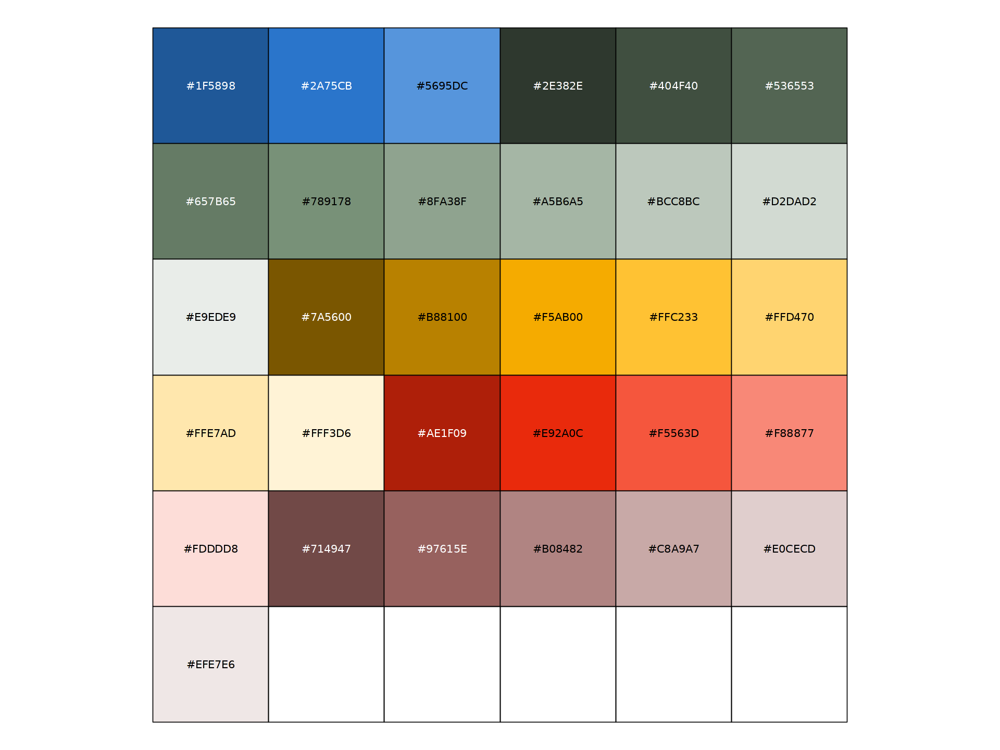

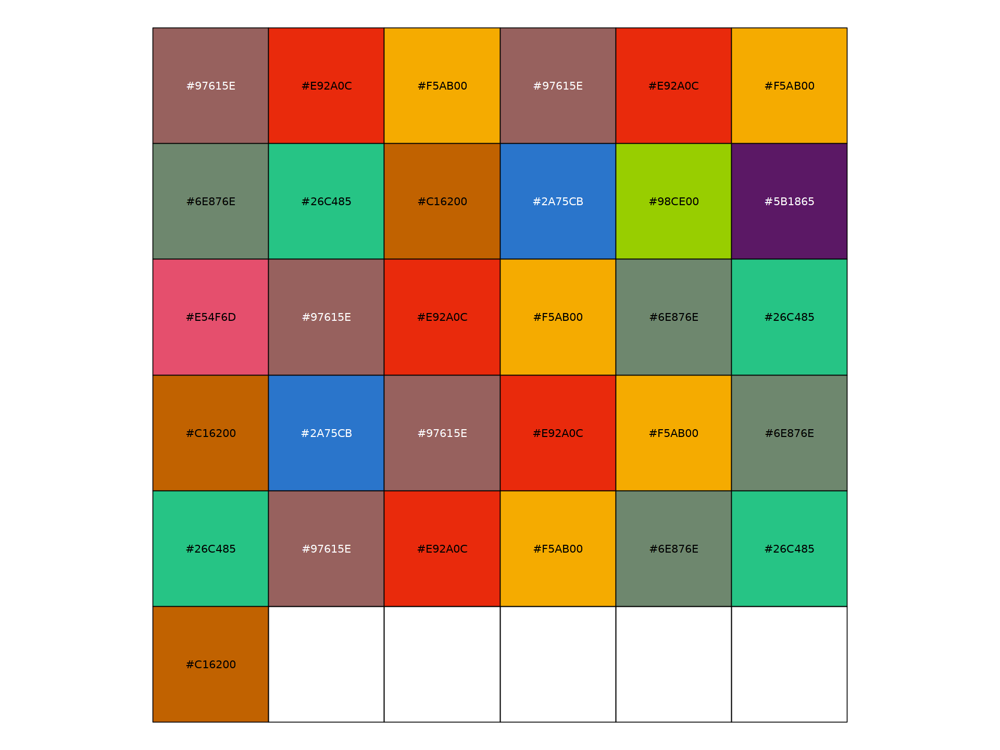

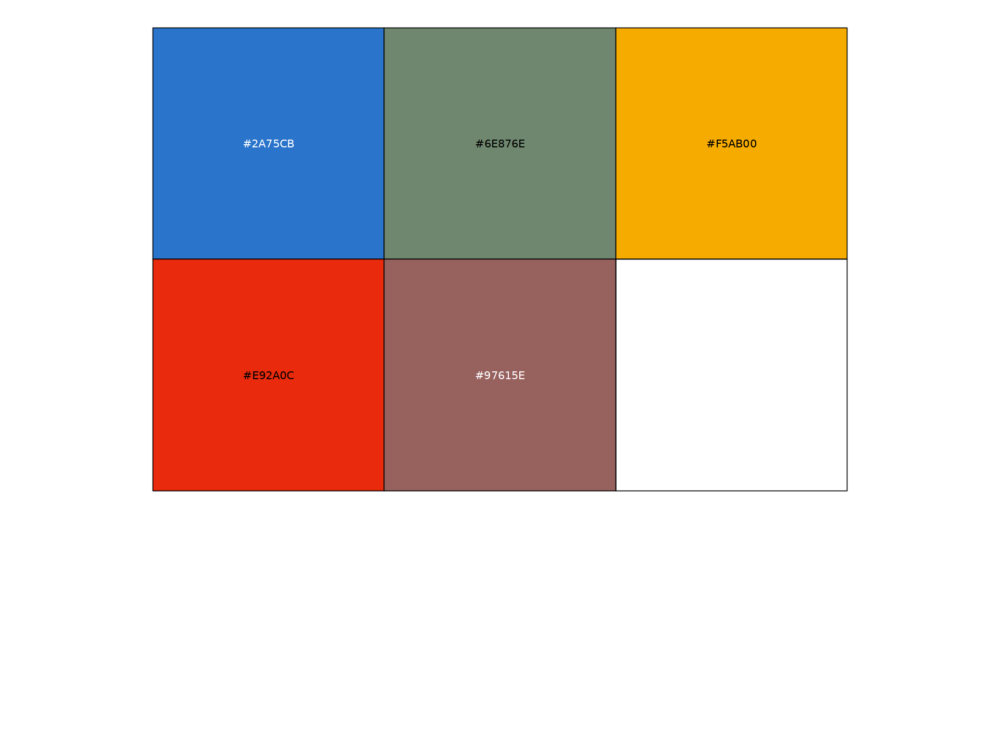

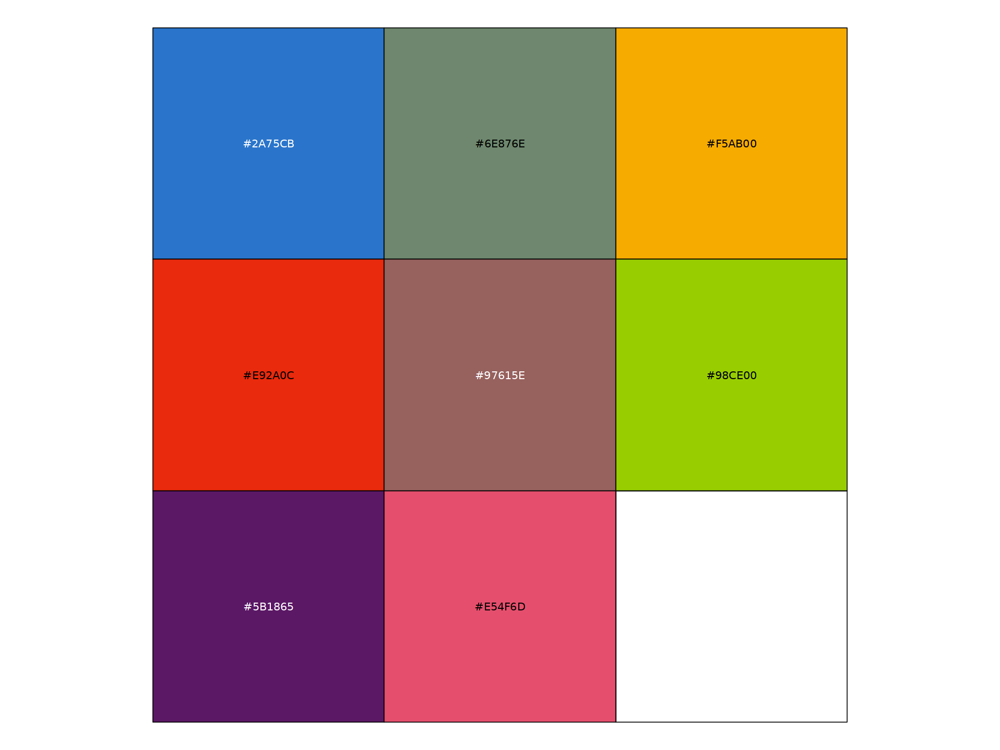

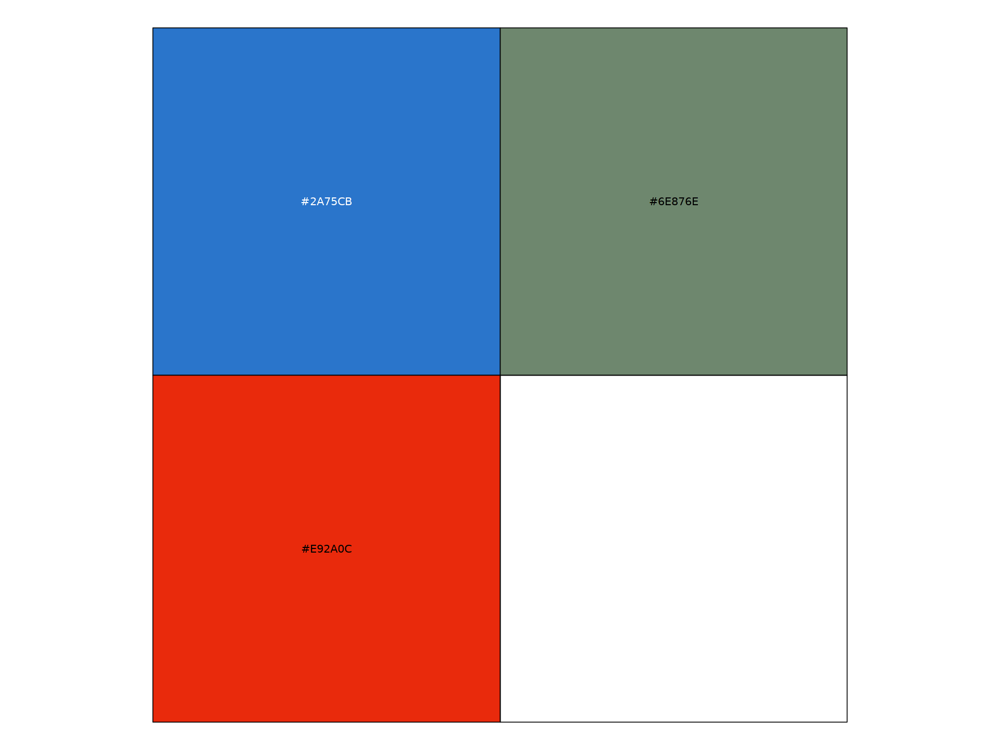

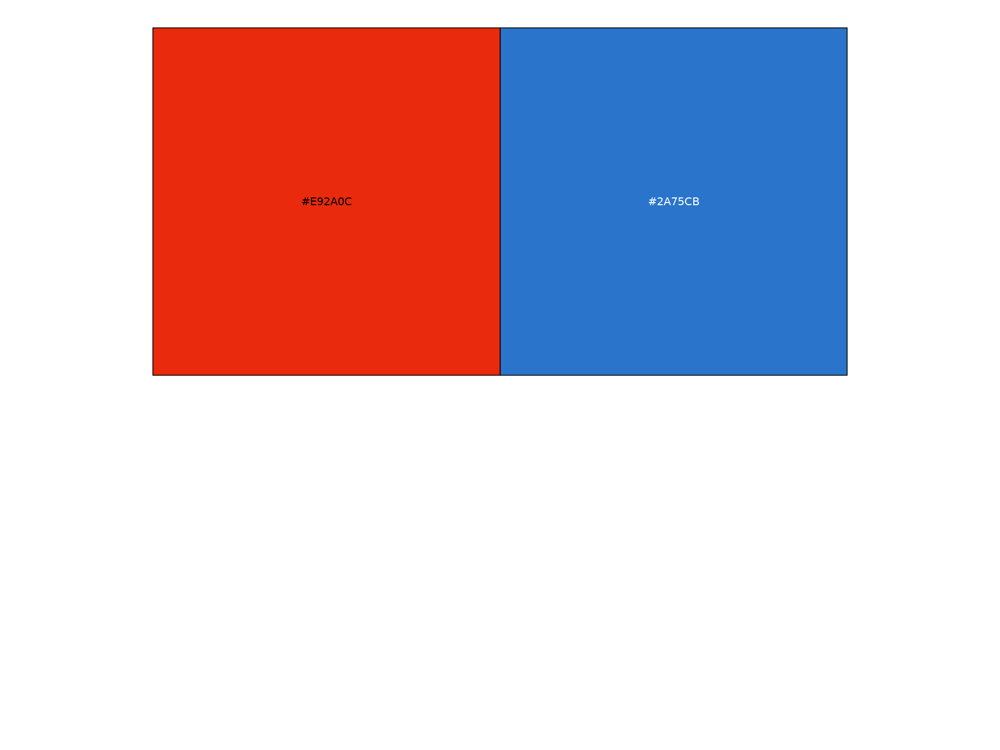

In [7]:
orig.ident_colors <- c("#1F5898", "#2A75CB", "#5695DC", 
                       "#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#BCC8BC", "#D2DAD2", "#E9EDE9", 
                       "#7A5600", "#B88100", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6",
                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8",
                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
names(orig.ident_colors) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl1", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
show_col(orig.ident_colors)
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#98CE00", "#5B1865", "#E54F6D",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
names(orig.ident_colors_contrast) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl1", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
show_col(orig.ident_colors_contrast)

#Colors after removing LateCtrl1
#orig.ident_colors <- c("#1F5898", "#2A75CB", "5695DC", 
#                       "#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#BCC8BC", "#D2DAD2", "#E9EDE9", 
#                       "#7A5600", "#B88100", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6"
#                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8"
#                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
#names(orig.ident_colors) <- c("Naive1", "Naive2", "Naive3", 
#                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
#                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
#                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
#                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
#show_col(orig.ident_colors)
#orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00",
#                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#5B1865", "#E54F6D",
#                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
#                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
#                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
#names(orig.ident_colors_contrast) <- c("Naive1", "Naive2", "Naive3", 
#                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
#                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
#                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
#                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
#show_col(orig.ident_colors_contrast)

orig.ident_merge_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Naive", "Ctrl", "Early", "Peak", "Late")
show_col(orig.ident_merge_colors)

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00", "#5B1865", "#E54F6D")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6", "B7", "B8")
show_col(batch_colors)

model_colors <- c("#2A75CB", "#6E876E", "#E92A0C")
names(model_colors) <- c("Naive", "Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#E92A0C", "#2A75CB")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("F", "M")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

immune_colors <- c("#A9DFBF", "#FF000080", "#954B37", "#3A3F55")
names(immune_colors) <- c("Basal", "Immune", "Damage", "Both")
#show_col(immune_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

debris_colors <- duo_colors
names(debris_colors) <- c("Percoll", "Debris")

date_tissue_coll_colors <- scales::viridis_pal()(18)
names(date_tissue_coll_colors) <- c('2021_04_30','2021_05_03','XX','2021_05_31','2021_09_30','2021_10_06','2021_11_26','2022_03_09','2022_03_10','2022_08_03','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2022_05_12','2022_05_16')
#show_col(date_tissue_coll_colors)

date_exp_colors <- scales::viridis_pal()(8)
names(date_exp_colors) <- c('2021_04_20','XX','2021_09_22','2021_11_17','2022_01_31','2022_07_18','2023_01_09','2023_06_05')
#show_col(date_exp_colors)

EAE_score_mean_colors <- scales::viridis_pal()(8)
names(EAE_score_mean_colors) <- c(0,0.5,2,2.25,2.33,2.5,3,NA)
#show_col(EAE_score_mean_colors)

In [13]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [9]:
aggr_table <- read.table(paste0(OS_path_datasets, "libraries_aggr_arc2_MORNAATACC_revision.csv"), header = TRUE, sep = ",")
aggr_table

library_id,atac_fragments,per_barcode_metrics,gex_molecule_info
<chr>,<chr>,<chr>,<chr>
Early1,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1003_EAE_ARC/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1003_EAE_ARC/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1003_EAE_ARC/outs/gex_molecule_info.h5
PeakCtrl2,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1004_EAE_ARC/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1004_EAE_ARC/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1004_EAE_ARC/outs/gex_molecule_info.h5
Peak2,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1005_EAE_ARC/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1005_EAE_ARC/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2/P21208_1005_EAE_ARC/outs/gex_molecule_info.h5
LateCtrl1,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1002/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1002/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1002/outs/gex_molecule_info.h5
Late1,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1003/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1003/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1003/outs/gex_molecule_info.h5
Early2,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1001/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1001/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1001/outs/gex_molecule_info.h5
EarlyCtrl2,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1002/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1002/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1002/outs/gex_molecule_info.h5
Peak3,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1003/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1003/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1003/outs/gex_molecule_info.h5
PeakCtrl3,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1004/outs/atac_fragments.tsv.gz,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1004/outs/per_barcode_metrics.csv,/datb/gcb/gcb_bh/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1004/outs/gex_molecule_info.h5


In [10]:
name_MORNAATACC <- seq_along(aggr_table$library_id)
names(name_MORNAATACC) <- aggr_table$library_id

In [11]:
MORNAATACC_sample_dir_name <- gsub("outs/atac_fragments.tsv.gz", "", aggr_table$atac_fragments)
MORNAATACC_sample_dir_name <- gsub("/dat.*Alignment/", OS_path_datasets, MORNAATACC_sample_dir_name)
names(MORNAATACC_sample_dir_name) <- aggr_table$library_id

### 2.1 Remove ambiant RNA with Cellbender

In [12]:
MORNAATACC_sample_dir_name_bash <- unname(MORNAATACC_sample_dir_name)

In [262]:
%put OS_path_datasets OS_path_outputs OS_path_inputs MORNAATACC_sample_dir_name

In [263]:
%get MORNAATACC_sample_dir_name_bash --from R\ 4.3.2
%preview -n MORNAATACC_sample_dir_name_bash

>>> MORNAATACC_sample_dir_name_bash:

['/sing_data/Data/MORNAATACC/Alignment/ARC2/P21208_1003_EAE_ARC/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2/P21208_1004_EAE_ARC/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2/P21208_1005_EAE_ARC/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1002/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_late/MORNAATACC_1003/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1001/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1002/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1003/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Dec2021/P23605_1004/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Jan2022/P24115_1001/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Jan2022/P24115_1002/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_Jan2022/P24115_1003/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_April2022/P25316_1001/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_April2022/P25316_1002/',
 '/sing_data/Data/MORNAATACC/Alignment/ARC2_April2022/P2

I haven't run this in the singularity environment. Cellbender requires specifically Python3.7 and Pytorch 1.13.1. Python3.7 is depreciated so I ran it externaly.

In [ ]:
%get MORNAATACC_sample_dir_name_bash
for sample in $MORNAATACC_sample_dir_name_bash;
do
mkdir -p $sample/cellbender
cd $sample/cellbender
cellbender remove-background --input $sample/outs/filtered_feature_bc_matrix.h5 --output $sample/cellbender/filtered_feature_bc_matrix.h5
done

### 2.2 Load datasets

#### 2.2.2 Load gene expression

##### 2.2.2.1 Load raw expression

In [13]:
data_MORNAATACC <- Read10X(paste0(OS_path_datasets, "AGGR_ARC2_MORNAATACC/outs/filtered_feature_bc_matrix/"))
MORNAATACC <- CreateSeuratObject(data_MORNAATACC$`Gene Expression`, assay = "RAW")

10X data contains more than one type and is being returned as a list containing matrices of each type.



In [14]:
MORNAATACC$orig.ident <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(name_MORNAATACC[name_MORNAATACC == x[2]])))

In [15]:
MORNAATACC$orig.ident <- factor(x = MORNAATACC$orig.ident, levels = names(orig.ident_colors))

In [16]:
table(MORNAATACC$orig.ident)


          Naive1           Naive2           Naive3       EarlyCtrl2 
            6937             8166             7043              564 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
            5514             7837             9124             9603 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
            3746             2463             2817             9352 
       LateCtrl3           Early1           Early2     EarlyFemale3 
            8403             4641             1323             3771 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
            4185             5347            11937            12832 
           Peak2            Peak3        PeakMale4      PeakFemale4 
            2023             5017             4033             5471 
           Peak5            Late1            Late2            Late3 
            4646             4957             1887             4749 
       LateMale4      LateFemale4

In [17]:
MORNAATACC

An object of class Seurat 
32285 features across 182647 samples within 1 assay 
Active assay: RAW (32285 features, 0 variable features)
 1 layer present: counts

##### 2.2.2.2 Load cellbender ambiant RNA mitigated expression

###### 2.2.2.2.1 Load h5 files

In [18]:
#Rename cells with suffix
cellbender_outs <- list()
for (sample_name in names(MORNAATACC_sample_dir_name)) {
    sample_path <-  MORNAATACC_sample_dir_name[names(MORNAATACC_sample_dir_name) == sample_name]
    cellbender_outs[[sample_name]] <- Read_CellBender_h5_Mat(file_name = paste0(sample_path, "cellbender/", basename(sample_path), "_cellbender_raw_feature_bc_matrix_filtered.h5"))
    colnames(cellbender_outs[[sample_name]]) <- unlist(lapply(strsplit(colnames(cellbender_outs[[sample_name]]),"-"), function(x){paste0(x[1],"-",name_MORNAATACC[names(name_MORNAATACC)==sample_name])}))   
    #Only keep the genes
    genes_only <- rownames(cellbender_outs[[sample_name]])[substring(rownames(cellbender_outs[[sample_name]]), 0,3) != "chr"]
    cellbender_outs[[sample_name]] <- cellbender_outs[[sample_name]][genes_only,]
}

###### 2.2.2.2.2 Keep shared genes

In [19]:
genes_names_list <- lapply(cellbender_outs, function(x){rownames(x)})

In [20]:
genes_names <- unlist(genes_names_list)
genes_names <- unlist(table(genes_names))
genes_names <- names(genes_names[genes_names == max(genes_names)])

In [21]:
cellbender_outs <- lapply(cellbender_outs, function(x){x[genes_names,]})

###### 2.2.2.2.3 Create Seurat object

In [22]:
MORNAATACC_cellbender <- CreateSeuratObject(do.call(cbind, cellbender_outs), min.features = 0)

In [23]:
MORNAATACC_cellbender$orig.ident <- unlist(lapply(strsplit(rownames(MORNAATACC_cellbender@meta.data),"-"), function(x) names(name_MORNAATACC[name_MORNAATACC == x[2]])))

In [24]:
MORNAATACC_cellbender$orig.ident <- factor(x = MORNAATACC_cellbender$orig.ident, levels = names(orig.ident_colors))

In [25]:
table(MORNAATACC_cellbender$orig.ident)


          Naive1           Naive2           Naive3       EarlyCtrl2 
            7796             9131             7801             6619 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
           12472             8571            10239            10418 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
            3762             2560             2902            10303 
       LateCtrl3           Early1           Early2     EarlyFemale3 
            9117             4798             1397             4017 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
            4465            13788            12917            15758 
           Peak2            Peak3        PeakMale4      PeakFemale4 
            2103             5283            48754             5891 
           Peak5            Late1            Late2            Late3 
            5387             5142             2007             5027 
       LateMale4      LateFemale4

In [26]:
MORNAATACC_cellbender

An object of class Seurat 
32285 features across 306121 samples within 1 assay 
Active assay: RNA (32285 features, 0 variable features)
 1 layer present: counts

In [27]:
cellbender_outs <- NULL

###### 2.2.2.2.4 Check cellbender cell calling quality

In [28]:
commun_cells <- intersect(colnames(MORNAATACC[['RAW']]$counts), colnames(MORNAATACC_cellbender[['RNA']]$counts))

In [29]:
#Cellranger cell calling
table(colnames(MORNAATACC[['RAW']]$counts) %in% commun_cells)
#Cellbender cell calling
table(colnames(MORNAATACC_cellbender[['RNA']]$counts) %in% commun_cells)


 FALSE   TRUE 
   973 181674 


 FALSE   TRUE 
124447 181674 

In [30]:
cellranger_spe_cells <- colnames(MORNAATACC[['RAW']]$counts) [!colnames(MORNAATACC[['RAW']]$counts) %in% commun_cells]
cellbender_spe_cells <- colnames(MORNAATACC_cellbender[['RNA']]$counts) [!colnames(MORNAATACC_cellbender[['RNA']]$counts) %in% commun_cells]

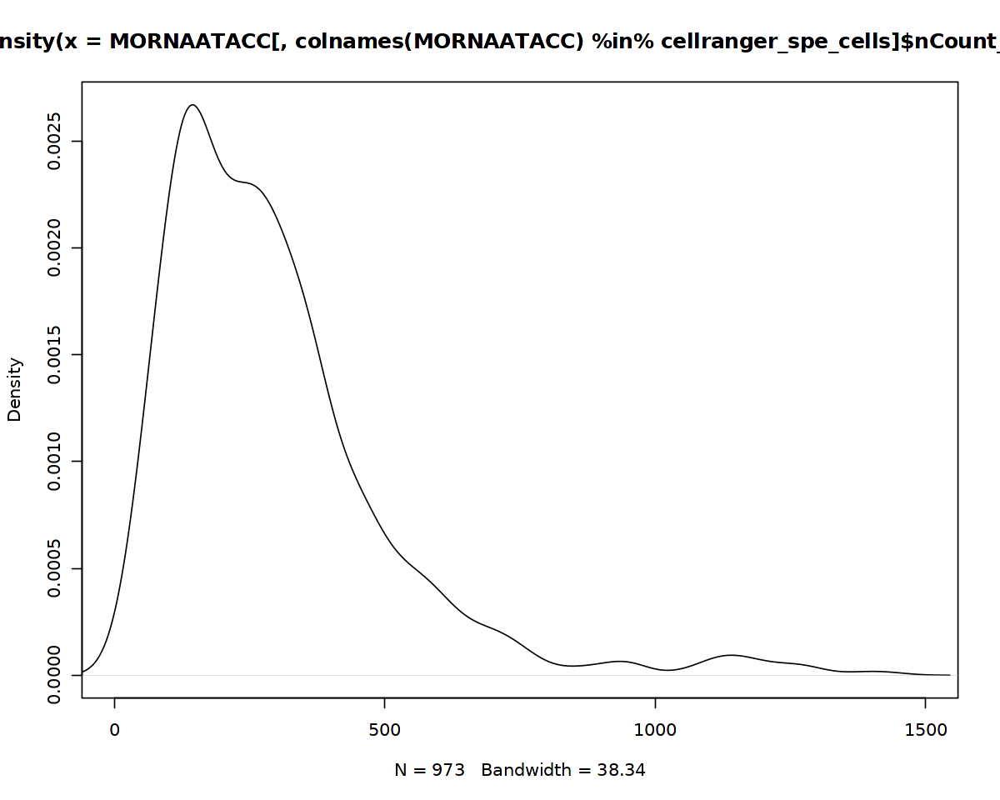

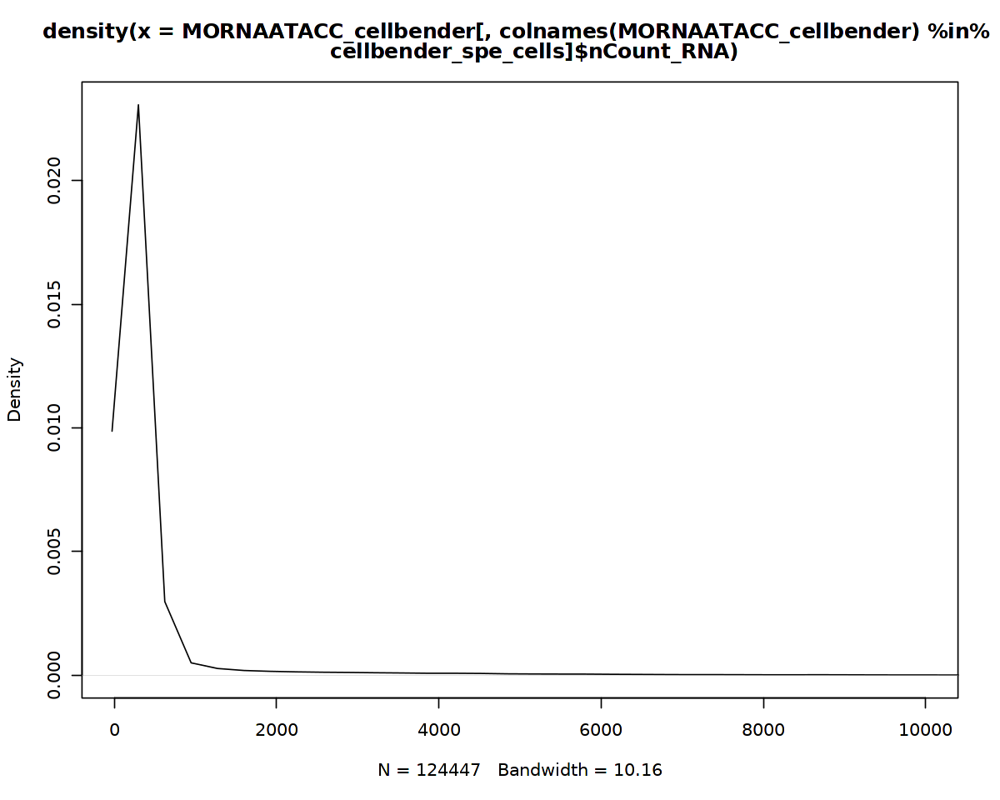

In [31]:
options(repr.plot.width=10, repr.plot.height=8)
plot(density(MORNAATACC[,colnames(MORNAATACC) %in% cellranger_spe_cells]$nCount_RAW),xlim = c(0, 1500))
plot(density(MORNAATACC_cellbender[,colnames(MORNAATACC_cellbender) %in% cellbender_spe_cells]$nCount_RNA),xlim = c(0, 10000))

In [32]:
#Cellranger specific cells
table(MORNAATACC[,colnames(MORNAATACC) %in% cellranger_spe_cells]$orig.ident)
#Cellbender specific cells
table(MORNAATACC_cellbender[,colnames(MORNAATACC_cellbender) %in% cellbender_spe_cells]$orig.ident)


          Naive1           Naive2           Naive3       EarlyCtrl2 
              36               43               32                0 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
               5                9               56               48 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
             147                4                4               44 
       LateCtrl3           Early1           Early2     EarlyFemale3 
              18               29               15               18 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
              19                3              102               49 
           Peak2            Peak3        PeakMale4      PeakFemale4 
              54               59                0               31 
           Peak5            Late1            Late2            Late3 
              29               13                7               22 
       LateMale4      LateFemale4


          Naive1           Naive2           Naive3       EarlyCtrl2 
             895             1008              790             6055 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
            6963              743             1171              863 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
             163              101               89              995 
       LateCtrl3           Early1           Early2     EarlyFemale3 
             732              186               89              264 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
             299             8444             1082             2975 
           Peak2            Peak3        PeakMale4      PeakFemale4 
             134              325            44721              451 
           Peak5            Late1            Late2            Late3 
             770              198              127              300 
       LateMale4      LateFemale4

###### 2.2.2.2.5 Create a Seurat object with commun cells and genes calls

In [33]:
commun_genes <- intersect(rownames(MORNAATACC_cellbender[['RNA']]$counts), rownames(MORNAATACC[['RAW']]$counts))

In [34]:
length(commun_genes)

[1] 32285

In [35]:
MORNAATACC <- MORNAATACC[,colnames(MORNAATACC) %in% commun_cells]

In [36]:
MORNAATACC <- MORNAATACC[rownames(MORNAATACC) %in% commun_genes,]

In [37]:
MORNAATACC

An object of class Seurat 
32285 features across 181674 samples within 1 assay 
Active assay: RAW (32285 features, 0 variable features)
 1 layer present: counts

In [38]:
MORNAATACC[["RNA"]] <- CreateAssayObject(counts = MORNAATACC_cellbender[['RNA']]$counts[commun_genes,commun_cells])

In [39]:
MORNAATACC[["RNA"]]$counts <- MORNAATACC[["RNA"]]$counts[rownames(MORNAATACC[["RAW"]]$counts),]

In [40]:
MORNAATACC

An object of class Seurat 
64570 features across 181674 samples within 2 assays 
Active assay: RAW (32285 features, 0 variable features)
 1 layer present: counts
 1 other assay present: RNA

##### 2.2.2.3 Overview of cellbender mitigation

In [58]:
features_diff_list <- list()
for (sample in names(orig.ident_colors)) {
    tmp_seurat <- subset(MORNAATACC, subset = orig.ident == sample)
    features_diff_list[[sample]] <- CellBender_Feature_Diff(seurat_object = tmp_seurat, raw_assay = "RAW", cell_bender_assay = "RNA")
}

In [59]:
for (sample in names(orig.ident_colors)) {
    features_diff_list[[sample]][,"Log2_Raw_Counts"] <- log2(features_diff_list[[sample]][,"Raw_Counts"]+1)
    features_diff_list[[sample]][,"Log2_CellBender_Counts"] <- log2(features_diff_list[[sample]][,"CellBender_Counts"]+1)
    features_diff_list[[sample]][,"Log2FC"] <- features_diff_list[[sample]][,"Log2_Raw_Counts"]-features_diff_list[[sample]][,"Log2_CellBender_Counts"]
    features_diff_list[[sample]][,"Markers"] <- rownames(features_diff_list[[sample]])
}

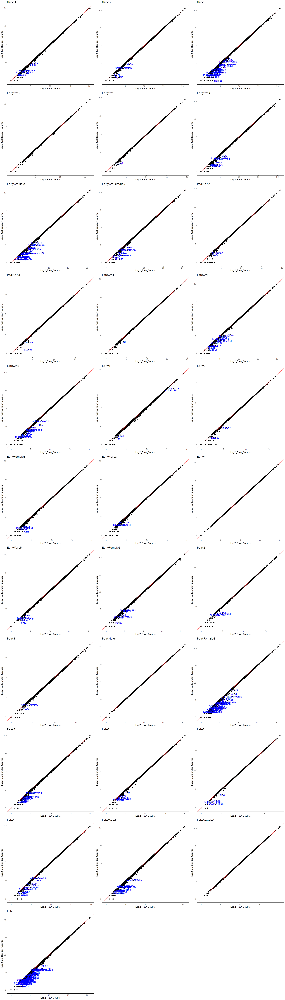

In [67]:
options(repr.plot.width=20, repr.plot.height=70)
gg <- list()
for (i in 1:length(orig.ident_colors)){
    gg[[i]] <- ggplot(features_diff_list[[names(orig.ident_colors)[i]]], aes(x=Log2_Raw_Counts, y=Log2_CellBender_Counts)) +
      geom_point() +
      geom_abline(linetype=3, color='red') +
      geom_text(aes(label=ifelse(Log2FC>1 & (Log2_Raw_Counts+Log2_CellBender_Counts)/2>2,as.character(Markers),'')), color='blue') +
      ggtitle(names(orig.ident_colors)[i]) +
      theme_bw() + theme(panel.border = element_blank(), panel.grid.major = element_blank(), panel.grid.minor = element_blank(), axis.line = element_line(colour = "black"))
}
do.call(grid.arrange, c(gg, nrow = 11))

In [63]:
all_genes <- rownames(MORNAATACC[["RAW"]]$counts)

In [64]:
df_cellbender_diff <- matrix(0L, ncol=length(orig.ident_colors), nrow=length(all_genes), dimnames=list(all_genes,names(orig.ident_colors)))
df_cellbender_size <- matrix(0L, ncol=length(orig.ident_colors), nrow=length(all_genes), dimnames=list(all_genes,names(orig.ident_colors)))

In [65]:
for (sample in names(orig.ident_colors)){
    df_cellbender_diff[,sample] <- features_diff_list[[sample]][all_genes,"Log2FC"]
    df_cellbender_size[,sample] <- (features_diff_list[[sample]][all_genes,"Log2_Raw_Counts"]+features_diff_list[[sample]][all_genes,"Log2_CellBender_Counts"])/2
}

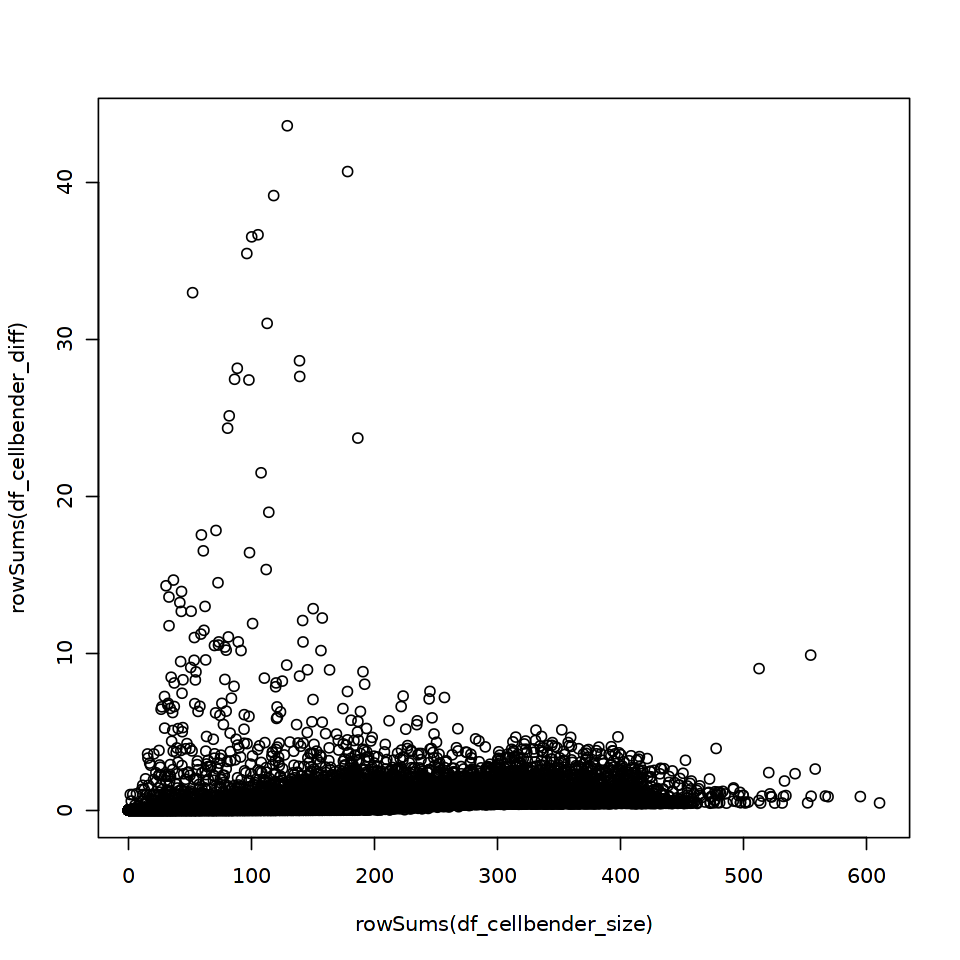

In [68]:
options(repr.plot.width=8, repr.plot.height=8)
plot(rowSums(df_cellbender_size), rowSums(df_cellbender_diff))

In [97]:
#Select all gene with Log2FC>1 and combine (Log2Counts(Raw)+Log2Counts(Mitigated))/2>2
#Correspond to blue genes above
best_genes <- c()
for (sample in names(features_diff_list)){
    tmp <- features_diff_list[[sample]][features_diff_list[[sample]]$Log2FC>1 & (features_diff_list[[sample]]$Log2_Raw_Counts+features_diff_list[[sample]]$Log2_CellBender_Counts)/2>2,]$Markers
    best_genes <- c(best_genes, tmp)
}
best_genes <- unique(best_genes)

In [99]:
length(best_genes)

[1] 120

In [ ]:
saveRDS(best_genes, paste0(OS_path_outputs, "mitigated_genes.rds"))

In [100]:
df_diff <- df_cellbender_diff[best_genes,]
df_diff_tidy <- gather(as.data.frame(df_diff), key="Sample", value="Ratio")
df_size <- df_cellbender_size[best_genes,]
df_size_tidy <- gather(as.data.frame(df_size), key="Sample", value="Size")

tibble_display <- as_tibble(df_diff_tidy)
tibble_display <- cbind(tibble_display, as_tibble(df_size_tidy)$Size)
colnames(tibble_display)[ncol(tibble_display)] <- "Size"

markers <- rep(rownames(df_diff), length(colnames(df_diff)))
tibble_display <- cbind(tibble_display,markers)
colnames(tibble_display)[ncol(tibble_display)] <- "Markers"

In [101]:
clust <- hclust(dist(df_cellbender_diff[best_genes,] %>% as.matrix()))
ddgram <- as.dendrogram(clust) # create dendrogram
ggtree_plot <- ggtree::ggtree(ddgram)

v_clust <- hclust(dist(df_cellbender_diff[best_genes,] %>% as.matrix() %>% t())) # hclust with distance matrix
ddgram_col <- as.dendrogram(v_clust)
ggtree_plot_col <- ggtree(ddgram_col) + layout_dendrogram()

In [102]:
dotplot <- tibble_display %>%
  filter(Ratio > 0, Size > 0) %>%
  mutate(Markers = factor(Markers, levels = clust$labels[clust$order])) %>% 
  ggplot(aes(x=Sample, y = Markers, color = Ratio, size = Size)) +
  geom_point() +
  cowplot::theme_cowplot() +
  theme(axis.line  = element_blank()) +
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  ylab('') +
  theme(axis.ticks = element_blank()) +
  scale_color_gradientn(colours = viridis::viridis(20), limits=c(0,3), oob = scales::squish, name = 'Log2 Ratio') +
  scale_y_discrete(position = "right") 

  ggtree_plot_col <- ggtree_plot_col + xlim2(dotplot)

  ggtree_plot <- ggtree_plot + ylim2(dotplot)

  labels <- ggplot(
    tibble_display %>%
    mutate(
      Sample = factor(Sample, levels = names(orig.ident_colors))
    ),
    aes(x = Sample, y = 1, fill = Sample)
  ) +
  geom_tile() +
  scale_fill_manual(values = orig.ident_colors) +
  theme(legend.position = "none") +
  theme(
    axis.title.x=element_blank(),
    axis.text.x=element_blank(),
    axis.ticks.x=element_blank(),
    axis.title.y=element_blank(),
    axis.text.y=element_blank(),
    axis.ticks.y=element_blank()
  ) +
  xlim2(dotplot)
  legend <- plot_grid(get_legend(labels + theme(legend.position="bottom")))

the plot was flipped and the x limits will be applied to y-axis

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Scale for y is already present.
Adding another scale for y, which will replace the existing scale.
Warning message in get_plot_component(plot, "guide-box"):
"Multiple components found; returning the first one. To return all, use `return_all = TRUE`."


In [103]:
#Gm42418','AY036118'

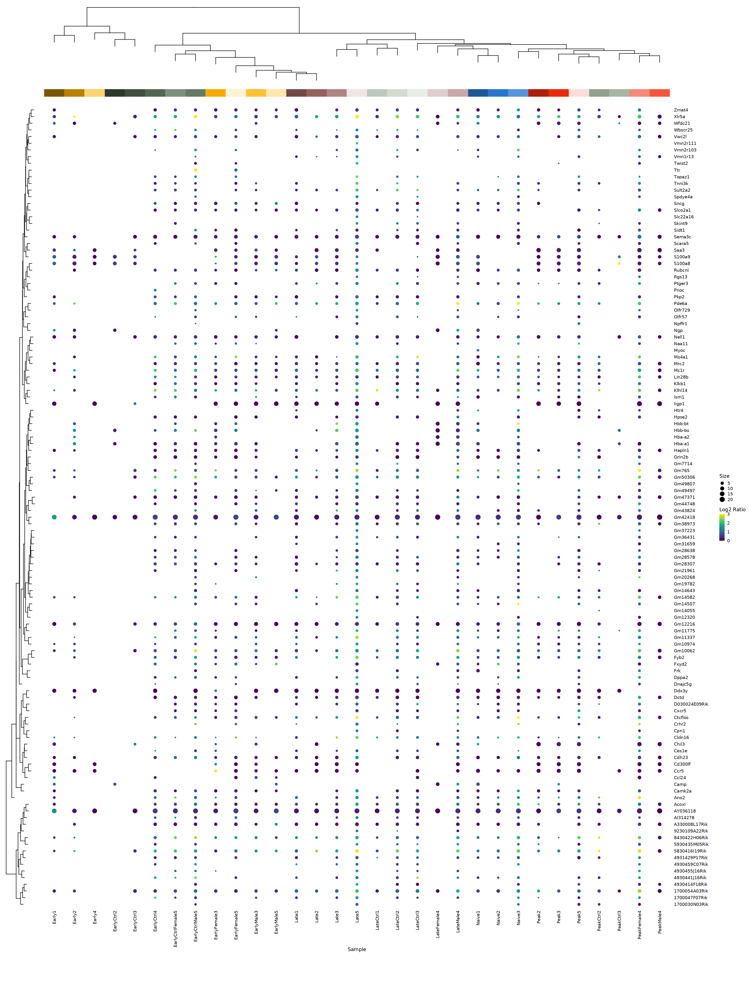

In [104]:
options(repr.plot.width=30, repr.plot.height=40)
print(
plot_spacer() + plot_spacer() + ggtree_plot_col +
plot_spacer() + plot_spacer() + labels +
plot_spacer() + plot_spacer() + plot_spacer() +
ggtree_plot + plot_spacer() + dotplot +
plot_spacer() + plot_spacer() + legend +
plot_layout(ncol = 3, widths = c(0.5, -0.05, 10), heights = c(1, 0.1, 0, 10, 0.5))
)

#### 2.2.3 Load chromatin accessibility

In [41]:
length(commun_cells)

[1] 181674

In [42]:
MORNAATACC[["ATAC"]] <- CreateChromatinAssay(counts = data_MORNAATACC$Peaks[,commun_cells], sep = c(":", "-"), fragments = paste0(OS_path_datasets, "AGGR_ARC2_MORNAATACC/outs/atac_fragments.tsv.gz"), annotation = annotations)

Computing hash

Checking for 181674 cell barcodes


In [ ]:
MORNAATACC[["ATAC"]] <- annotation

In [43]:
MORNAATACC

An object of class Seurat 
236868 features across 181674 samples within 3 assays 
Active assay: RAW (32285 features, 0 variable features)
 1 layer present: counts
 2 other assays present: RNA, ATAC

### 2.3 Add origin of cell identity

In [44]:
name_merge <- c()
for(i in seq_along(names(MORNAATACC_sample_dir_name))){
    if(names(MORNAATACC_sample_dir_name)[i] %like% "Ctrl"){
        name_merge <- c(name_merge, "Ctrl")
    }else if(names(MORNAATACC_sample_dir_name)[i] %like% "Early"){
        name_merge <- c(name_merge, "Early")
    }else if(names(MORNAATACC_sample_dir_name)[i] %like% "Peak"){
        name_merge <- c(name_merge, "Peak")
    }else if(names(MORNAATACC_sample_dir_name)[i] %like% "Late"){
        name_merge <- c(name_merge, "Late")
    }else if(names(MORNAATACC_sample_dir_name)[i] %like% "Naive"){
        name_merge <- c(name_merge, "Naive")
    }else{print("Error")}
}

In [45]:
name_merge_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(name_merge_MORNAATACC) <- name_merge

In [46]:
MORNAATACC$orig.ident_merge <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(name_merge_MORNAATACC[name_merge_MORNAATACC == x[2]])))

In [47]:
MORNAATACC$orig.ident_merge <- factor(x = MORNAATACC$orig.ident_merge, levels = names(orig.ident_merge_colors))

In [48]:
batch <- c()
for(i in seq_along(names(MORNAATACC_sample_dir_name))){
    if(basename(MORNAATACC_sample_dir_name[i]) %like% "P21208"){
        batch <- c(batch, "B1")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "MORNAATACC_100"){
        batch <- c(batch, "B2")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "P23605"){
        batch <- c(batch, "B3")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "P24115"){
        batch <- c(batch, "B4")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "P25316"){
        batch <- c(batch, "B5")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "P27208"){
        batch <- c(batch, "B6")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "P26203"){
        batch <- c(batch, "B7")
    }else if(basename(MORNAATACC_sample_dir_name[i]) %like% "P29557"){
        batch <- c(batch, "B8")
    }else{print(paste0("Error : ",basename(MORNAATACC_sample_dir_name[i])))}
}

In [49]:
batch_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(batch_MORNAATACC) <- batch

In [50]:
MORNAATACC$batch <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(batch_MORNAATACC[batch_MORNAATACC == x[2]])))

In [51]:
MORNAATACC$batch <- factor(x = MORNAATACC$batch, levels = names(batch_colors))

In [52]:
model <- c()
for(i in seq_along(name_merge)){
    if(name_merge[i] == "Ctrl"){
        model <- c(model, "Ctrl")
    }else if(name_merge[i] == "Naive"){
        model <- c(model, "Naive")
    }else if(name_merge[i] %in% c("Early", "Peak", "Late")){
        model <- c(model, "EAE")
    }else{print("Error")}
}

In [53]:
model_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(model_MORNAATACC) <- model

In [54]:
MORNAATACC$model <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(model_MORNAATACC[model_MORNAATACC == x[2]])))

In [55]:
MORNAATACC$model <- factor(x = MORNAATACC$model, levels = names(model_colors))

In [56]:
debris_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(debris_MORNAATACC) <- c("Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Percoll", "Debris", "Debris", "Debris", "Debris", "Debris", "Debris","Debris", "Debris", "Debris", "Debris", "Debris","Debris", "Debris", "Debris", "Debris")

In [57]:
MORNAATACC$debrisRemoval <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(debris_MORNAATACC[debris_MORNAATACC == x[2]])))

In [58]:
MORNAATACC$debrisRemoval <- factor(x = MORNAATACC$debrisRemoval, levels = names(debris_colors))

In [59]:
date_tissue_coll_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(date_tissue_coll_MORNAATACC) <- c('2021_04_30','2021_05_03','2021_05_03','XX','2021_05_31','2021_09_30','2021_09_30','2021_10_06','2021_10_06','2021_11_26','2021_11_26','2021_11_26','2022_03_09','2022_03_09','2022_03_10','2022_03_10','2022_08_03','2022_08_03','2022_08_24','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2023_06_14','2023_06_15','2023_06_14','2023_06_15','2022_05_12','2022_05_16')

In [60]:
MORNAATACC$date_tissue_collection <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(date_tissue_coll_MORNAATACC[date_tissue_coll_MORNAATACC == x[2]])))

In [61]:
MORNAATACC$date_tissue_collection <- factor(x = MORNAATACC$date_tissue_collection, levels = names(date_tissue_coll_colors))

In [62]:
date_exp_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(date_exp_MORNAATACC) <- c('2021_04_20','2021_04_20','2021_04_20','XX','2021_04_20','2021_09_22','2021_09_22','2021_09_22','2021_09_22','2021_11_17','2021_11_17','2021_11_17','2022_01_31','2022_01_31','2022_01_31','2022_01_31','2022_07_18','2022_07_18','2022_07_18','2022_07_18','2023_01_09','2023_01_09','XX','2023_06_05','2023_06_05','2023_06_05','2023_06_05','2023_06_05','2023_06_05','XX','XX')

In [63]:
MORNAATACC$date_experiment <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(date_exp_MORNAATACC[date_exp_MORNAATACC == x[2]])))

In [64]:
MORNAATACC$date_experiment <- factor(x = MORNAATACC$date_experiment, levels = names(date_exp_colors))

In [65]:
nbMouse_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(nbMouse_MORNAATACC) <- c(2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,3,3,2,2,2,2,2,2,2,2,2,2,2)

In [66]:
MORNAATACC$nbMouse <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(nbMouse_MORNAATACC[nbMouse_MORNAATACC == x[2]])))

In [67]:
EAE_score_mean_MORNAATACC <- seq_along(names(MORNAATACC_sample_dir_name))
names(EAE_score_mean_MORNAATACC) <- c(0.5,0,3,NA,2.25,0,0,3,0,0,0.5,0.5,2.5,0,2,0,3,3,2.33,2.33,3,2,0,0,0,0,0.5,0.5,0.5,0,0)

In [68]:
MORNAATACC$EAE_score_mean <- unlist(lapply(strsplit(rownames(MORNAATACC@meta.data),"-"), function(x) names(EAE_score_mean_MORNAATACC[EAE_score_mean_MORNAATACC == x[2]])))

In [69]:
MORNAATACC$EAE_score_mean <- factor(x = MORNAATACC$EAE_score_mean, levels = names(EAE_score_mean_colors))

### 2.4 Check number of fragments in peaks sample by sample

In [70]:
# Check number of fragments in peak
total_fragments <- list()
for (sample_name in names(MORNAATACC_sample_dir_name)) {
    sample_path <-  MORNAATACC_sample_dir_name[names(MORNAATACC_sample_dir_name) == sample_name]
    total_fragments[[sample_name]] <- CountFragments(paste0(sample_path,"/outs/atac_fragments.tsv.gz"))
}

Done Processing 89 million lines                  

In [71]:
for (i in seq_along(names(MORNAATACC_sample_dir_name))) {
    total_fragments[[i]]$CB <- paste0(substr(total_fragments[[i]]$CB,1,nchar(total_fragments[[i]]$CB)-2),"-",i)
}

In [72]:
total_fragments_MORNAATACC <- do.call(rbind,total_fragments)

In [73]:
rownames(total_fragments_MORNAATACC) <- total_fragments_MORNAATACC$CB

In [74]:
MORNAATACC@meta.data[c("frequency_count", "mononucleosomal", "nucleosome_free", "reads_count")] <- total_fragments_MORNAATACC[colnames(MORNAATACC[["ATAC"]]), c("frequency_count", "mononucleosomal", "nucleosome_free", "reads_count")]

[Save](#X.1-Savings)

## 3. Remove bad cells based on QC metrics

### 3.1 QC calculation

In [75]:
DefaultAssay(MORNAATACC) <- "RNA"

In [76]:
#Add percentage of mt in each cell
MORNAATACC$percent.mt <- PercentageFeatureSet(MORNAATACC, pattern = "^mt-")

In [77]:
MORNAATACC$log10GenesUMI <- log10(MORNAATACC$nFeature_RNA) / log10(MORNAATACC$nCount_RNA)

In [78]:
MORNAATACC$mitoRatio <- MORNAATACC@meta.data$percent.mt / 100

In [79]:
Sgenes <- paste(toupper(substr(tolower(cc.genes$s.genes), 1, 1)), substr(tolower(cc.genes$s.genes), 2, nchar(tolower(cc.genes$s.genes))), sep="")
G2Mgenes <- paste(toupper(substr(tolower(cc.genes$g2m.genes), 1, 1)), substr(tolower(cc.genes$g2m.genes), 2, nchar(tolower(cc.genes$g2m.genes))), sep="")

In [80]:
MORNAATACC <- CellCycleScoring(MORNAATACC, s.features = Sgenes, g2m.features = G2Mgenes, set.ident = TRUE)
MORNAATACC$CC.Difference <- MORNAATACC$S.Score - MORNAATACC$G2M.Score

Warning message:
"The following features are not present in the object: Mlf1ip, not searching for symbol synonyms"
Warning message:
"The following features are not present in the object: Fam64a, Hn1, not searching for symbol synonyms"


In [81]:
DefaultAssay(MORNAATACC) <- "ATAC"

In [82]:
#Add nucleosome signal and TSS enrichment metrics to each cell
MORNAATACC <- NucleosomeSignal(MORNAATACC)
MORNAATACC <- TSSEnrichment(MORNAATACC)

Found 181674 cell barcodes
Done Processing 908 million lines                 Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score



[Save](#X.1-Savings)

### 3.2 QC visualization

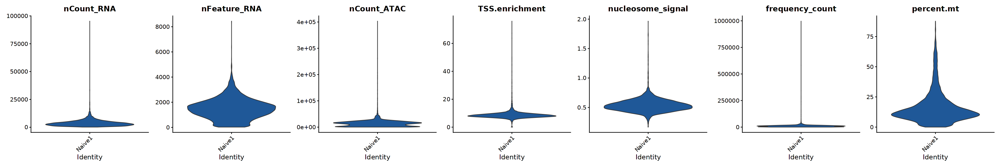

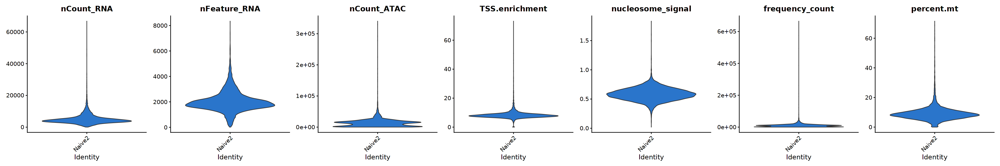

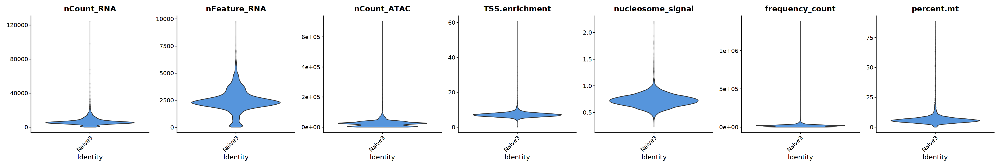

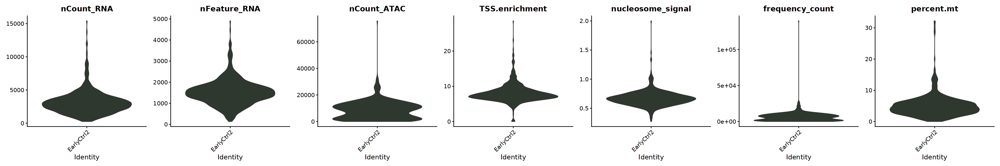

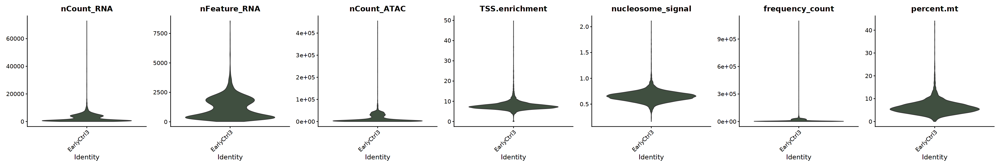

...

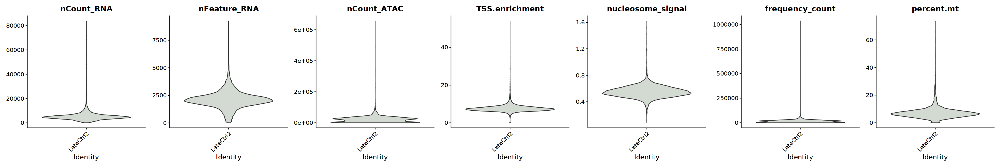

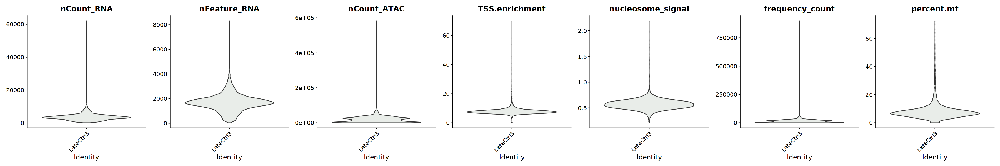

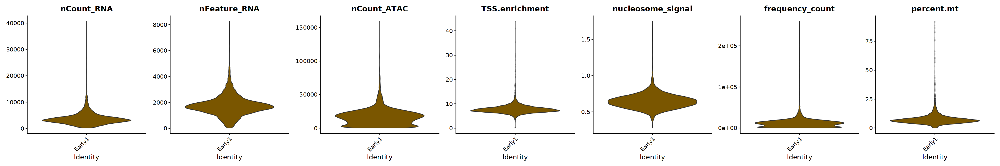

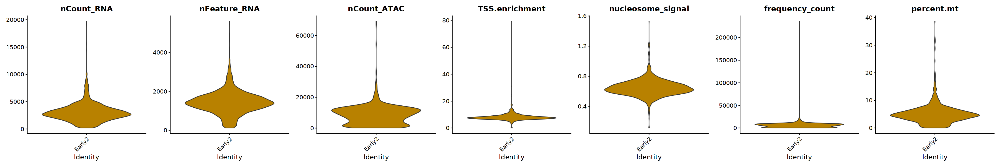

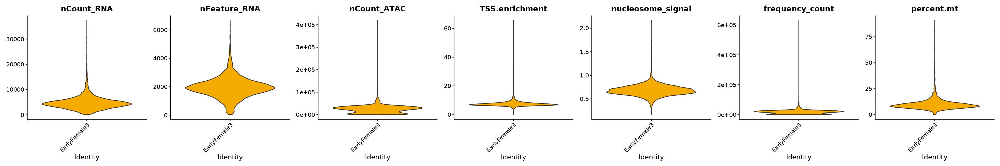

Warning message:
"Removed 6 rows containing non-finite outside the scale range
(`stat_ydensity()`)."


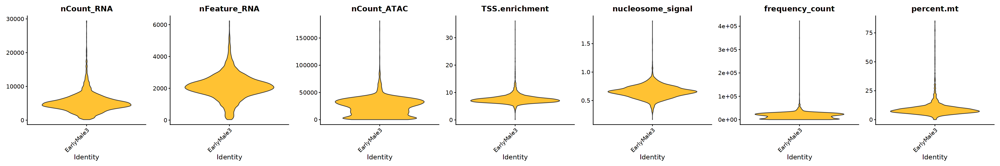

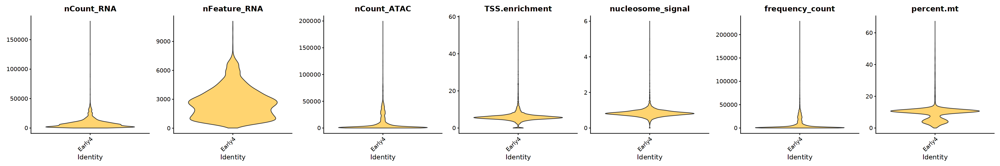

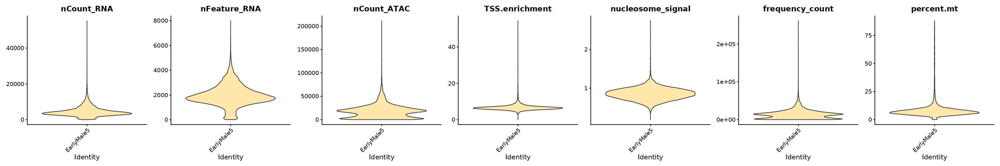

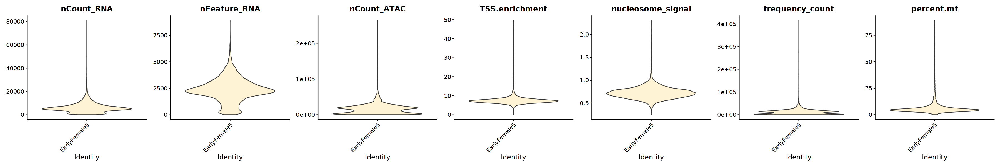

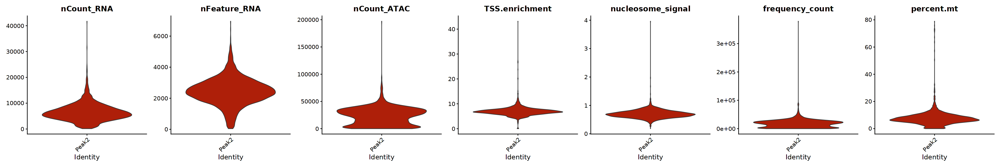

...

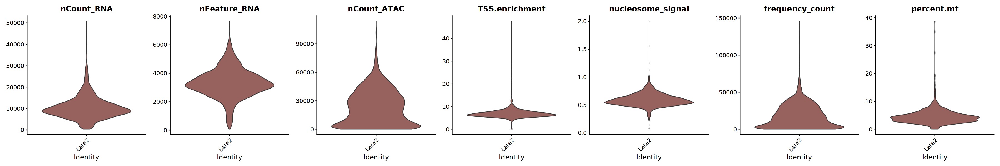

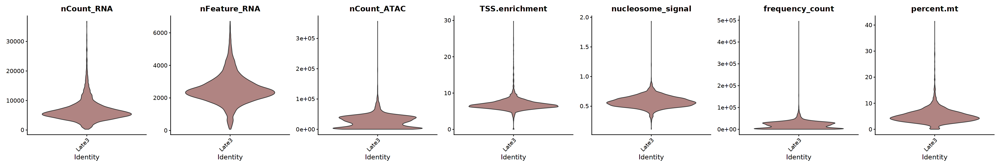

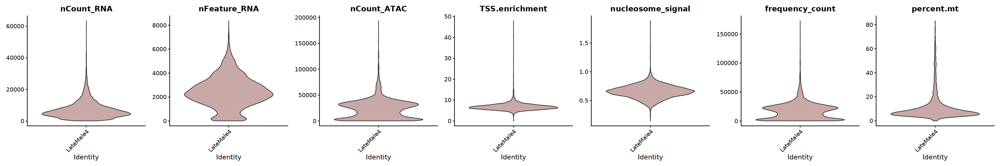

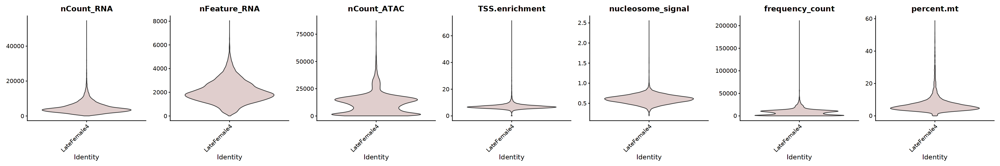

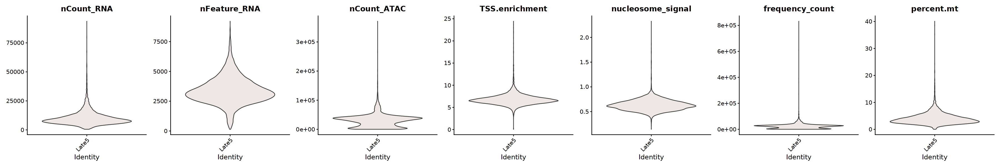

In [66]:
options(repr.plot.width=30, repr.plot.height=5)
for (sample in 1:length(names(orig.ident_colors))){
    tmp <- subset(MORNAATACC, subset = orig.ident == names(orig.ident_colors)[sample])
    Idents(object = tmp) <- "orig.ident"
    print(VlnPlot(object = tmp, features = c("nCount_RNA", "nFeature_RNA", "nCount_ATAC", "TSS.enrichment", "nucleosome_signal", "frequency_count", "percent.mt"), group.by = "orig.ident", cols=orig.ident_colors, ncol = 7, pt.size = 0))
}

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 405

Warning message:
"Removed 3232 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 116

Warning message:
"Removed 3761 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."


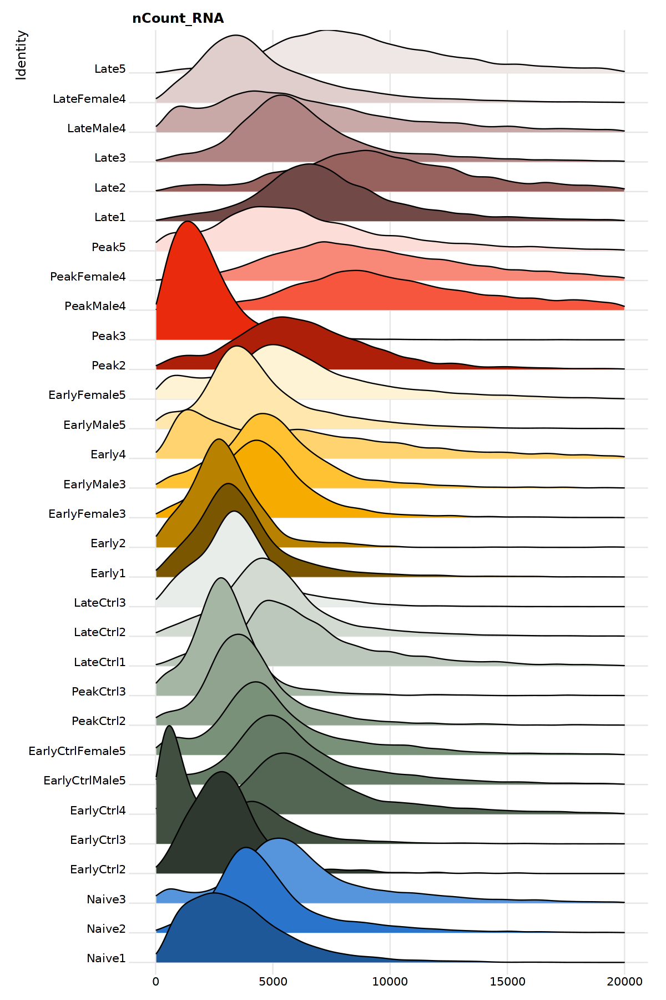

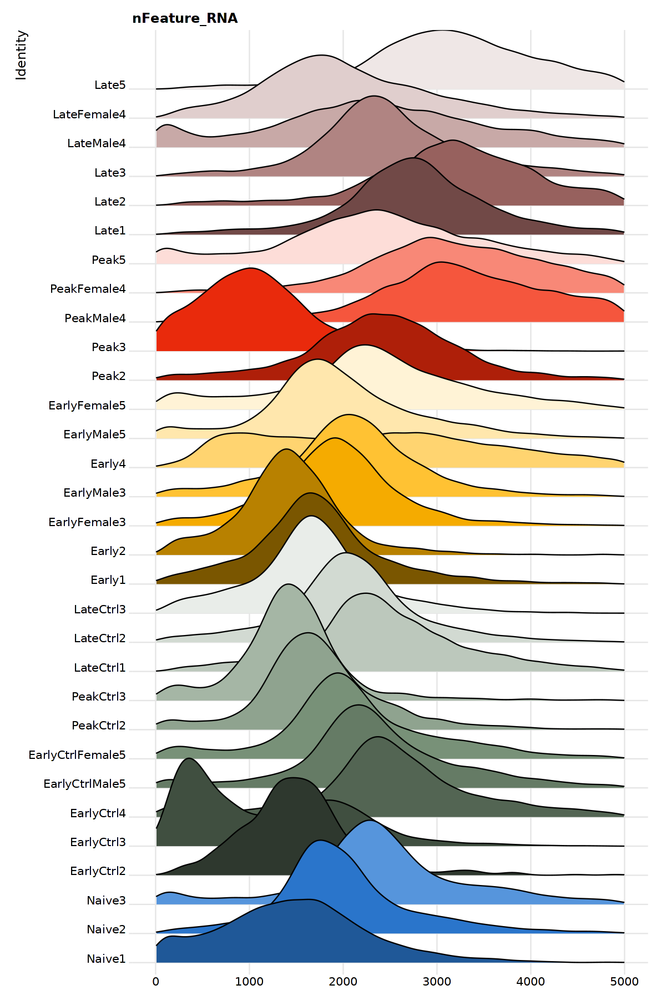

In [67]:
options(repr.plot.width=10, repr.plot.height=15)
RidgePlot(object = MORNAATACC, features = 'nCount_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 20000)) & NoLegend()
RidgePlot(object = MORNAATACC, features = 'nFeature_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 5000)) & NoLegend()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



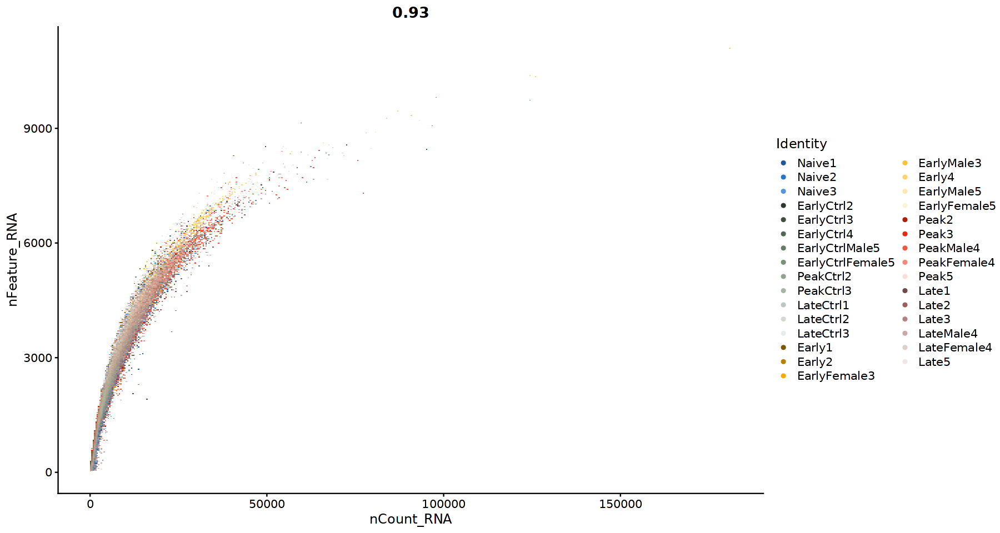

In [68]:
options(repr.plot.width=15, repr.plot.height=8)
FeatureScatter(MORNAATACC, feature1 = "nCount_RNA", feature2 = "nFeature_RNA", group.by ="orig.ident", cols=orig.ident_colors)

In [69]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == "Naive")

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 321

Warning message:
"Removed 177 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 99.2

Warning message:
"Removed 179 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."


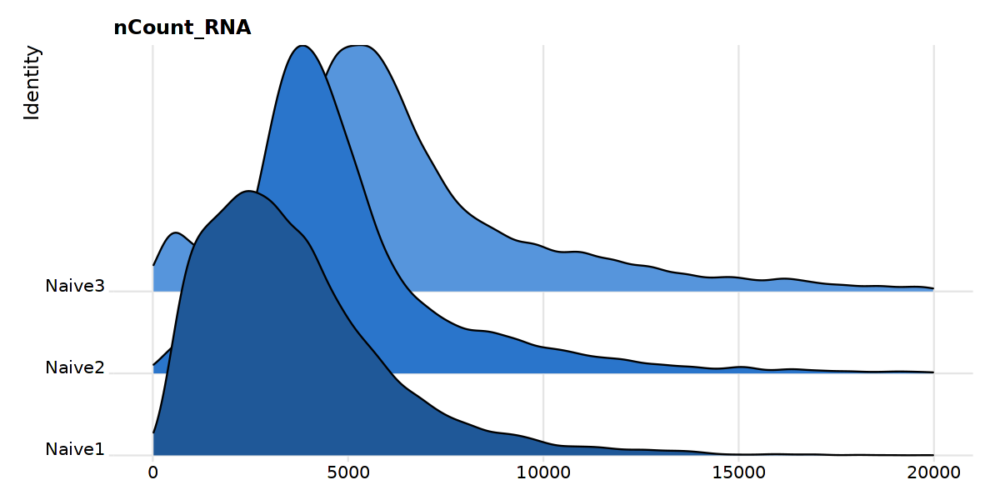

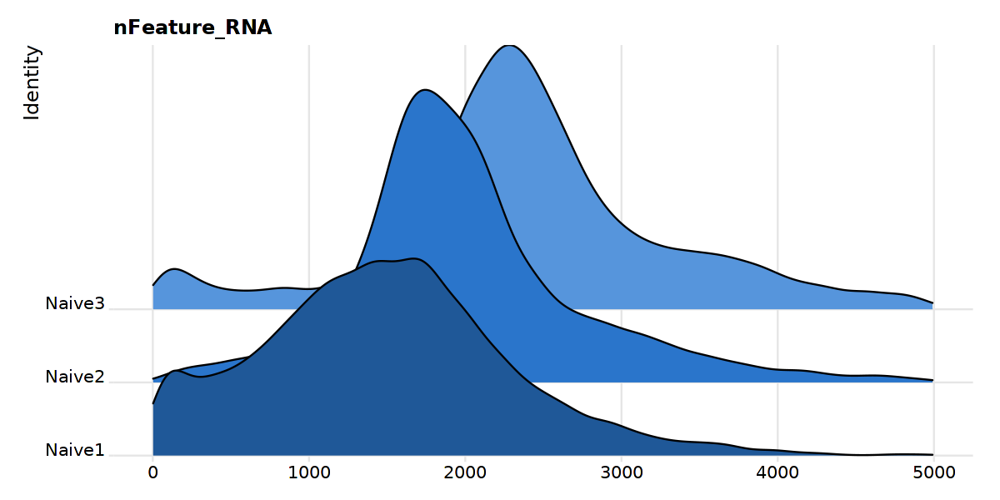

In [70]:
options(repr.plot.width=10, repr.plot.height=5)
RidgePlot(object = tmp, features = 'nCount_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 20000)) & NoLegend()
RidgePlot(object = tmp, features = 'nFeature_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 5000)) & NoLegend()

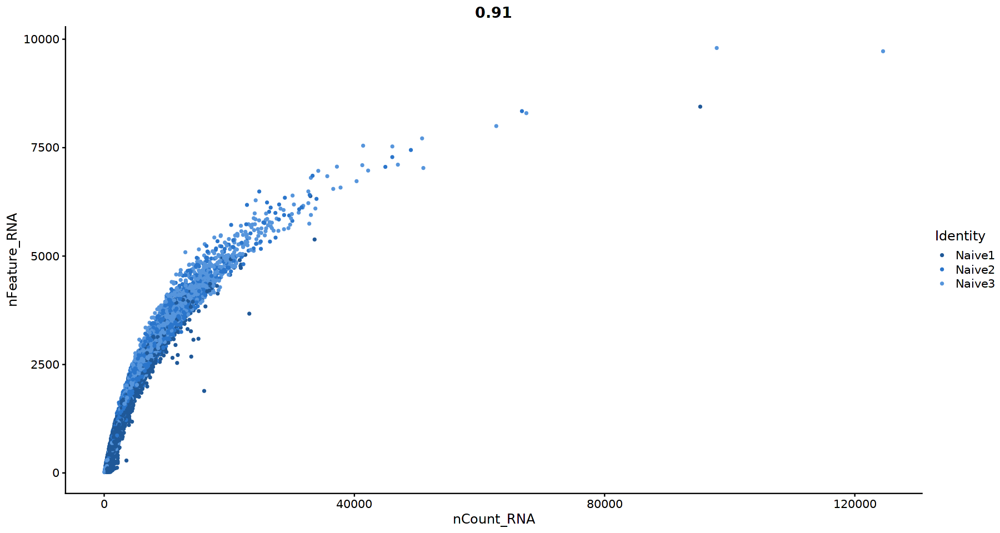

In [71]:
options(repr.plot.width=15, repr.plot.height=8)
FeatureScatter(tmp, feature1 = "nCount_RNA", feature2 = "nFeature_RNA", group.by ="orig.ident", cols=orig.ident_colors)

In [72]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == "Ctrl")

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 319

Warning message:
"Removed 375 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 99.2

Warning message:
"Removed 448 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."


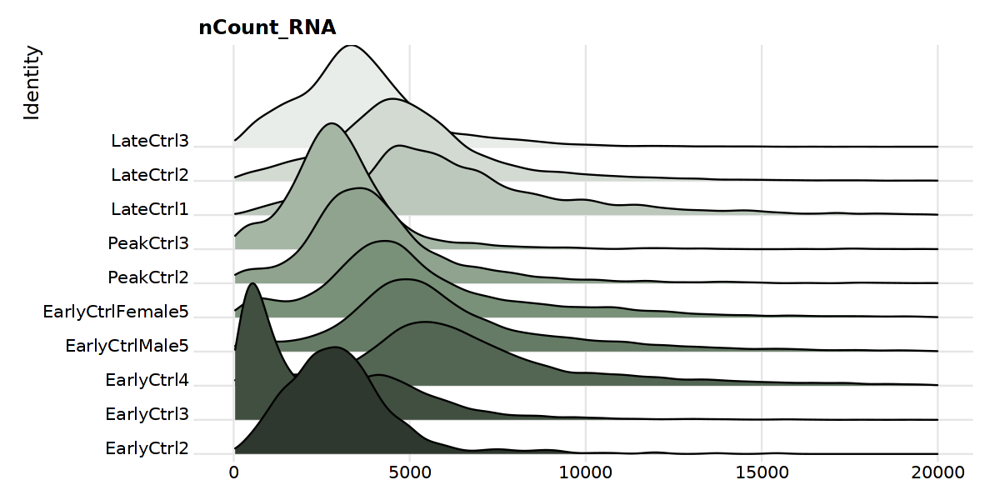

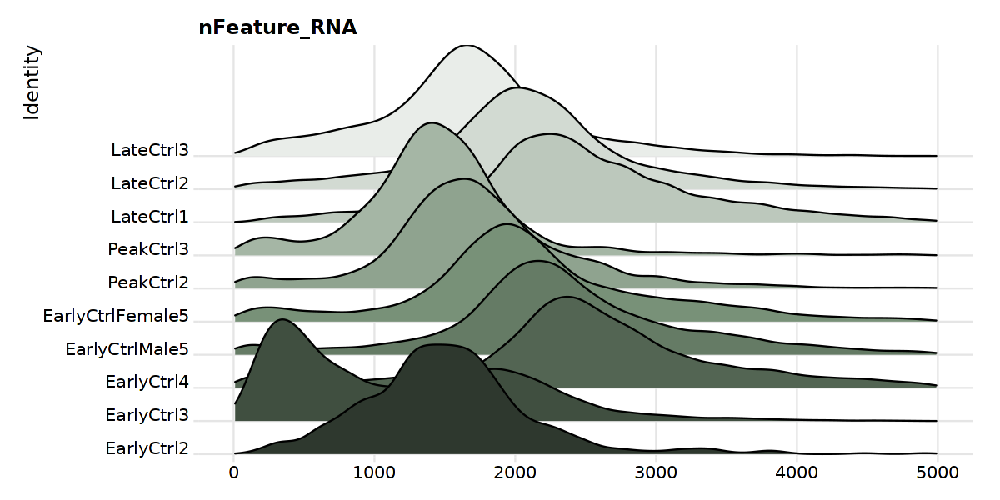

In [73]:
options(repr.plot.width=10, repr.plot.height=5)
RidgePlot(object = tmp, features = 'nCount_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 20000)) & NoLegend()
RidgePlot(object = tmp, features = 'nFeature_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 5000)) & NoLegend()

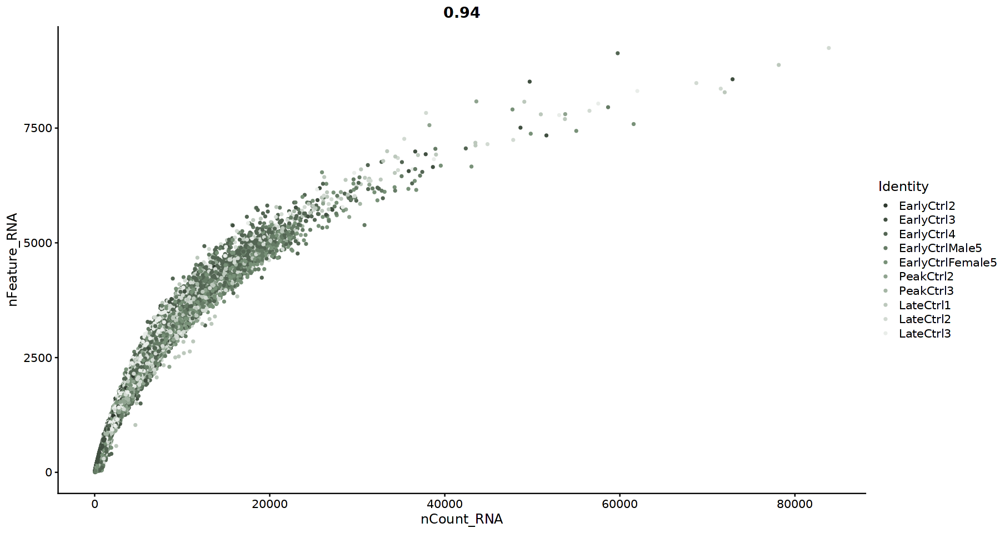

In [74]:
options(repr.plot.width=15, repr.plot.height=8)
FeatureScatter(tmp, feature1 = "nCount_RNA", feature2 = "nFeature_RNA", group.by ="orig.ident", cols=orig.ident_colors)

In [75]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == "Early")

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 368

Warning message:
"Removed 602 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 114

Warning message:
"Removed 771 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."


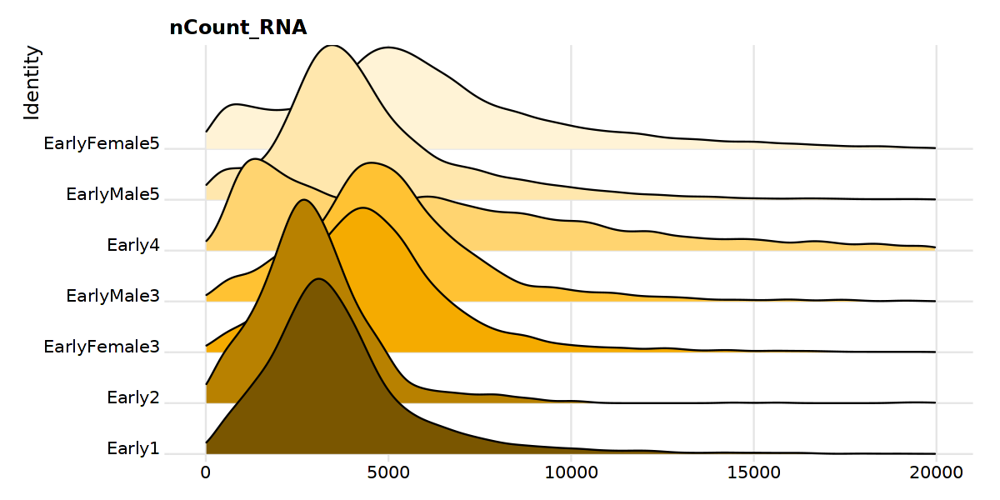

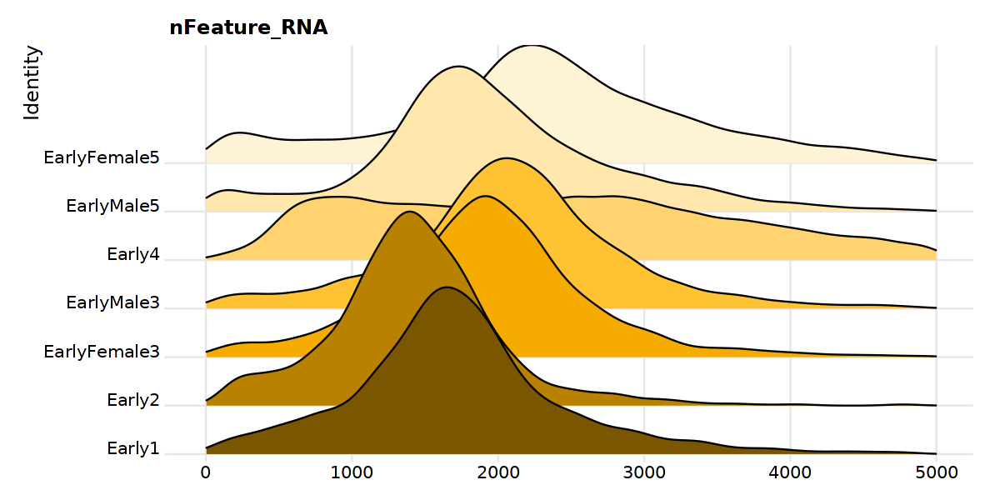

In [76]:
options(repr.plot.width=10, repr.plot.height=5)
RidgePlot(object = tmp, features = 'nCount_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 20000)) & NoLegend()
RidgePlot(object = tmp, features = 'nFeature_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 5000)) & NoLegend()

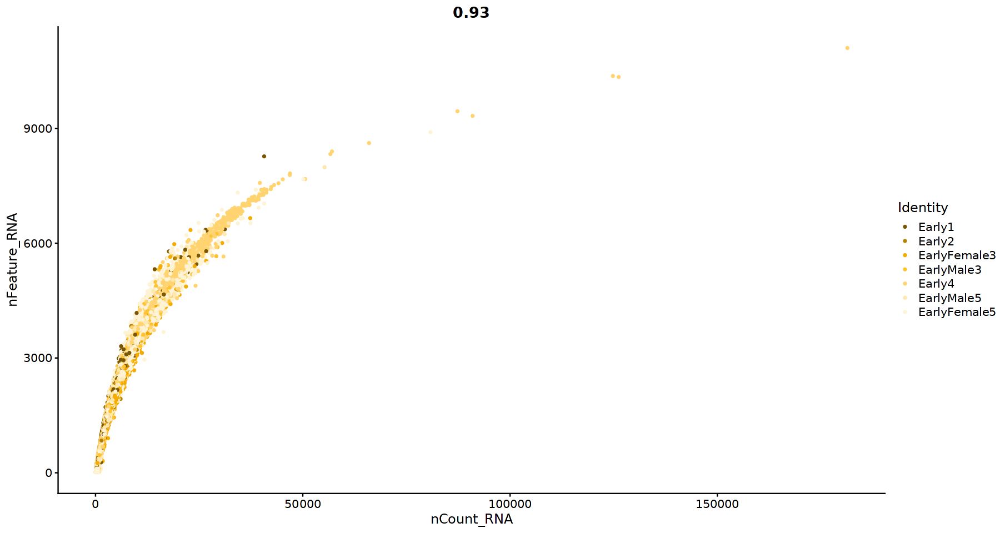

In [77]:
options(repr.plot.width=15, repr.plot.height=8)
FeatureScatter(tmp, feature1 = "nCount_RNA", feature2 = "nFeature_RNA", group.by ="orig.ident", cols=orig.ident_colors)

In [78]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == "Peak")

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 543

Warning message:
"Removed 1144 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 142

Warning message:
"Removed 1195 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."


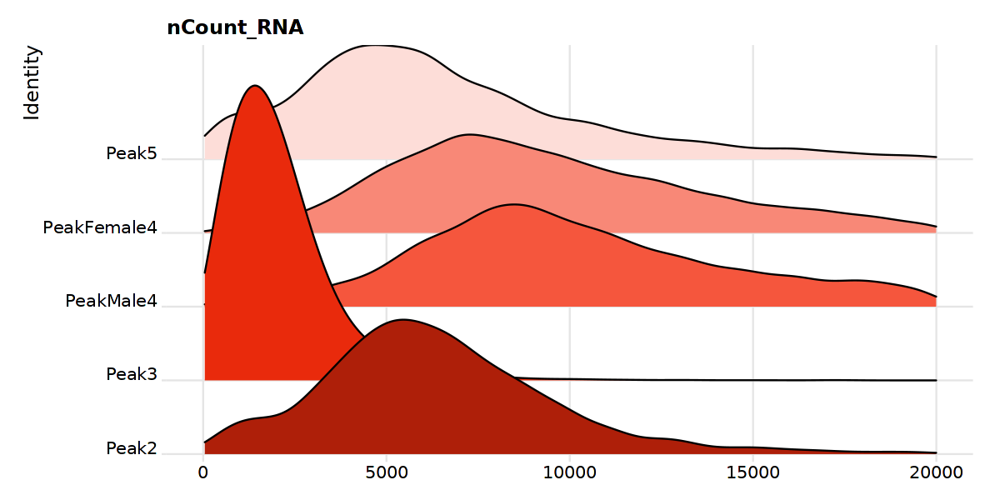

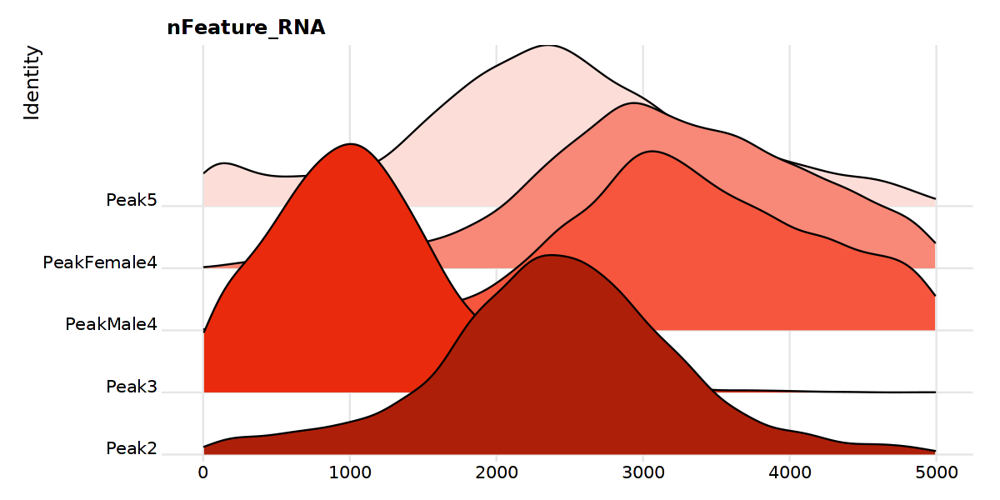

In [79]:
options(repr.plot.width=10, repr.plot.height=5)
RidgePlot(object = tmp, features = 'nCount_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 20000)) & NoLegend()
RidgePlot(object = tmp, features = 'nFeature_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 5000)) & NoLegend()

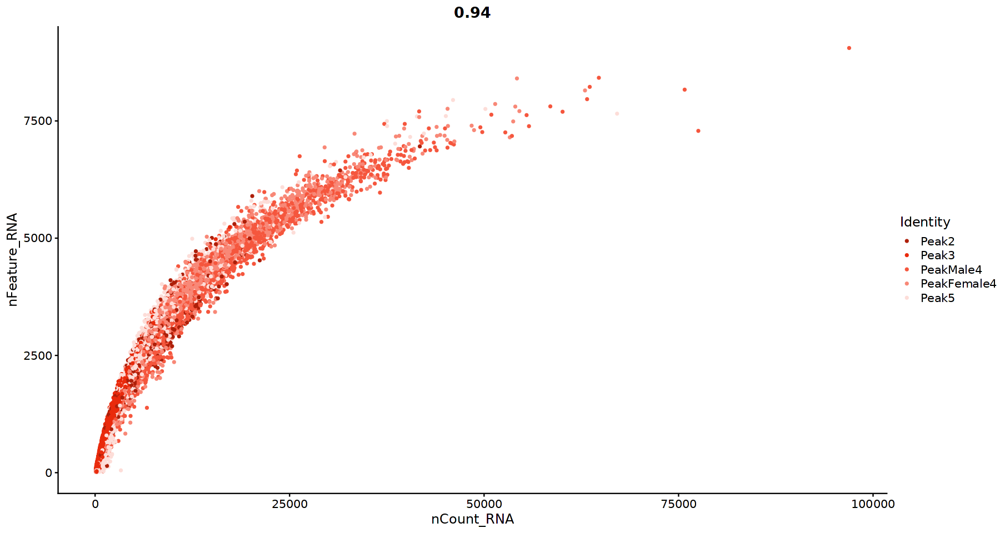

In [80]:
options(repr.plot.width=15, repr.plot.height=8)
FeatureScatter(tmp, feature1 = "nCount_RNA", feature2 = "nFeature_RNA", group.by ="orig.ident", cols=orig.ident_colors)

In [89]:
tmp <- subset(MORNAATACC, subset = orig.ident_merge == "Late")

Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 518

Warning message:
"Removed 934 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Picking joint bandwidth of 135

Warning message:
"Removed 1167 rows containing non-finite outside the scale range
(`stat_density_ridges()`)."


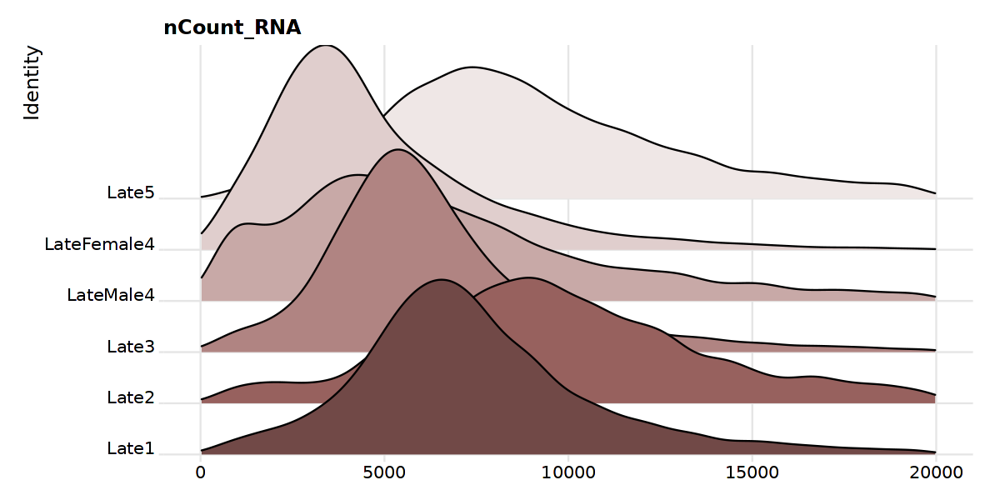

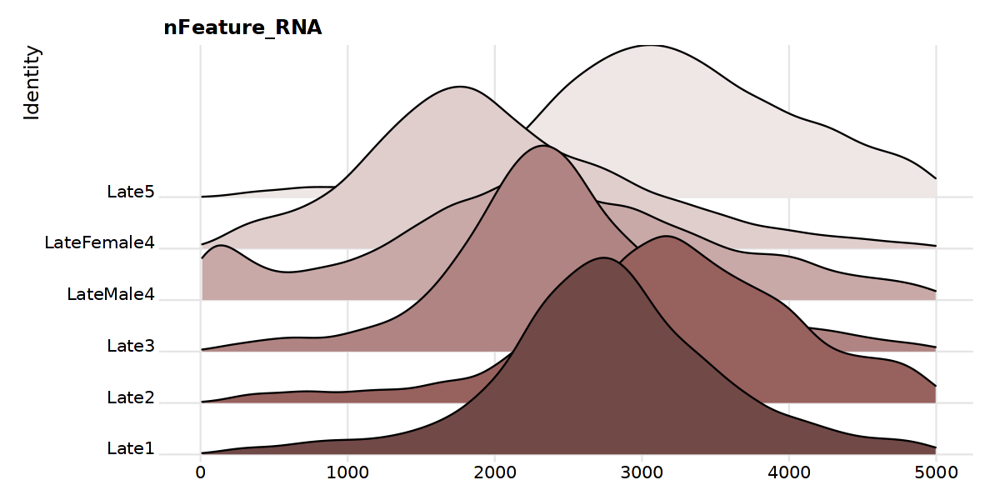

In [82]:
options(repr.plot.width=10, repr.plot.height=5)
RidgePlot(object = tmp, features = 'nCount_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 20000)) & NoLegend()
RidgePlot(object = tmp, features = 'nFeature_RNA', group.by="orig.ident", slot="counts", cols=orig.ident_colors) + xlim(c(0, 5000)) & NoLegend()

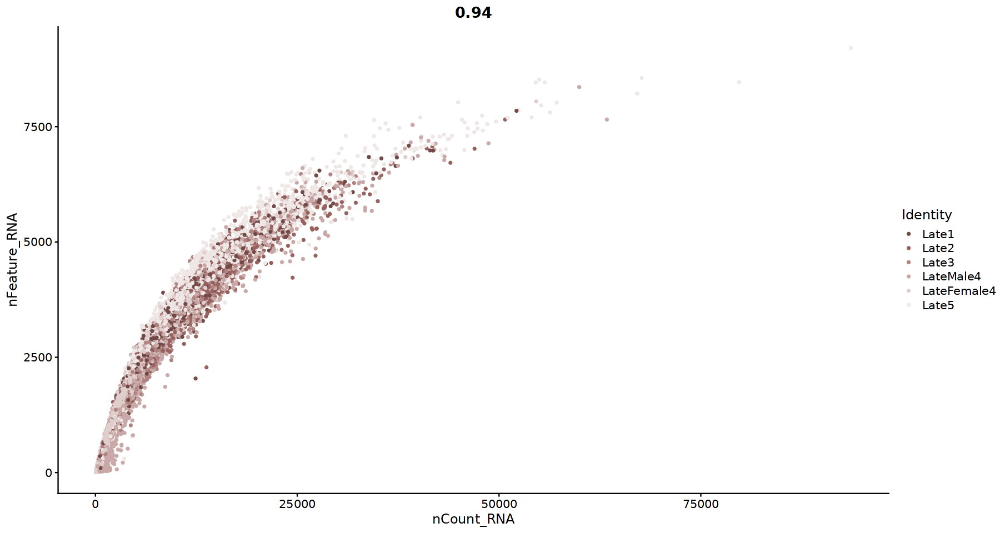

In [83]:
options(repr.plot.width=15, repr.plot.height=8)
FeatureScatter(tmp, feature1 = "nCount_RNA", feature2 = "nFeature_RNA", group.by ="orig.ident", cols=orig.ident_colors)

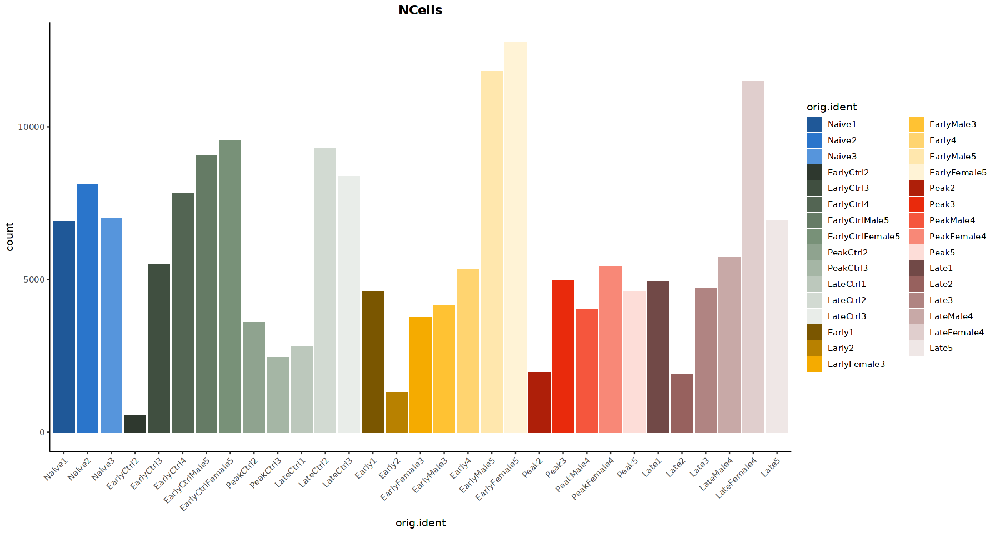

In [97]:
options(repr.plot.width=15, repr.plot.height=8)
MORNAATACC@meta.data %>% 
    ggplot(aes(x=orig.ident, fill=orig.ident)) + 
    geom_bar() +
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    theme(plot.title = element_text(hjust=0.5, face="bold")) +
    scale_fill_manual(values=orig.ident_colors) +
    ggtitle("NCells")

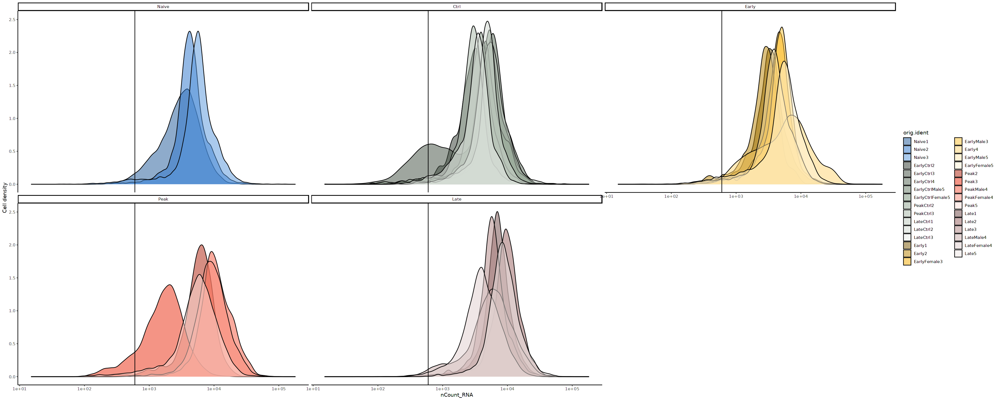

In [98]:
options(repr.plot.width=30, repr.plot.height=12)
MORNAATACC@meta.data %>% 
    ggplot(aes(color=orig.ident, x=nCount_RNA, fill= orig.ident)) + 
    geom_density(color="black", alpha = 0.5) + 
    scale_x_log10() + 
    theme_classic() +
    ylab("Cell density") +
    geom_vline(xintercept = 600) +
    scale_fill_manual(values=orig.ident_colors) +
    facet_wrap(~orig.ident_merge)

`geom_smooth()` using formula = 'y ~ x'
Warning message:
"The following aesthetics were dropped during statistical transformation:
colour.
ℹ This can happen when ggplot fails to infer the correct grouping structure in
  the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical
  variable into a factor?"
Warning message:
"The following aesthetics were dropped during statistical transformation:
colour.
ℹ This can happen when ggplot fails to infer the correct grouping structure in
  the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical
  variable into a factor?"
Warning message:
"The following aesthetics were dropped during statistical transformation:
colour.
ℹ This can happen when ggplot fails to infer the correct grouping structure in
  the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical
  variable into a factor?"
Warning message:
"The following aesthetics were dropped during statistical transformati

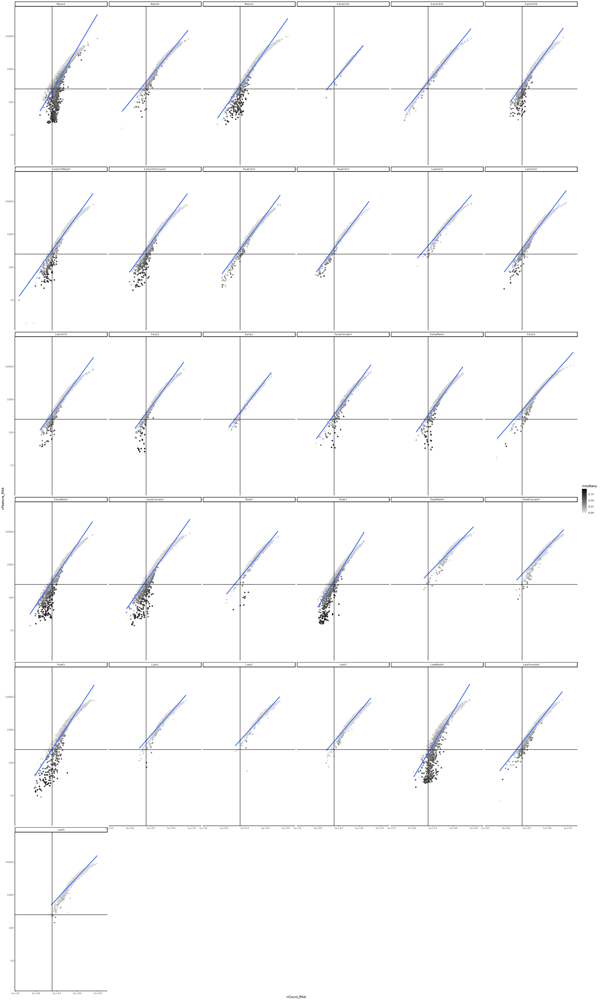

In [99]:
options(repr.plot.width=30, repr.plot.height=50)
MORNAATACC@meta.data %>% 
    ggplot(aes(x=nCount_RNA, y=nFeature_RNA, color=mitoRatio)) + 
    geom_point() + 
    scale_colour_gradient(low = "gray90", high = "black") +
    stat_smooth(method=lm) +
    scale_x_log10() + 
    scale_y_log10() + 
    theme_classic() +
    geom_vline(xintercept = 600) +
    geom_hline(yintercept = 250) +
    facet_wrap(~orig.ident)

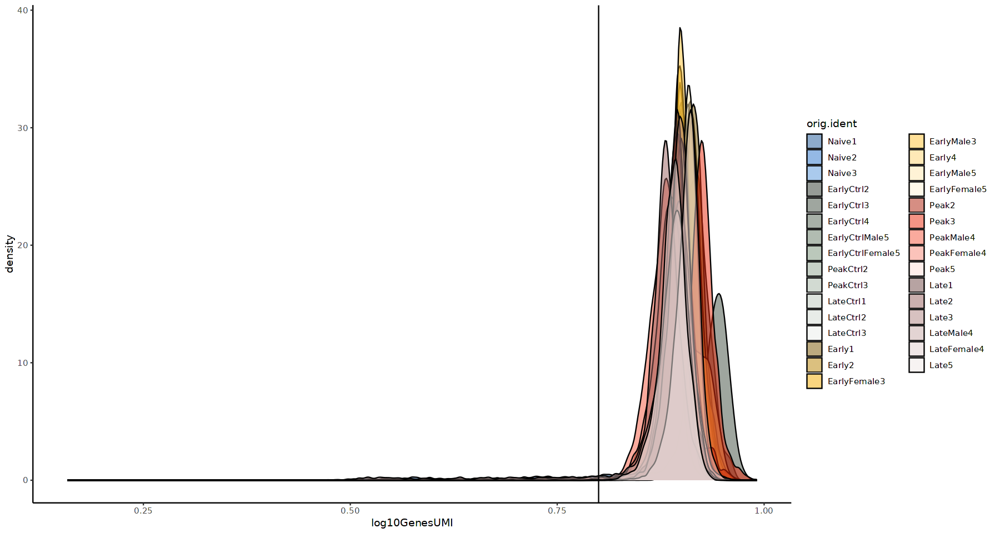

In [100]:
options(repr.plot.width=15, repr.plot.height=8)
MORNAATACC@meta.data %>%
    ggplot(aes(x=log10GenesUMI, color = orig.ident, fill=orig.ident)) +
    geom_density(color='black', alpha = 0.5) +
    theme_classic() +
    geom_vline(xintercept = 0.8) +
    scale_fill_manual(values=orig.ident_colors)

### 3.3 QC cutoffs

In [13]:
QC_nCount_ATAC_max <- c(50000,50000,100000,30000,100000,100000,100000,100000,100000,50000,100000,100000,100000,70000,30000,100000,70000,50000,70000,70000,70000,30000,70000,100000,100000,100000,90000,100000,100000,50000,100000)
QC_nCount_ATAC_min <- c(1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000,1000)
QC_nCount_RNA_max <- c(15000,20000,20000,10000,10000,20000,20000,20000,15000,10000,20000,20000,10000,15000,10000,15000,15000,50000,20000,20000,20000,7000,50000,40000,25000,25000,30000,20000,30000,20000,30000)
QC_nCount_RNA_min <- c(600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600,600)
QC_nFeature_RNA_min <- c(250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250)
QC_nucleosome_signal_max <- c(1,1,1.2,1.2,1,1.2,1.2,1.2,1,1.2,1,0.8,1,1,1,1,1,1.5,1.5,1.2,1.2,1.5,1.2,1.2,1.5,1,1,1,1,1,1)
QC_TSS_enrichment_min <- c(2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2)
QC_percentMT_max <- c(50,20,15,15,15,15,15,15,20,15,15,20,25,25,15,25,25,20,25,20,20,40,15,15,30,15,15,15,40,25,15)

In [14]:
table(MORNAATACC$orig.ident)


          Naive1           Naive2           Naive3       EarlyCtrl2 
            6901             8123             7011              564 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
            5509             7828             9068             9555 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
            3599             2459             2813             9308 
       LateCtrl3           Early1           Early2     EarlyFemale3 
            8385             4612             1308             3753 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
            4166             5344            11835            12783 
           Peak2            Peak3        PeakMale4      PeakFemale4 
            1969             4958             4033             5440 
           Peak5            Late1            Late2            Late3 
            4617             4944             1880             4727 
       LateMale4      LateFemale4

In [15]:
table(MORNAATACC$orig.ident, MORNAATACC$orig.ident_merge)

                  
                   Naive  Ctrl Early  Peak  Late
  Naive1            6901     0     0     0     0
  Naive2            8123     0     0     0     0
  Naive3            7011     0     0     0     0
  EarlyCtrl2           0   564     0     0     0
  EarlyCtrl3           0  5509     0     0     0
  EarlyCtrl4           0  7828     0     0     0
  EarlyCtrlMale5       0  9068     0     0     0
  EarlyCtrlFemale5     0  9555     0     0     0
  PeakCtrl2            0  3599     0     0     0
  PeakCtrl3            0  2459     0     0     0
  LateCtrl1            0  2813     0     0     0
  LateCtrl2            0  9308     0     0     0
  LateCtrl3            0  8385     0     0     0
  Early1               0     0  4612     0     0
  Early2               0     0  1308     0     0
  EarlyFemale3         0     0  3753     0     0
  EarlyMale3           0     0  4166     0     0
  Early4               0     0  5344     0     0
  EarlyMale5           0     0 11835     0     0
 

In [16]:
table(MORNAATACC$orig.ident, MORNAATACC$batch)

                  
                      B1    B2    B3    B4    B5    B6    B7    B8
  Naive1               0     0     0     0     0     0  6901     0
  Naive2               0     0     0     0     0     0  8123     0
  Naive3               0     0     0     0     0     0     0  7011
  EarlyCtrl2           0     0   564     0     0     0     0     0
  EarlyCtrl3           0     0     0  5509     0     0     0     0
  EarlyCtrl4           0     0     0     0     0     0     0  7828
  EarlyCtrlMale5       0     0     0     0     0     0     0  9068
  EarlyCtrlFemale5     0     0     0     0     0     0     0  9555
  PeakCtrl2         3599     0     0     0     0     0     0     0
  PeakCtrl3            0     0  2459     0     0     0     0     0
  LateCtrl1            0  2813     0     0     0     0     0     0
  LateCtrl2            0     0     0     0  9308     0     0     0
  LateCtrl3            0     0     0     0  8385     0     0     0
  Early1            4612     0     0     0 

In [17]:
table(MORNAATACC$orig.ident, MORNAATACC$model)

                  
                   Naive  Ctrl   EAE
  Naive1            6901     0     0
  Naive2            8123     0     0
  Naive3            7011     0     0
  EarlyCtrl2           0   564     0
  EarlyCtrl3           0  5509     0
  EarlyCtrl4           0  7828     0
  EarlyCtrlMale5       0  9068     0
  EarlyCtrlFemale5     0  9555     0
  PeakCtrl2            0  3599     0
  PeakCtrl3            0  2459     0
  LateCtrl1            0  2813     0
  LateCtrl2            0  9308     0
  LateCtrl3            0  8385     0
  Early1               0     0  4612
  Early2               0     0  1308
  EarlyFemale3         0     0  3753
  EarlyMale3           0     0  4166
  Early4               0     0  5344
  EarlyMale5           0     0 11835
  EarlyFemale5         0     0 12783
  Peak2                0     0  1969
  Peak3                0     0  4958
  PeakMale4            0     0  4033
  PeakFemale4          0     0  5440
  Peak5                0     0  4617
  Late1            

In [18]:
table(MORNAATACC$orig.ident, MORNAATACC$debrisRemoval)

                  
                   Percoll Debris
  Naive1                 0   6901
  Naive2                 0   8123
  Naive3                 0   7011
  EarlyCtrl2           564      0
  EarlyCtrl3          5509      0
  EarlyCtrl4             0   7828
  EarlyCtrlMale5         0   9068
  EarlyCtrlFemale5       0   9555
  PeakCtrl2           3599      0
  PeakCtrl3           2459      0
  LateCtrl1           2813      0
  LateCtrl2           9308      0
  LateCtrl3           8385      0
  Early1              4612      0
  Early2              1308      0
  EarlyFemale3        3753      0
  EarlyMale3          4166      0
  Early4                 0   5344
  EarlyMale5             0  11835
  EarlyFemale5           0  12783
  Peak2               1969      0
  Peak3               4958      0
  PeakMale4              0   4033
  PeakFemale4            0   5440
  Peak5                  0   4617
  Late1               4944      0
  Late2               1880      0
  Late3               4727   

In [19]:
# Found good quality cells
good_cells <- c()
for (sample in 1:length(names(orig.ident_colors))){
    tmp <- subset(MORNAATACC, subset = orig.ident == names(orig.ident_colors)[sample])
    Idents(object = tmp) <- "orig.ident"
    tmp <- subset(
      x = tmp,
      subset = 
        nCount_ATAC < QC_nCount_ATAC_max[sample] &
        nCount_RNA < QC_nCount_RNA_max[sample] &
        nCount_ATAC > QC_nCount_ATAC_min[sample] &
        nCount_RNA > QC_nCount_RNA_min[sample] &
        nFeature_RNA > QC_nFeature_RNA_min[sample] &
        nucleosome_signal < QC_nucleosome_signal_max[sample] &
        TSS.enrichment > QC_TSS_enrichment_min[sample] &
        percent.mt < QC_percentMT_max[sample]
    )
    good_cells <- c(good_cells, colnames(tmp))
}

In [20]:
#Number of cells to be removed
nrow(MORNAATACC@meta.data[!rownames(MORNAATACC@meta.data) %in% good_cells,])

[1] 22873

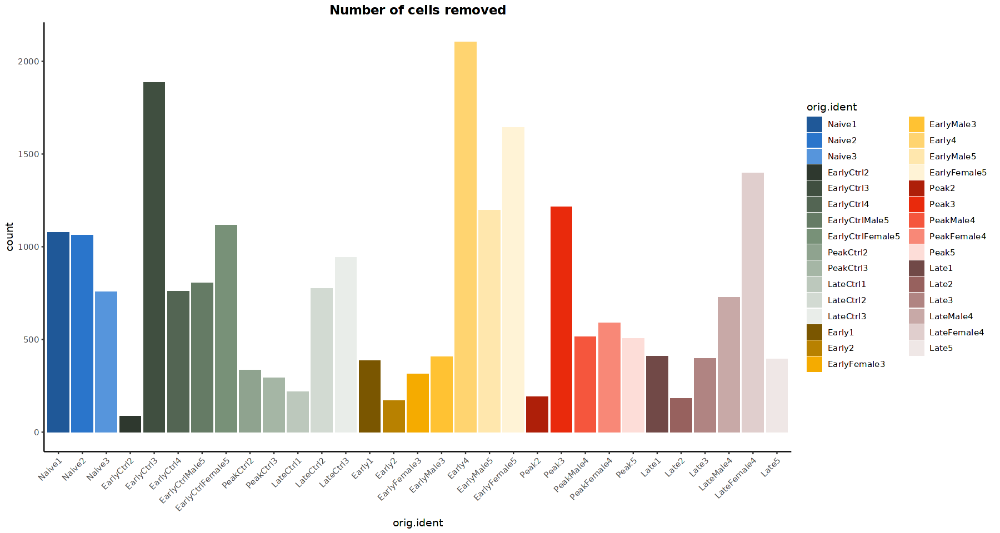

In [21]:
options(repr.plot.width=15, repr.plot.height=8)
MORNAATACC@meta.data[!rownames(MORNAATACC@meta.data) %in% good_cells,] %>% 
    ggplot(aes(x=orig.ident, fill=orig.ident)) + 
    geom_bar() +
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    theme(plot.title = element_text(hjust=0.5, face="bold")) +
    scale_fill_manual(values=orig.ident_colors) +
    ggtitle("Number of cells removed")

In [22]:
MORNAATACC <- subset(MORNAATACC, cells = good_cells)

In [23]:
MORNAATACC

An object of class Seurat 
236868 features across 158801 samples within 3 assays 
Active assay: ATAC (172298 features, 0 variable features)
 2 layers present: counts, data
 2 other assays present: RAW, RNA

In [24]:
table(MORNAATACC$orig.ident)


          Naive1           Naive2           Naive3       EarlyCtrl2 
            5822             7059             6253              477 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
            3623             7069             8262             8437 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
            3263             2166             2596             8534 
       LateCtrl3           Early1           Early2     EarlyFemale3 
            7443             4225             1138             3438 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
            3759             3239            10639            11138 
           Peak2            Peak3        PeakMale4      PeakFemale4 
            1777             3744             3517             4851 
           Peak5            Late1            Late2            Late3 
            4111             4535             1697             4329 
       LateMale4      LateFemale4

In [25]:
table(MORNAATACC$orig.ident, MORNAATACC$orig.ident_merge)

                  
                   Naive  Ctrl Early  Peak  Late
  Naive1            5822     0     0     0     0
  Naive2            7059     0     0     0     0
  Naive3            6253     0     0     0     0
  EarlyCtrl2           0   477     0     0     0
  EarlyCtrl3           0  3623     0     0     0
  EarlyCtrl4           0  7069     0     0     0
  EarlyCtrlMale5       0  8262     0     0     0
  EarlyCtrlFemale5     0  8437     0     0     0
  PeakCtrl2            0  3263     0     0     0
  PeakCtrl3            0  2166     0     0     0
  LateCtrl1            0  2596     0     0     0
  LateCtrl2            0  8534     0     0     0
  LateCtrl3            0  7443     0     0     0
  Early1               0     0  4225     0     0
  Early2               0     0  1138     0     0
  EarlyFemale3         0     0  3438     0     0
  EarlyMale3           0     0  3759     0     0
  Early4               0     0  3239     0     0
  EarlyMale5           0     0 10639     0     0
 

In [26]:
table(MORNAATACC$orig.ident, MORNAATACC$batch)

                  
                      B1    B2    B3    B4    B5    B6    B7    B8
  Naive1               0     0     0     0     0     0  5822     0
  Naive2               0     0     0     0     0     0  7059     0
  Naive3               0     0     0     0     0     0     0  6253
  EarlyCtrl2           0     0   477     0     0     0     0     0
  EarlyCtrl3           0     0     0  3623     0     0     0     0
  EarlyCtrl4           0     0     0     0     0     0     0  7069
  EarlyCtrlMale5       0     0     0     0     0     0     0  8262
  EarlyCtrlFemale5     0     0     0     0     0     0     0  8437
  PeakCtrl2         3263     0     0     0     0     0     0     0
  PeakCtrl3            0     0  2166     0     0     0     0     0
  LateCtrl1            0  2596     0     0     0     0     0     0
  LateCtrl2            0     0     0     0  8534     0     0     0
  LateCtrl3            0     0     0     0  7443     0     0     0
  Early1            4225     0     0     0 

In [27]:
table(MORNAATACC$orig.ident, MORNAATACC$model)

                  
                   Naive  Ctrl   EAE
  Naive1            5822     0     0
  Naive2            7059     0     0
  Naive3            6253     0     0
  EarlyCtrl2           0   477     0
  EarlyCtrl3           0  3623     0
  EarlyCtrl4           0  7069     0
  EarlyCtrlMale5       0  8262     0
  EarlyCtrlFemale5     0  8437     0
  PeakCtrl2            0  3263     0
  PeakCtrl3            0  2166     0
  LateCtrl1            0  2596     0
  LateCtrl2            0  8534     0
  LateCtrl3            0  7443     0
  Early1               0     0  4225
  Early2               0     0  1138
  EarlyFemale3         0     0  3438
  EarlyMale3           0     0  3759
  Early4               0     0  3239
  EarlyMale5           0     0 10639
  EarlyFemale5         0     0 11138
  Peak2                0     0  1777
  Peak3                0     0  3744
  PeakMale4            0     0  3517
  PeakFemale4          0     0  4851
  Peak5                0     0  4111
  Late1            

In [28]:
table(MORNAATACC$orig.ident, MORNAATACC$debrisRemoval)

                  
                   Percoll Debris
  Naive1                 0   5822
  Naive2                 0   7059
  Naive3                 0   6253
  EarlyCtrl2           477      0
  EarlyCtrl3          3623      0
  EarlyCtrl4             0   7069
  EarlyCtrlMale5         0   8262
  EarlyCtrlFemale5       0   8437
  PeakCtrl2           3263      0
  PeakCtrl3           2166      0
  LateCtrl1           2596      0
  LateCtrl2           8534      0
  LateCtrl3           7443      0
  Early1              4225      0
  Early2              1138      0
  EarlyFemale3        3438      0
  EarlyMale3          3759      0
  Early4                 0   3239
  EarlyMale5             0  10639
  EarlyFemale5           0  11138
  Peak2               1777      0
  Peak3               3744      0
  PeakMale4              0   3517
  PeakFemale4            0   4851
  Peak5                  0   4111
  Late1               4535      0
  Late2               1697      0
  Late3               4329   

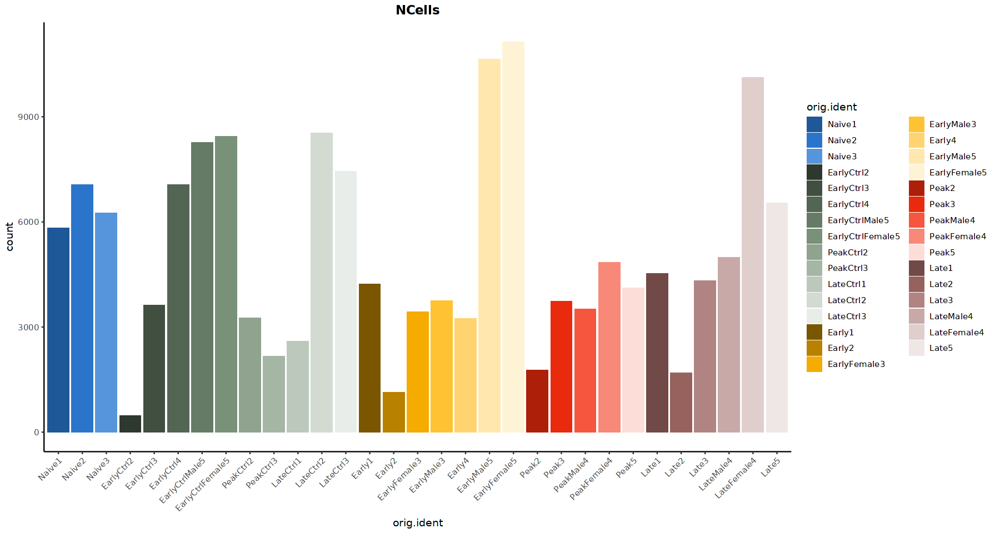

In [29]:
options(repr.plot.width=15, repr.plot.height=8)
MORNAATACC@meta.data %>% 
    ggplot(aes(x=orig.ident, fill=orig.ident)) + 
    geom_bar() +
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    theme(plot.title = element_text(hjust=0.5, face="bold")) +
    scale_fill_manual(values=orig.ident_colors) +
    ggtitle("NCells")

In [12]:
min(unlist(lapply(unique(MORNAATACC$orig.ident), function(x){mean(MORNAATACC@meta.data[MORNAATACC$orig.ident == x, "FRiP"])})))
max(unlist(lapply(unique(MORNAATACC$orig.ident), function(x){mean(MORNAATACC@meta.data[MORNAATACC$orig.ident == x, "FRiP"])})))

[1] 0.6384706

[1] 0.7947804

Warning message:
"Removed 778 rows containing non-finite outside the scale range
(`stat_ydensity()`)."
Warning message:
"Removed 503 rows containing non-finite outside the scale range
(`stat_ydensity()`)."


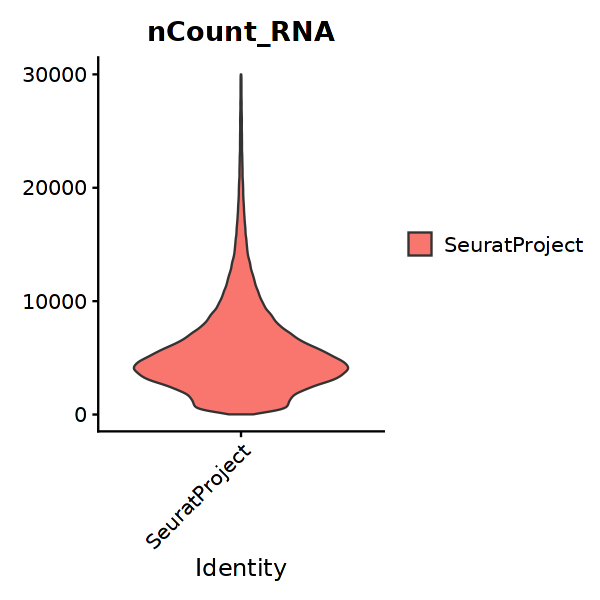

Warning message:
"Removed 637 rows containing non-finite outside the scale range
(`stat_ydensity()`)."


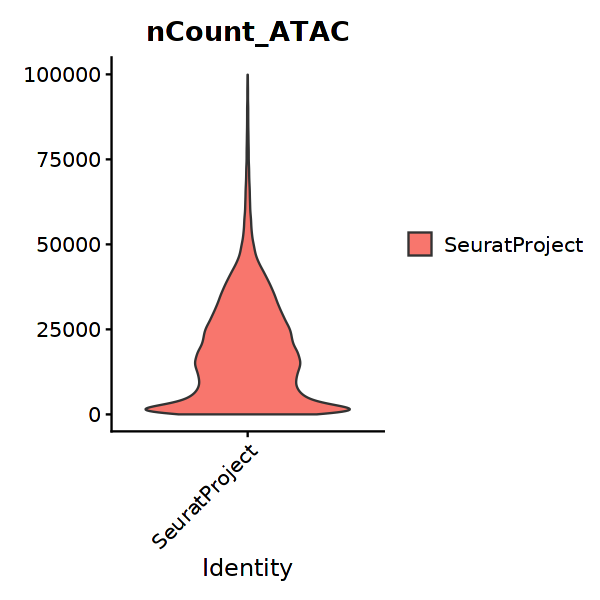

Warning message:
"Removed 67 rows containing non-finite outside the scale range
(`stat_ydensity()`)."


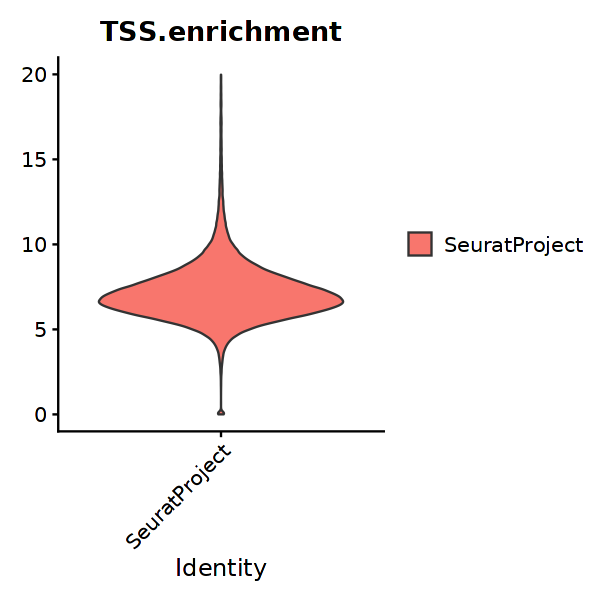

Warning message:
"Removed 738 rows containing non-finite outside the scale range
(`stat_ydensity()`)."


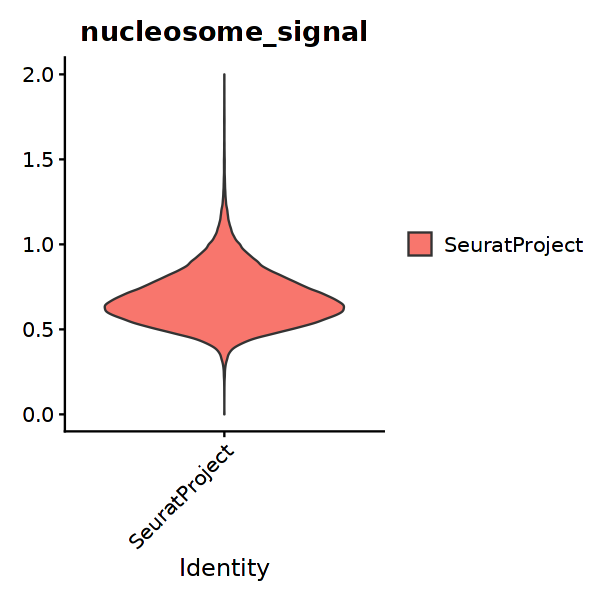

Warning message:
"Removed 3951 rows containing non-finite outside the scale range
(`stat_ydensity()`)."


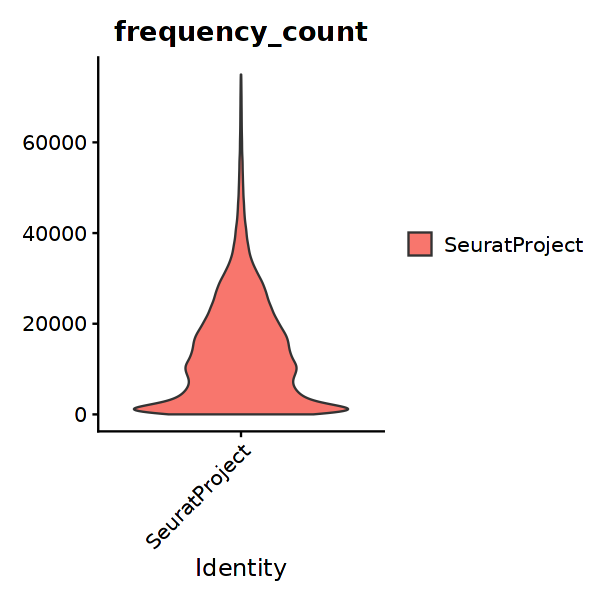

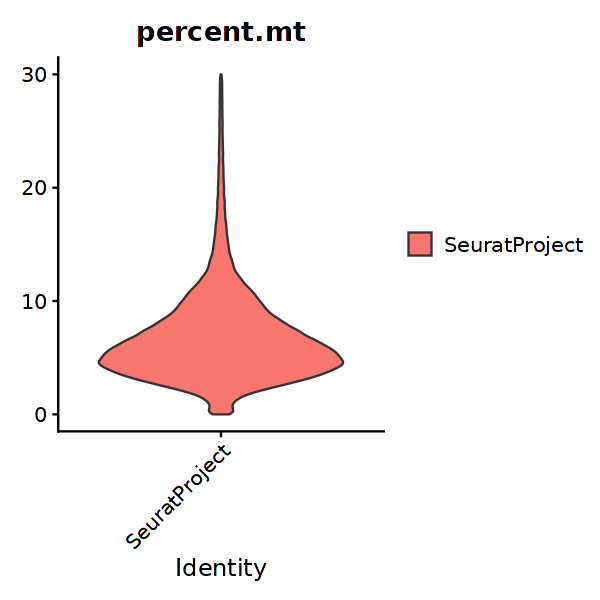

In [29]:
options(repr.plot.width=5, repr.plot.height=5)
Idents(MORNAATACC) <- "old.ident"
VlnPlot(object = MORNAATACC, features = c("nCount_RNA"), pt.size = 0, y.max = 30000, raster=FALSE)
VlnPlot(object = MORNAATACC, features = c("nCount_ATAC"), pt.size = 0, y.max = 100000, raster=FALSE)
VlnPlot(object = MORNAATACC, features = c("TSS.enrichment"), pt.size = 0, y.max = 20, raster=FALSE)
VlnPlot(object = MORNAATACC, features = c("nucleosome_signal"), pt.size = 0, y.max = 2, raster=FALSE)
VlnPlot(object = MORNAATACC, features = c("frequency_count"), pt.size = 0, y.max = 75000, raster=FALSE)
VlnPlot(object = MORNAATACC, features = c("percent.mt"), pt.size = 0, y.max = 30, raster=FALSE)

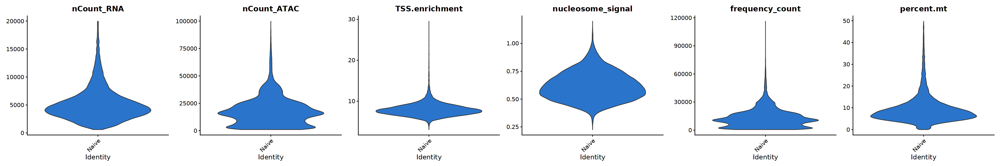

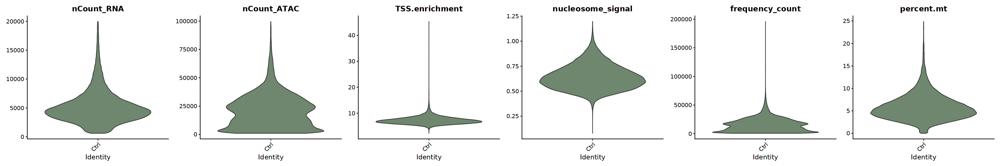

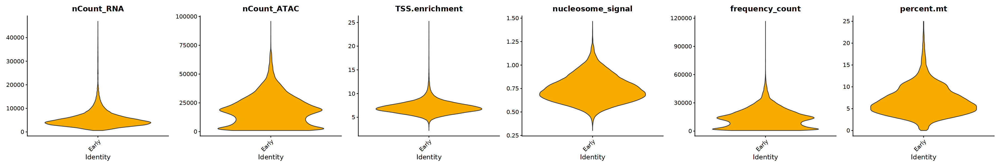

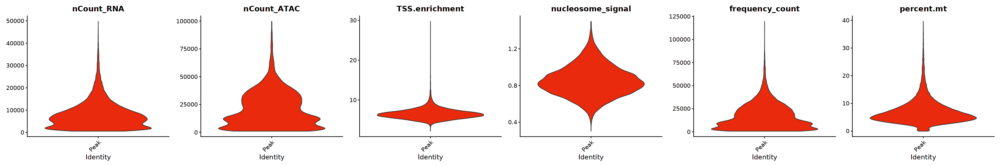

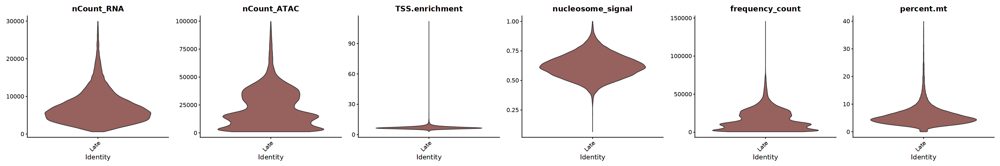

In [232]:
options(repr.plot.width=30, repr.plot.height=5)
for (sample in 1:length(names(orig.ident_merge_colors))){
    tmp <- subset(MORNAATACC, subset = orig.ident_merge == names(orig.ident_merge_colors)[sample])
    Idents(object = tmp) <- "orig.ident_merge"
    print(VlnPlot(object = tmp, features = c("nCount_RNA", "nCount_ATAC", "TSS.enrichment", "nucleosome_signal", "frequency_count", "percent.mt"), group.by = "orig.ident_merge", cols=orig.ident_merge_colors, ncol = 6, pt.size = 0))
}

[Save](#X.1-Savings)

## 4. Peak calling

In [30]:
DefaultAssay(MORNAATACC) <- "ATAC"

In [31]:
# call peaks using MACS2
peaks <- CallPeaks(MORNAATACC[["ATAC"]], macs2.path = macs3_path, outdir=OS_path_outputs, fragment.tempdir=OS_path_outputs)

INFO  @ 18 Jun 2024 09:43:49: [28 MB] 
# Command line: callpeak -t /sing_data/Data/MORNAATACC/Alignment/AGGR_ARC2_MORNAATACC/outs/atac_fragments.tsv.gz -g 2.7e+09 -f BED --nomodel --extsize 200 --shift -100 -n macs2 --outdir /sing_data/Data/MORNAATACC/Outputs/
# ARGUMENTS LIST:
# name = macs2
# format = BED
# ChIP-seq file = ['/sing_data/Data/MORNAATACC/Alignment/AGGR_ARC2_MORNAATACC/outs/atac_fragments.tsv.gz']
# control file = None
# effective genome size = 2.70e+09
# band width = 300
# model fold = [5, 50]
# qvalue cutoff = 5.00e-02
# The maximum gap between significant sites is assigned as the read length/tag size.
# The minimum length of peaks is assigned as the predicted fragment length "d".
# Larger dataset will be scaled towards smaller dataset.
# Range for calculating regional lambda is: 10000 bps
# Broad region calling is off
# Paired-End mode is off
 
INFO  @ 18 Jun 2024 09:43:49: [28 MB] #1 read tag files... 
INFO  @ 18 Jun 2024 09:43:49: [28 MB] #1 read treatment tags... 


In [32]:
# remove peaks on nonstandard chromosomes and in genomic blacklist regions
peaks <- keepStandardChromosomes(peaks, pruning.mode = "coarse")
peaks <- subsetByOverlaps(peaks, ranges = blacklist_mm10, invert = TRUE)

In [33]:
# quantify counts in each peak
macs3_counts <- FeatureMatrix(fragments = Fragments(MORNAATACC), features = peaks, cells = colnames(MORNAATACC))

Extracting reads overlapping genomic regions



In [34]:
# create a new assay using the MACS3 peak set and add it to the Seurat object
MORNAATACC[["peaks"]] <- CreateChromatinAssay(counts = macs3_counts, sep = c(":", "-"), fragments = paste0(OS_path_datasets, "AGGR_ARC2_MORNAATACC/outs/atac_fragments.tsv.gz"), annotation = annotations)

Computing hash

Checking for 158801 cell barcodes


In [35]:
MORNAATACC <- FRiP(MORNAATACC, assay = 'peaks', total.fragments = 'frequency_count')

Calculating fraction of reads in peaks per cell



In [36]:
#Remove ATAC assays, saving space and time, we already have Peaks assays
DefaultAssay(MORNAATACC) <- "RNA"
MORNAATACC[['ATAC']] <- NULL

### 4.1 Save new peak calling

In [12]:
DefaultAssay(MORNAATACC) <- "peaks"

In [19]:
tmp <- DietSeurat(MORNAATACC, assay = c("peaks"), layers = c("counts"), features = NULL, dimreducs = NULL, graphs = NULL)

In [27]:
SaveH5Seurat(tmp, filename = paste0(OS_path_outputs, "MORNAATACC_peaks.h5Seurat"))
Convert(paste0(OS_path_outputs, "MORNAATACC_peaks.h5Seurat"), dest = "h5ad")

Creating h5Seurat file for version 3.1.5.9900

Adding counts for peaks

Adding data for peaks

No variable features found for peaks

Adding feature-level metadata for peaks

Writing out ranges for peaks

Writing out motifs for peaks

Writing out fragments for peaks

Writing out seqinfo for peaks

Writing out annotation for peaks

Writing out bias for peaks

Writing out positionEnrichment for peaks

Writing out links for peaks

Validating h5Seurat file

Warning message:
"Cannot find assayGenePromAcc in the h5Seurat file"
Adding data from peaks as X

Transfering meta.features to var

Adding counts from peaks as raw

Transfering meta.features to raw/var

Transfering meta.data to obs



In [ ]:
tmp <- NULL

### 4.2 Annotate the new peaks

#### 4.2.1 Format annotation

https://www.10xgenomics.com/support/software/cell-ranger-arc/latest/analysis/peak-annotations

Get the annotation Granges, extract protein coding genes and split by transcript names to get all potential TSS

In [74]:
protein_coding_annotation <- annotations[annotations$gene_biotype == "protein_coding" & annotations$type == "exon",]

In [10]:
glst <- lapply(split(protein_coding_annotation, protein_coding_annotation$tx_id),function(x){
    if(length(unique(as.character(seqnames(x))))!=1){
        print("Error : multiple chromosome for that transcript")
        print(x)
    }
    if(length(unique(strand(x)))!=1){
        print("Error : multiple strand for that transcript")
        print(x)
    }
    gr <- GRanges(unique(as.character(seqnames(x))), strand=unique(strand(x)), IRanges(start = min(start(x)), end = max(end(x))), gene_name = paste(unique(x$gene_name),collapse=";"), gene_id=paste(unique(x$gene_id),collapse=";"))
    if(length(gr)!=1) print("More than one line for the transcript")
    return(gr)    
})

In [11]:
suppressWarnings(gr_protein_coding <- sort(unlist(as(glst, "GRangesList"))))

Generate a Granges of TSS positions and extend it by 200kb on both directions from TSS

In [12]:
gr_TSS <- lapply(split(gr_protein_coding, strand(gr_protein_coding)),function(x){
    if(length(x)!=0){
        if(as.character(strand(x[1])) == "+") end(x) <- start(x)
        else if(as.character(strand(x[1])) == "-") start(x) <- end(x)
        else print("Strand should be either + or -")
    }
    return(x)
})

In [13]:
gr_TSS_sort <- sort(unlist(as(gr_TSS, "GRangesList"), use.names=F))

In [14]:
gr_TSS_200kb <- gr_TSS_sort + 200000 

#### 4.2.2 Peaks overlapping annotation

Find potential overlaps between peaks and all the extended transcripts

In [19]:
peaks <- rownames(MORNAATACC[["peaks"]])

In [20]:
gr_peaks <- StringToGRanges(peaks, sep = c("-", "-"))

In [18]:
peaks_overlaps <- findOverlaps(gr_peaks, gr_TSS_200kb)

In [19]:
hits_peaks <- names(gr_TSS_sort)[subjectHits(peaks_overlaps)]
names(hits_peaks) <- peaks[queryHits(peaks_overlaps)]

In [20]:
peaks_overlaps_200kb <- split(hits_peaks, names(hits_peaks))

Determine which overlap category (promoter, distal) each peak is for each putative connected gene

In [21]:
length(names(peaks_overlaps_200kb))

[1] 181890

#### 4.2.3 Peaks annotation

Parallelize or sequential job

##### 4.2.3.1 Parallelize

In [80]:
library(parallel)
library(pbapply)

In [97]:
manual_peaks_annotation <- function(gr_peaks, gr_annot){
    
    peak_annotation_list <- lapply(seq_along(gr_peaks), function(peak_gene_idx){
        peak_name <- names(gr_peaks)[peak_gene_idx]
        peak_gene_list <- gr_peaks[[peak_gene_idx]]
        
        #For each gene
        peak_gene_distance_list <- lapply(split(gr_annot[peak_gene_list], gr_annot[peak_gene_list]$gene_name), function(gr_gene){
    
            gr_peak <- GRanges(strsplit(peak_name,"-")[[1]][1], strand="*", IRanges(start = as.numeric(strsplit(peak_name,"-")[[1]][2]), end = as.numeric(strsplit(peak_name,"-")[[1]][3])), gene_name = unique(gr_gene$gene_name), distance=NA, peak_type=NA)
            tmp_TSS <- gr_TSS_sort[names(gr_gene)]
            
            #Is the peak overlapping a transcript of the gene
            hits_peak_gene <- findOverlaps(gr_peak, gr_gene)
    
            #If no hit
            if(length(hits_peak_gene)==0){
                gr_peak$peak_type <- 'distal'
                #Find the distance to the closest TSS
                distances_to_TSS <- distance(gr_peak, tmp_TSS)
                distance_nearest <- min(distances_to_TSS)
                sub_nearest <- which.min(distances_to_TSS)
                          
                if(as.character(strand(tmp_TSS[sub_nearest]))=="+"){
                    if(start(gr_peak) > start(tmp_TSS[sub_nearest])){
                        gr_peak$distance <- distance_nearest
                    }
                    if(end(gr_peak) < start(tmp_TSS[sub_nearest])){
                        gr_peak$distance <- -distance_nearest
                    }    
                } else if(as.character(strand(tmp_TSS[sub_nearest]))=="-"){
                    if(start(gr_peak) > start(tmp_TSS[sub_nearest])){
                        gr_peak$distance <- -distance_nearest
                    }
                    if(end(gr_peak) < start(tmp_TSS[sub_nearest])){
                        gr_peak$distance <- distance_nearest
                    }    
                } else print("Error in strand")
            #If hit
            } else{
                gr_peak$peak_type <- "distal"
                gr_peak$distance <- 0
                
                tmp_TSS_promoter <- tmp_TSS[subjectHits(hits_peak_gene)]
    
                gr_TSS_extend <- lapply(split(tmp_TSS_promoter, strand(tmp_TSS_promoter)),function(x){
                    if(length(x)!=0){
                        if(as.character(strand(x[1])) == "+"){
                            start(x) <- start(x)-100
                            end(x) <- end(x)+1000
                        } else if(as.character(strand(x[1])) == "-"){
                            start(x) <- start(x)-1000
                            end(x) <- end(x)+100
                        }else print("Strand should be either + or -")
                        return(x)
                    }
                })
    
                gr_TSS_extend[sapply(gr_TSS_extend, is.null)] <- NULL
                gr_TSS_extend_sort <- unlist(as(gr_TSS_extend, "GRangesList"), use.names=F)
    
                hits_peak_promoter <- findOverlaps(gr_peak, gr_TSS_extend_sort)
                if(length(hits_peak_promoter)>0) gr_peak$peak_type <- 'promoter'
            }
            return(gr_peak)
                
        })
        unlist(as(peak_gene_distance_list, "GRangesList"))
    })
    
    peak_annotation <- sort(unlist(as(peak_annotation_list, "GRangesList")))
    names(peak_annotation) <- GRangesToString(peak_annotation, sep = c("-", "-"))
    return(peak_annotation)
}

In [141]:
cl <- makeCluster(10L)
nb_of_cores <- 10
test_list <- split(test,  cut(seq_along(test), 2, labels = FALSE))

In [142]:
peak_annotation_list <- pblapply(test_list, FUN=manual_peaks_annotation, gr_protein_coding, cl=nb_of_cores)

In [133]:
peak_annotation <- sort(unlist(as(peak_annotation_list, "GRangesList"), use.names=F))

In [ ]:
parallel::stopCluster(cl)

##### 4.2.3.2 Sequential

In [ ]:
#For each peak
pb <- txtProgressBar(min = 0, max = length(peaks_overlaps_200kb), style = 3)
peak_annotation_list <- lapply(seq_along(peaks_overlaps_200kb), function(peak_gene_idx){
#peak_annotation_list <- lapply(seq_along(1:1000), function(peak_gene_idx){
    setTxtProgressBar(pb, peak_gene_idx)
    peak_name <- names(peaks_overlaps_200kb)[peak_gene_idx]
    peak_gene_list <- peaks_overlaps_200kb[[peak_gene_idx]]
    
    #For each gene
    peak_gene_distance_list <- lapply(split(gr_protein_coding[peak_gene_list], gr_protein_coding[peak_gene_list]$gene_name), function(gr_gene){

        gr_peak <- GRanges(strsplit(peak_name,"-")[[1]][1], strand="*", IRanges(start = as.numeric(strsplit(peak_name,"-")[[1]][2]), end = as.numeric(strsplit(peak_name,"-")[[1]][3])), gene_name = unique(gr_gene$gene_name), distance=NA, peak_type=NA)
        tmp_TSS <- gr_TSS_sort[names(gr_gene)]
        
        #Is the peak overlapping a transcript of the gene
        hits_peak_gene <- findOverlaps(gr_peak, gr_gene)

        #If no hit
        if(length(hits_peak_gene)==0){
            gr_peak$peak_type <- 'distal'
            #Find the distance to the closest TSS
            distances_to_TSS <- distance(gr_peak, tmp_TSS)
            distance_nearest <- min(distances_to_TSS)
            sub_nearest <- which.min(distances_to_TSS)
                      
            if(as.character(strand(tmp_TSS[sub_nearest]))=="+"){
                if(start(gr_peak) > start(tmp_TSS[sub_nearest])){
                    gr_peak$distance <- distance_nearest
                }
                if(end(gr_peak) < start(tmp_TSS[sub_nearest])){
                    gr_peak$distance <- -distance_nearest
                }    
            } else if(as.character(strand(tmp_TSS[sub_nearest]))=="-"){
                if(start(gr_peak) > start(tmp_TSS[sub_nearest])){
                    gr_peak$distance <- -distance_nearest
                }
                if(end(gr_peak) < start(tmp_TSS[sub_nearest])){
                    gr_peak$distance <- distance_nearest
                }    
            } else print("Error in strand")
        #If hit
        } else{
            gr_peak$peak_type <- "distal"
            gr_peak$distance <- 0
            
            tmp_TSS_promoter <- tmp_TSS[subjectHits(hits_peak_gene)]

            gr_TSS_extend <- lapply(split(tmp_TSS_promoter, strand(tmp_TSS_promoter)),function(x){
                if(length(x)!=0){
                    if(as.character(strand(x[1])) == "+"){
                        start(x) <- start(x)-100
                        end(x) <- end(x)+1000
                    } else if(as.character(strand(x[1])) == "-"){
                        start(x) <- start(x)-1000
                        end(x) <- end(x)+100
                    }else print("Strand should be either + or -")
                    return(x)
                }
            })

            gr_TSS_extend[sapply(gr_TSS_extend, is.null)] <- NULL
            gr_TSS_extend_sort <- unlist(as(gr_TSS_extend, "GRangesList"), use.names=F)

            hits_peak_promoter <- findOverlaps(gr_peak, gr_TSS_extend_sort)
            if(length(hits_peak_promoter)>0) gr_peak$peak_type <- 'promoter'
        }
        return(gr_peak)
            
    })
    unlist(as(peak_gene_distance_list, "GRangesList"))
})

peak_annotation <- sort(unlist(as(peak_annotation_list, "GRangesList")))
names(peak_annotation) <- GRangesToString(peak_annotation, sep = c("-", "-"))

##### 4.2.3.3 Check that a peak/gene association is unique

In [12]:
table(unlist(lapply(split(peak_annotation, names(peak_annotation)), function(gr){
    duplicated(gr$gene_name)
})))


 FALSE 
960326 

##### 4.2.3.4 Add intergenic peaks

In [24]:
intergenic_peaks <- peaks[!peaks %in% names(peak_annotation)]

In [26]:
gr_intergenic_peaks <- StringToGRanges(intergenic_peaks, sep = c("-", "-"))

In [29]:
gr_intergenic_peaks$gene_name <- NA
gr_intergenic_peaks$distance <- NA
gr_intergenic_peaks$peak_type <- "intergenic"

In [31]:
annotated_peaks <- sort(unlist(as(list(peak_annotation, gr_intergenic_peaks), "GRangesList"), use.names=F))

##### 4.2.3.5 Peaks annotation plots

In [37]:
prop_peaks_in_gene <- unlist(table(annotated_peaks[annotated_peaks$peak_type=="distal"]$distance))

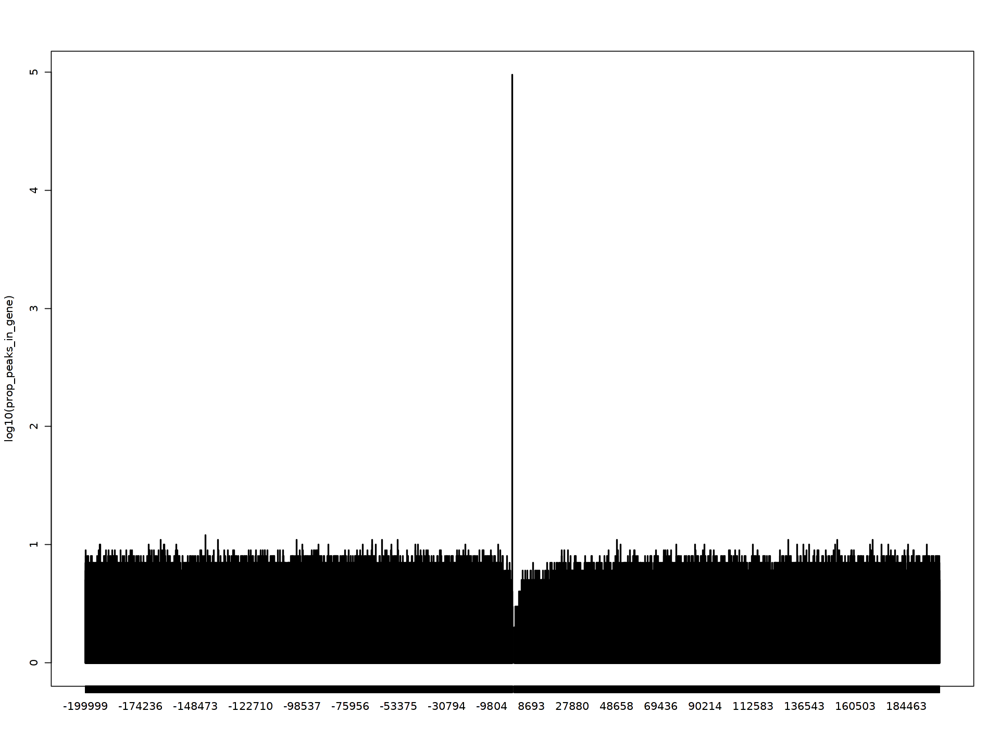

In [40]:
plot(log10(prop_peaks_in_gene), xlim=c(-200000,200000))

In [47]:
data <- data.frame(
  category=c("Promoter", "Distal_in", "Distal_out", "Intergenic"),
  count=c(length(annotated_peaks[annotated_peaks$peak_type=="promoter"]), length(annotated_peaks[annotated_peaks$peak_type=="distal" & annotated_peaks$distance==0]), length(annotated_peaks[annotated_peaks$peak_type=="distal" & annotated_peaks$distance!=0]), length(annotated_peaks[annotated_peaks$peak_type=="intergenic"]))
)

In [48]:
data

category,count
<chr>,<int>
Promoter,20611
Distal_in,94958
Distal_out,844757
Intergenic,16623


In [ ]:
data$fraction <- data$count / sum(data$count)
data$ymax <- cumsum(data$fraction)
data$ymin <- c(0, head(data$ymax, n=-1))
data$labelPosition <- (data$ymax + data$ymin) / 2
data$label <- paste0(data$category, "\n value: ", data$count)

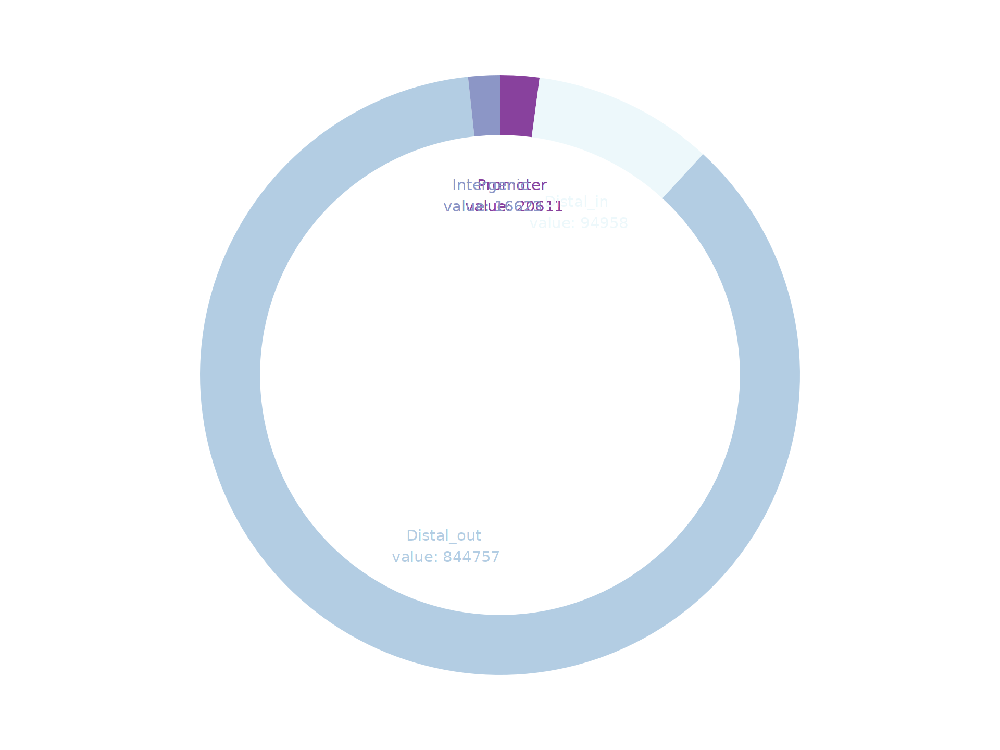

In [50]:
ggplot(data, aes(ymax=ymax, ymin=ymin, xmax=4, xmin=3, fill=category)) +
  geom_rect() +
  geom_text(x=2, aes(y=labelPosition, label=label, color=category), size=6) + # x here controls label position (inner / outer)
  scale_fill_brewer(palette=3) +
  scale_color_brewer(palette=3) +
  coord_polar(theta="y") +
  xlim(c(-1, 4)) +
  theme_void() +
  theme(legend.position = "none")

##### 4.2.3.6 Export to tsv file

In [68]:
names(annotated_peaks) <- NULL
df_annotated_peaks <- as.data.frame(annotated_peaks)
df_annotated_peaks$width <- NULL
df_annotated_peaks$strand <- NULL

In [70]:
colnames(df_annotated_peaks) <- c("chrom", "start", "end", "gene", "distance", "peak_type")

In [71]:
df_annotated_peaks[is.na(df_annotated_peaks)] <- ""

In [73]:
write.table(df_annotated_peaks, file=paste0(OS_path_outputs, "atac_peak_annotation.tsv"), row.names = FALSE, quote=FALSE, sep='\t', col.names = TRUE)

[Save](#X.1-Savings)

## 5. Gene accessibility

In [37]:
DefaultAssay(MORNAATACC) <- "peaks"

In [38]:
gene.activities <- GeneActivity(MORNAATACC, assay = 'peaks', extend.upstream = 500, extend.downstream = 0, biotypes = NULL)

Extracting gene coordinates

Extracting reads overlapping genomic regions



In [39]:
MORNAATACC[['GenePromAcc']] <- CreateAssayObject(counts = gene.activities)

In [40]:
DefaultAssay(MORNAATACC) <- "GenePromAcc"

In [41]:
MORNAATACC <- NormalizeData(MORNAATACC, assay = 'GenePromAcc', normalization.method = 'LogNormalize', scale.factor = 10000)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[Save](#X.1-Savings)

## 6. Doublets detection

### 6.1 Doublets in RNA using DoubletFinder

In [43]:
DefaultAssay(MORNAATACC) <- "RNA"

In [44]:
tmp_doublets.list <- SplitObject(MORNAATACC, split.by = "orig.ident")

In [45]:
tmp_doublets.list <- lapply(X = tmp_doublets.list, FUN = function(x) {
    DefaultAssay(x) <- "RNA"
    x <- NormalizeData(x, normalization.method = "LogNormalize", scale.factor = 10000)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 1000)
    x <- ScaleData(x, features = rownames(x))
    x <- RunPCA(x)
    x <- FindNeighbors(x, dims = 1:15)              
    x <- FindClusters(x, resolution = 0.5)
    x <- RunUMAP(x, reduction = "pca", dims = 1:15)
})

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Centering and scaling data matrix

  |======================================================================| 100%
PC_ 1 
Positive:  Slc4a4, Gpc5, Ntm, Trpm3, Sparcl1, Gm3764, Lgi1, Rora, Slc1a2, Atp1a2 
	   Ptprz1, Slc39a12, Pitpnc1, Gja1, Gabrb1, Nebl, Slc7a10, Kcnd2, Atp1b2, Aqp4 
	   Nrxn1, Fat3, Rgs6, Pla2g7, Syne1, Slc6a11, Rmst, Gpr37l1, Serpine2, Utrn 
Negative:  Apod, Ptgds, Tenm2, Gsn, Grm

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8534
Number of edges: 290863

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8352
Number of communities: 11
Elapsed time: 1 seconds


Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
18:58:05 UMAP embedding parameters a = 0.9922 b = 1.112

18:58:05 Read 8534 rows and found 15 numeric columns

18:58:05 Using Annoy for neighbor search, n_neighbors = 30

18:58:05 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

18:58:07 Writing NN index file to temp file /tmp/Rtmpylfze0/file547fd5b0adc

18:58:07 Searching Annoy index using 1 thread, search_k = 3000

18:58:09 Annoy recall = 100%

18:58:15 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 7059
Number of edges: 245178

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8422
Number of communities: 13
Elapsed time: 0 seconds


18:58:59 UMAP embedding parameters a = 0.9922 b = 1.112

18:58:59 Read 7059 rows and found 15 numeric columns

18:58:59 Using Annoy for neighbor search, n_neighbors = 30

18:58:59 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

18:58:59 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f5994aa04

18:58:59 Searching Annoy index using 1 thread, search_k = 3000

18:59:02 Annoy recall = 100%

18:59:05 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

18:59:11 Initializing from normalized Laplacian + noise (using RSpectra)

18:59:11 Commencing optimization for 500 epochs, with 293940 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
***

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 7443
Number of edges: 269515

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8541
Number of communities: 12
Elapsed time: 0 seconds


18:59:48 UMAP embedding parameters a = 0.9922 b = 1.112

18:59:48 Read 7443 rows and found 15 numeric columns

18:59:48 Using Annoy for neighbor search, n_neighbors = 30

18:59:48 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

18:59:49 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f23f5d4b6

18:59:49 Searching Annoy index using 1 thread, search_k = 3000

18:59:51 Annoy recall = 100%

18:59:55 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:00:00 Initializing from normalized Laplacian + noise (using RSpectra)

19:00:00 Commencing optimization for 500 epochs, with 316412 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
***

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11138
Number of edges: 382060

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8844
Number of communities: 13
Elapsed time: 1 seconds


19:00:56 UMAP embedding parameters a = 0.9922 b = 1.112

19:00:56 Read 11138 rows and found 15 numeric columns

19:00:56 Using Annoy for neighbor search, n_neighbors = 30

19:00:56 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:00:58 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f13ff806e

19:00:58 Searching Annoy index using 1 thread, search_k = 3000

19:01:02 Annoy recall = 100%

19:01:06 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:01:12 Found 2 connected components, 
falling back to 'spca' initialization with init_sdev = 1

19:01:12 Using 'irlba' for PCA

19:01:12 PCA: 2 components explained 53.45% variance

19:01:12 Scaling init to sdev = 1

19:01:12 Commencing optimization for 200 epochs, with 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2166
Number of edges: 81646

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8159
Number of communities: 8
Elapsed time: 0 seconds


19:01:27 UMAP embedding parameters a = 0.9922 b = 1.112

19:01:27 Read 2166 rows and found 15 numeric columns

19:01:27 Using Annoy for neighbor search, n_neighbors = 30

19:01:27 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:01:27 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f4549667e

19:01:27 Searching Annoy index using 1 thread, search_k = 3000

19:01:28 Annoy recall = 100%

19:01:31 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:01:36 Initializing from normalized Laplacian + noise (using RSpectra)

19:01:36 Commencing optimization for 500 epochs, with 91972 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
****

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4225
Number of edges: 144283

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8497
Number of communities: 11
Elapsed time: 0 seconds


19:01:55 UMAP embedding parameters a = 0.9922 b = 1.112

19:01:55 Read 4225 rows and found 15 numeric columns

19:01:55 Using Annoy for neighbor search, n_neighbors = 30

19:01:55 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:01:56 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f7d493c7

19:01:56 Searching Annoy index using 1 thread, search_k = 3000

19:01:58 Annoy recall = 100%

19:02:01 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:02:06 Initializing from normalized Laplacian + noise (using RSpectra)

19:02:06 Commencing optimization for 500 epochs, with 179758 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
****

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10639
Number of edges: 361243

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8565
Number of communities: 9
Elapsed time: 1 seconds


19:02:53 UMAP embedding parameters a = 0.9922 b = 1.112

19:02:53 Read 10639 rows and found 15 numeric columns

19:02:53 Using Annoy for neighbor search, n_neighbors = 30

19:02:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:02:54 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f5afa8c03

19:02:55 Searching Annoy index using 1 thread, search_k = 3000

19:02:58 Annoy recall = 100%

19:03:03 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:03:08 Initializing from normalized Laplacian + noise (using RSpectra)

19:03:08 Commencing optimization for 200 epochs, with 442884 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|-

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3239
Number of edges: 124589

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8431
Number of communities: 7
Elapsed time: 0 seconds


19:03:27 UMAP embedding parameters a = 0.9922 b = 1.112

19:03:27 Read 3239 rows and found 15 numeric columns

19:03:27 Using Annoy for neighbor search, n_neighbors = 30

19:03:27 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
***************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:03:28 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f4e9a38ce

19:03:28 Searching Annoy index using 1 thread, search_k = 3000

19:03:29 Annoy recall = 100%

19:03:32 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:03:37 Initializing from normalized Laplacian + noise (using RSpectra)

19:03:37 Commencing optimization for 500 epochs, with 139882 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4535
Number of edges: 157110

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8496
Number of communities: 12
Elapsed time: 0 seconds


19:04:00 UMAP embedding parameters a = 0.9922 b = 1.112

19:04:00 Read 4535 rows and found 15 numeric columns

19:04:00 Using Annoy for neighbor search, n_neighbors = 30

19:04:00 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:04:01 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f28072009

19:04:01 Searching Annoy index using 1 thread, search_k = 3000

19:04:02 Annoy recall = 100%

19:04:06 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:04:10 Initializing from normalized Laplacian + noise (using RSpectra)

19:04:11 Commencing optimization for 500 epochs, with 190604 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
***

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4851
Number of edges: 158986

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8420
Number of communities: 9
Elapsed time: 0 seconds


19:04:37 UMAP embedding parameters a = 0.9922 b = 1.112

19:04:37 Read 4851 rows and found 15 numeric columns

19:04:37 Using Annoy for neighbor search, n_neighbors = 30

19:04:37 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:04:38 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f3af2d006

19:04:38 Searching Annoy index using 1 thread, search_k = 3000

19:04:39 Annoy recall = 100%

19:04:43 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:04:48 Initializing from normalized Laplacian + noise (using RSpectra)

19:04:49 Commencing optimization for 500 epochs, with 189478 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4111
Number of edges: 138779

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8567
Number of communities: 11
Elapsed time: 0 seconds


19:05:11 UMAP embedding parameters a = 0.9922 b = 1.112

19:05:11 Read 4111 rows and found 15 numeric columns

19:05:11 Using Annoy for neighbor search, n_neighbors = 30

19:05:11 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
********************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:05:11 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f524d476f

19:05:11 Searching Annoy index using 1 thread, search_k = 3000

19:05:13 Annoy recall = 100%

19:05:16 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:05:21 Initializing from normalized Laplacian + noise (using RSpectra)

19:05:21 Commencing optimization for 500 epochs, with 164610 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10116
Number of edges: 351342

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8604
Number of communities: 13
Elapsed time: 1 seconds


19:06:06 UMAP embedding parameters a = 0.9922 b = 1.112

19:06:06 Read 10116 rows and found 15 numeric columns

19:06:06 Using Annoy for neighbor search, n_neighbors = 30

19:06:06 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:06:07 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f41c01323

19:06:07 Searching Annoy index using 1 thread, search_k = 3000

19:06:11 Annoy recall = 100%

19:06:15 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:06:20 Initializing from normalized Laplacian + noise (using RSpectra)

19:06:20 Commencing optimization for 200 epochs, with 430380 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|-

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8262
Number of edges: 290385

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8412
Number of communities: 11
Elapsed time: 1 seconds


19:07:00 UMAP embedding parameters a = 0.9922 b = 1.112

19:07:00 Read 8262 rows and found 15 numeric columns

19:07:00 Using Annoy for neighbor search, n_neighbors = 30

19:07:00 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:07:01 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f3146073e

19:07:01 Searching Annoy index using 1 thread, search_k = 3000

19:07:04 Annoy recall = 100%

19:07:08 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:07:13 Initializing from normalized Laplacian + noise (using RSpectra)

19:07:13 Commencing optimization for 500 epochs, with 354082 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5822
Number of edges: 209321

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8821
Number of communities: 13
Elapsed time: 0 seconds


19:07:44 UMAP embedding parameters a = 0.9922 b = 1.112

***************|
19:07:44 Read 5822 rows and found 15 numeric columns

19:07:44 Using Annoy for neighbor search, n_neighbors = 30

19:07:44 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:07:45 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f46799fda

19:07:45 Searching Annoy index using 1 thread, search_k = 3000

19:07:47 Annoy recall = 100%

19:07:50 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:07:55 Found 2 connected components, 
falling back to 'spca' initialization with init_sdev = 1

19:07:55 Using 'irlba' for PCA

19:07:55 PCA: 2 components explained 47.41% variance

19:07:55 Scaling init to sdev = 1

19:07:55 Commencing optimization for 500 epoc

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 6253
Number of edges: 223782

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8444
Number of communities: 12
Elapsed time: 0 seconds


19:08:27 UMAP embedding parameters a = 0.9922 b = 1.112

19:08:27 Read 6253 rows and found 15 numeric columns

19:08:27 Using Annoy for neighbor search, n_neighbors = 30

19:08:27 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:08:28 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f64448db0

19:08:28 Searching Annoy index using 1 thread, search_k = 3000

19:08:30 Annoy recall = 100%

19:08:33 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:08:38 Initializing from normalized Laplacian + noise (using RSpectra)

19:08:39 Commencing optimization for 500 epochs, with 267572 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4329
Number of edges: 152530

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8478
Number of communities: 9
Elapsed time: 0 seconds


19:09:04 UMAP embedding parameters a = 0.9922 b = 1.112

19:09:04 Read 4329 rows and found 15 numeric columns

19:09:04 Using Annoy for neighbor search, n_neighbors = 30

19:09:04 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:09:05 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f5817586b

19:09:05 Searching Annoy index using 1 thread, search_k = 3000

19:09:06 Annoy recall = 100%

19:09:10 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:09:15 Initializing from normalized Laplacian + noise (using RSpectra)

19:09:15 Commencing optimization for 500 epochs, with 179548 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
***

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8437
Number of edges: 300976

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8343
Number of communities: 8
Elapsed time: 1 seconds


19:09:55 UMAP embedding parameters a = 0.9922 b = 1.112

19:09:55 Read 8437 rows and found 15 numeric columns

19:09:55 Using Annoy for neighbor search, n_neighbors = 30

19:09:55 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:09:56 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f3cd43ff9

19:09:56 Searching Annoy index using 1 thread, search_k = 3000

19:09:59 Annoy recall = 100%

19:10:03 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:10:08 Initializing from normalized Laplacian + noise (using RSpectra)

19:10:08 Commencing optimization for 500 epochs, with 355970 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3438
Number of edges: 120315

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8195
Number of communities: 8
Elapsed time: 0 seconds


19:10:32 UMAP embedding parameters a = 0.9922 b = 1.112

19:10:32 Read 3438 rows and found 15 numeric columns

19:10:32 Using Annoy for neighbor search, n_neighbors = 30

19:10:32 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
********************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:10:32 Writing NN index file to temp file /tmp/Rtmpylfze0/file547fabf024b

19:10:32 Searching Annoy index using 1 thread, search_k = 3000

19:10:33 Annoy recall = 100%

19:10:37 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:10:42 Initializing from normalized Laplacian + noise (using RSpectra)

19:10:42 Commencing optimization for 500 epochs, with 144752 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|---

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3759
Number of edges: 133426

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8363
Number of communities: 9
Elapsed time: 0 seconds


19:11:01 UMAP embedding parameters a = 0.9922 b = 1.112

19:11:01 Read 3759 rows and found 15 numeric columns

19:11:01 Using Annoy for neighbor search, n_neighbors = 30

19:11:01 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:11:02 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f5c870a21

19:11:02 Searching Annoy index using 1 thread, search_k = 3000

19:11:03 Annoy recall = 100%

19:11:06 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:11:11 Initializing from normalized Laplacian + noise (using RSpectra)

19:11:11 Commencing optimization for 500 epochs, with 157756 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
***

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 7069
Number of edges: 248426

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8502
Number of communities: 11
Elapsed time: 0 seconds


19:11:45 UMAP embedding parameters a = 0.9922 b = 1.112

19:11:45 Read 7069 rows and found 15 numeric columns

19:11:45 Using Annoy for neighbor search, n_neighbors = 30

19:11:45 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
**********|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:11:46 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f4244b93e

19:11:46 Searching Annoy index using 1 thread, search_k = 3000

19:11:49 Annoy recall = 100%

19:11:53 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:11:58 Initializing from normalized Laplacian + noise (using RSpectra)

19:11:58 Commencing optimization for 500 epochs, with 295174 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 6549
Number of edges: 237093

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8661
Number of communities: 12
Elapsed time: 0 seconds


19:12:36 UMAP embedding parameters a = 0.9922 b = 1.112

19:12:36 Read 6549 rows and found 15 numeric columns

19:12:36 Using Annoy for neighbor search, n_neighbors = 30

19:12:36 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:12:36 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f12433af3

19:12:36 Searching Annoy index using 1 thread, search_k = 3000

19:12:39 Annoy recall = 100%

19:12:43 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:12:47 Initializing from normalized Laplacian + noise (using RSpectra)

19:12:48 Commencing optimization for 500 epochs, with 276024 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
***

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1777
Number of edges: 60115

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8418
Number of communities: 9
Elapsed time: 0 seconds


19:13:04 UMAP embedding parameters a = 0.9922 b = 1.112

19:13:04 Read 1777 rows and found 15 numeric columns

19:13:04 Using Annoy for neighbor search, n_neighbors = 30

19:13:04 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:13:05 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f12103dcb

19:13:05 Searching Annoy index using 1 thread, search_k = 3000

19:13:05 Annoy recall = 100%

19:13:09 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:13:14 Initializing from normalized Laplacian + noise (using RSpectra)

19:13:14 Commencing optimization for 500 epochs,

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3263
Number of edges: 124275

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8180
Number of communities: 7
Elapsed time: 0 seconds


19:13:29 UMAP embedding parameters a = 0.9922 b = 1.112

19:13:29 Read 3263 rows and found 15 numeric columns

19:13:29 Using Annoy for neighbor search, n_neighbors = 30

19:13:29 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
***************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:13:30 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f7f88d3df

19:13:30 Searching Annoy index using 1 thread, search_k = 3000

19:13:31 Annoy recall = 100%

19:13:34 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:13:39 Initializing from normalized Laplacian + noise (using RSpectra)

19:13:39 Commencing optimization for 500 epochs, with 138268 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1697
Number of edges: 53365

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8654
Number of communities: 9
Elapsed time: 0 seconds


19:13:53 UMAP embedding parameters a = 0.9922 b = 1.112

19:13:53 Read 1697 rows and found 15 numeric columns

19:13:53 Using Annoy for neighbor search, n_neighbors = 30

19:13:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:13:53 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f666cb06

19:13:53 Searching Annoy index using 1 thread, search_k = 3000

19:13:54 Annoy recall = 100%

19:13:57 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:14:02 Initializing from normalized Laplacian + noise (using RSpectra)

19:14:02 Commencing optimization for 500 epochs, 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3623
Number of edges: 133133

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8291
Number of communities: 10
Elapsed time: 0 seconds


19:14:18 UMAP embedding parameters a = 0.9922 b = 1.112

19:14:18 Read 3623 rows and found 15 numeric columns

19:14:18 Using Annoy for neighbor search, n_neighbors = 30

19:14:18 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
********************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:14:18 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f3ad18405

19:14:18 Searching Annoy index using 1 thread, search_k = 3000

19:14:20 Annoy recall = 100%

19:14:23 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:14:28 Initializing from normalized Laplacian + noise (using RSpectra)

19:14:28 Commencing optimization for 500 epochs, with 157204 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3517
Number of edges: 121555

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8489
Number of communities: 8
Elapsed time: 0 seconds


19:14:49 UMAP embedding parameters a = 0.9922 b = 1.112

19:14:49 Read 3517 rows and found 15 numeric columns

19:14:49 Using Annoy for neighbor search, n_neighbors = 30

19:14:49 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
***************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:14:50 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f24152516

19:14:50 Searching Annoy index using 1 thread, search_k = 3000

19:14:51 Annoy recall = 100%

19:14:54 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:14:59 Initializing from normalized Laplacian + noise (using RSpectra)

19:15:00 Commencing optimization for 500 epochs, with 140306 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3744
Number of edges: 127881

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8438
Number of communities: 10
Elapsed time: 0 seconds


19:15:17 UMAP embedding parameters a = 0.9922 b = 1.112

19:15:17 Read 3744 rows and found 15 numeric columns

19:15:17 Using Annoy for neighbor search, n_neighbors = 30

19:15:17 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
********************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:15:18 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f7ec518af

19:15:18 Searching Annoy index using 1 thread, search_k = 3000

19:15:19 Annoy recall = 100%

19:15:22 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:15:28 Initializing from normalized Laplacian + noise (using RSpectra)

19:15:28 Commencing optimization for 500 epochs, with 151108 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1138
Number of edges: 43613

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7961
Number of communities: 6
Elapsed time: 0 seconds


19:15:39 UMAP embedding parameters a = 0.9922 b = 1.112

19:15:39 Read 1138 rows and found 15 numeric columns

19:15:39 Using Annoy for neighbor search, n_neighbors = 30

19:15:39 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:15:39 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f7cc69b1

19:15:39 Searching Annoy index using 1 thread, search_k = 3000

19:15:39 Annoy recall = 100%

19:15:42 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:15:47 Initializing from normalized Laplacian + noise (using RSpectra)

19:15:47 Commencing optimization for 500 epochs, 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2596
Number of edges: 89899

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8260
Number of communities: 11
Elapsed time: 0 seconds


19:16:01 UMAP embedding parameters a = 0.9922 b = 1.112

19:16:01 Read 2596 rows and found 15 numeric columns

19:16:01 Using Annoy for neighbor search, n_neighbors = 30

19:16:01 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

*****|
19:16:01 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f37725269

19:16:01 Searching Annoy index using 1 thread, search_k = 3000

19:16:02 Annoy recall = 100%

19:16:05 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:16:10 Initializing from normalized Laplacian + noise (using RSpectra)

19:16:10 Commencing optimization for 500 epochs, with 108106 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4995
Number of edges: 170225

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8602
Number of communities: 13
Elapsed time: 0 seconds


19:16:34 UMAP embedding parameters a = 0.9922 b = 1.112

19:16:34 Read 4995 rows and found 15 numeric columns

19:16:34 Using Annoy for neighbor search, n_neighbors = 30

19:16:34 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*****|
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:16:35 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f348646e3

19:16:35 Searching Annoy index using 1 thread, search_k = 3000

19:16:37 Annoy recall = 100%

19:16:40 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:16:45 Initializing from normalized Laplacian + noise (using RSpectra)

19:16:46 Commencing optimization for 500 epochs, with 203364 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|--

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 477
Number of edges: 17328

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7956
Number of communities: 4
Elapsed time: 0 seconds


19:16:56 UMAP embedding parameters a = 0.9922 b = 1.112

19:16:56 Read 477 rows and found 15 numeric columns

19:16:56 Using Annoy for neighbor search, n_neighbors = 30

19:16:56 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
19:16:56 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f6860813

19:16:56 Searching Annoy index using 1 thread, search_k = 3000

19:16:57 Annoy recall = 100%

19:17:00 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

19:17:04 Initializing from normalized Laplacian + noise (using RSpectra)

19:17:04 Commencing optimization for 500 epochs, w

Loading required package: fields

Loading required package: spam

Spam version 2.10-0 (2023-10-23) is loaded.
Type 'help( Spam)' or 'demo( spam)' for a short introduction 
and overview of this package.
Help for individual functions is also obtained by adding the
suffix '.spam' to the function name, e.g. 'help( chol.spam)'.


Attaching package: 'spam'


The following object is masked from 'package:stats4':

    mle


The following objects are masked from 'package:base':

    backsolve, forwardsolve



Try help(fields) to get started.

Loading required package: parallel



[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."


Loading required package: KernSmooth

KernSmooth 2.23 loaded
Copyright M. P. Wand 1997-2009

Loading required package: ROCR



NULL
[1] "Sample :  LateCtrl2"
   ParamID    pK    MeanBC        VarBC    BCmetric
1        1 0.005 0.9086229 3.051693e-06 297743.8437
2        2  0.01 0.9048544 7.432889e-06 121736.5565
3        3  0.02 0.8999018 2.094914e-05  42956.4960
4        4  0.03 0.8929924 3.430799e-05  26028.6963
5        5  0.04 0.8864841 6.472085e-05  13697.0396
6        6  0.05 0.8786071 1.248048e-04   7039.8526
7        7  0.06 0.8697557 2.180120e-04   3989.4863
8        8  0.07 0.8588322 3.740519e-04   2296.0244
9        9  0.08 0.8366396 1.288646e-03    649.2394
10      10  0.09 0.7965055 3.359437e-03    237.0949
11      11   0.1 0.7565705 2.035182e-03    371.7459
12      12  0.11 0.7376257 1.608848e-03    458.4806
13      13  0.12 0.7255826 1.952395e-03    371.6372
14      14  0.13 0.7127831 2.365168e-03    301.3668
15      15  0.14 0.7002493 2.837430e-03    246.7900
16      16  0.15 0.6889636 3.188427e-03    216.0826
17      17  0.16 0.6802907 3.279451e-03    207.4404
18      18  0.17 0.6725118 3.3050

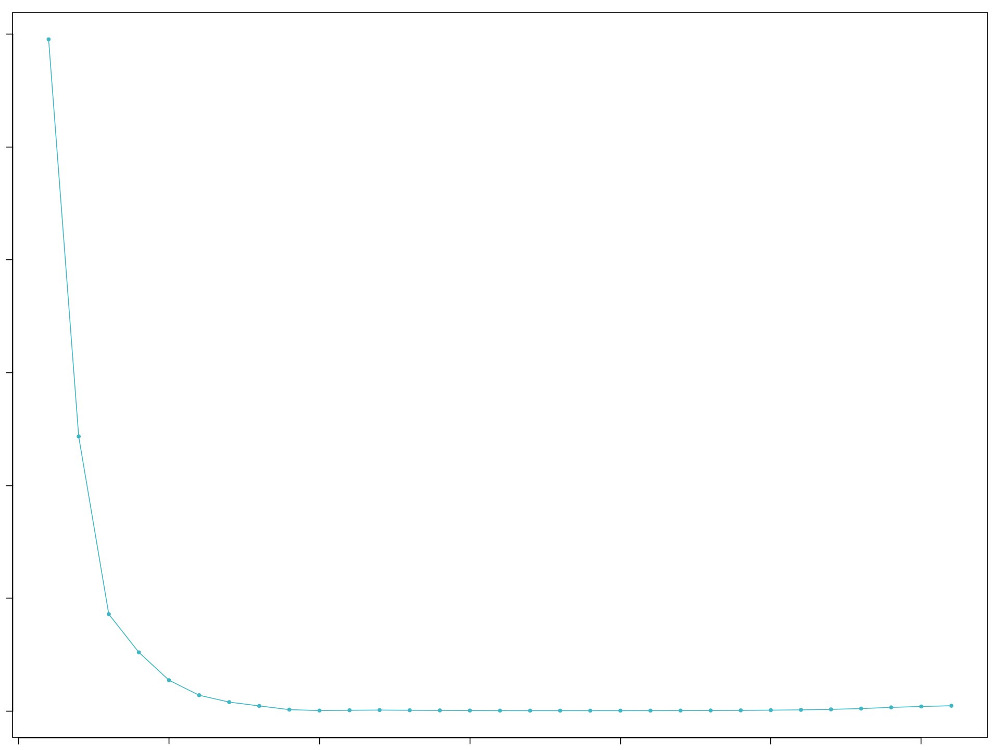

In [16]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[1]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[1]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Naive2"
   ParamID    pK    MeanBC        VarBC    BCmetric
1        1 0.005 0.9099737 4.074555e-06 223330.8522
2        2  0.01 0.9086734 9.698698e-06  93690.2498
3        3  0.02 0.8967618 1.645689e-05  54491.5764
4        4  0.03 0.8937863 1.104054e-05  80954

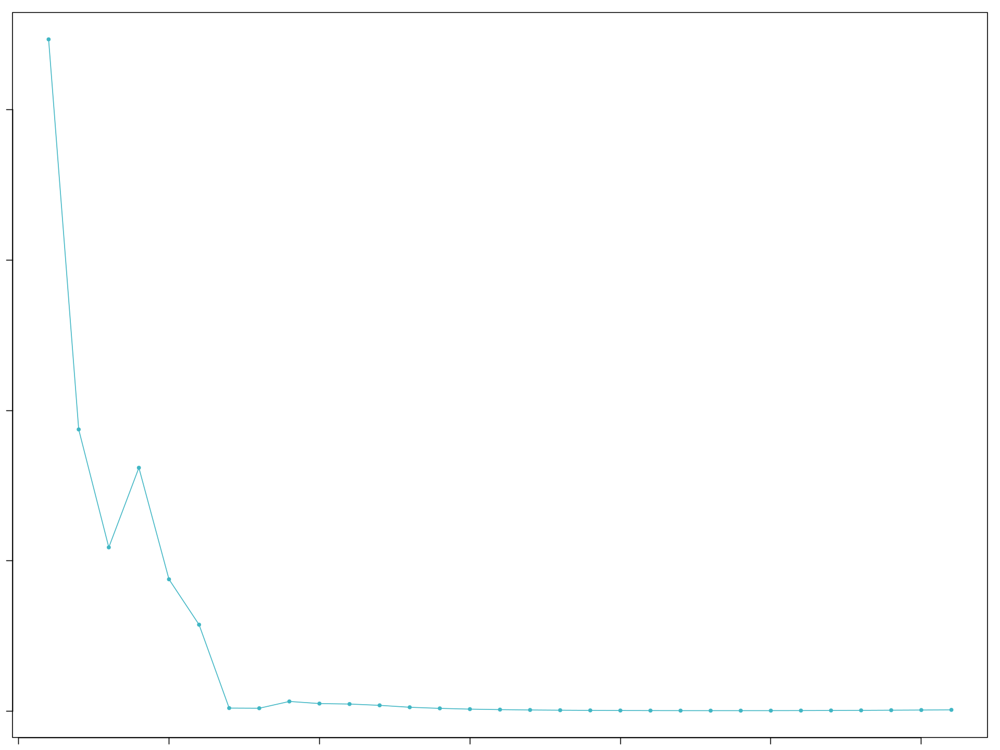

In [17]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[2]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[2]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  LateCtrl3"
   ParamID    pK    MeanBC        VarBC    BCmetric
1        1 0.005 0.9128039 5.209414e-06 175221.9906
2        2  0.01 0.9144170 1.460498e-05  62609.9534
3        3  0.02 0.9077207 3.566448e-05  25451.6706
4        4  0.03 0.9069182 5.939471e-05  15

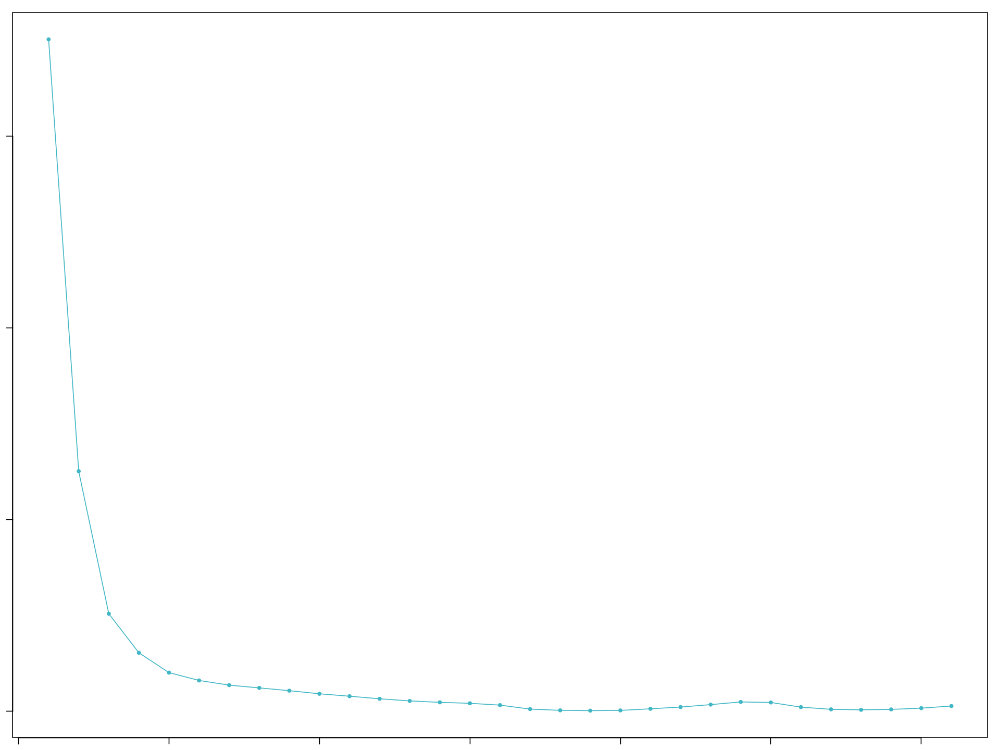

In [18]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[3]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[3]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyFemale5"
   ParamID    pK    MeanBC        VarBC     BCmetric
1        1 0.001 0.8993500 1.181932e-04   7609.15204
2        2 0.005 0.9035419 6.366405e-06 141923.42340
3        3  0.01 0.8944539 4.740445e-05  18868.56157
4        4  0.02

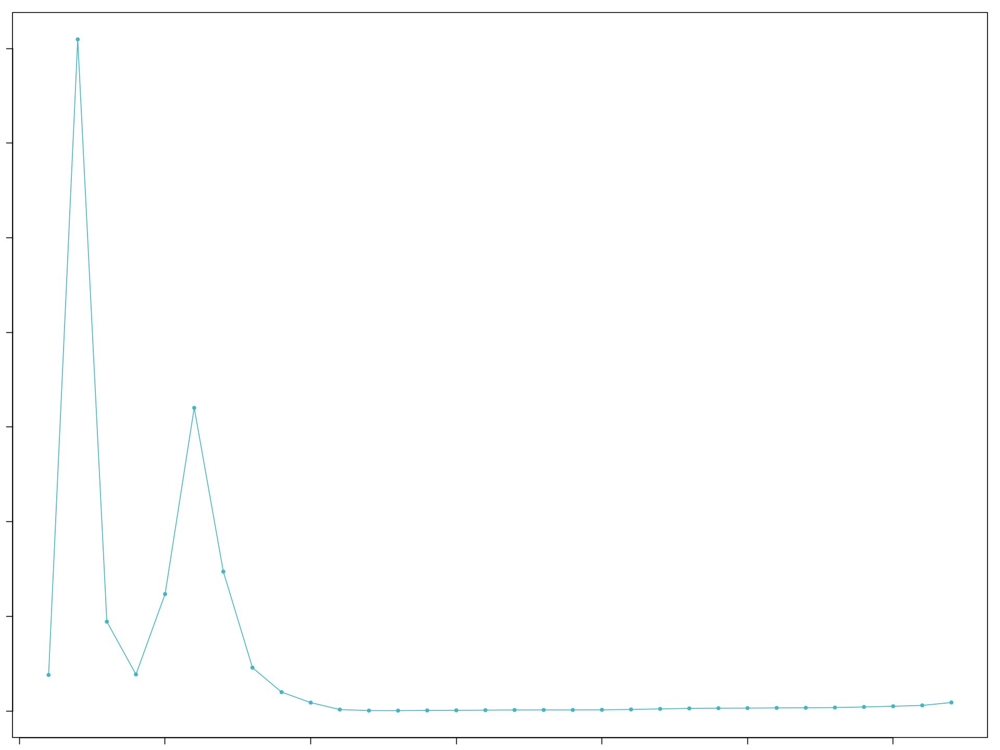

In [19]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[4]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[4]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  PeakCtrl3"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.9154642 6.218635e-05 14721.3056
2        2  0.01 0.9149084 2.356231e-05 38829.3223
3        3  0.02 0.9056116 3.095962e-05 29251.3770
4        4  0.03 0.9061722 1.657901e-05 54657.7

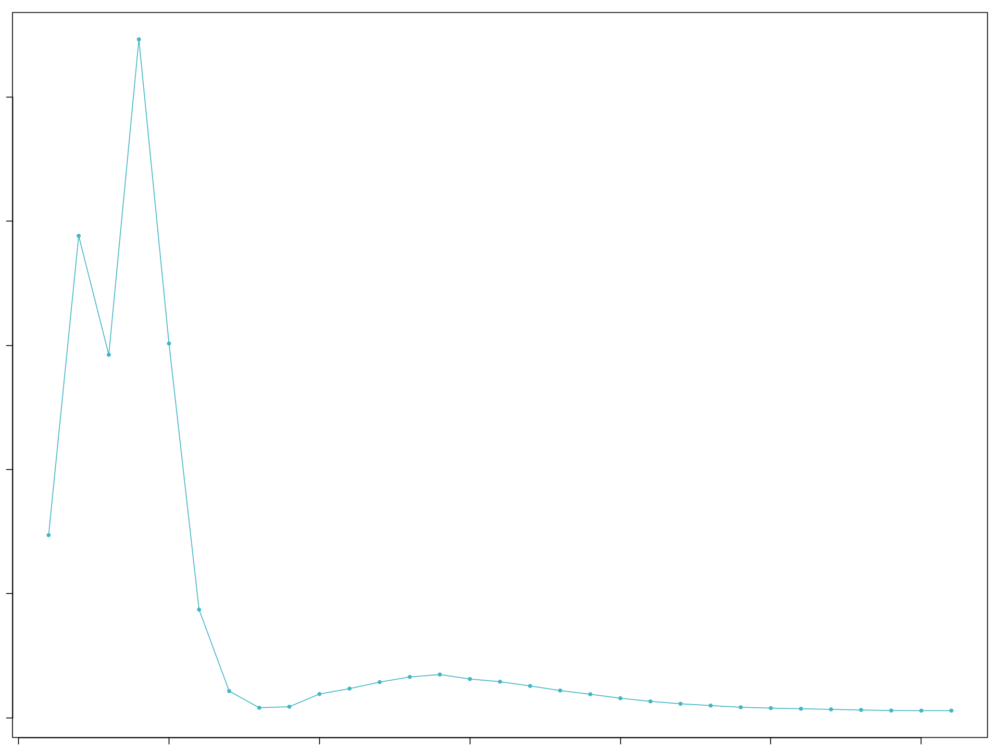

In [20]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[5]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[5]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Early1"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8907285 2.213577e-05 40239.3208
2        2  0.01 0.8875501 2.681027e-05 33104.8552
3        3  0.02 0.8801834 2.263563e-05 38884.8697
4        4  0.03 0.8712749 4.979137e-05 17498.5118

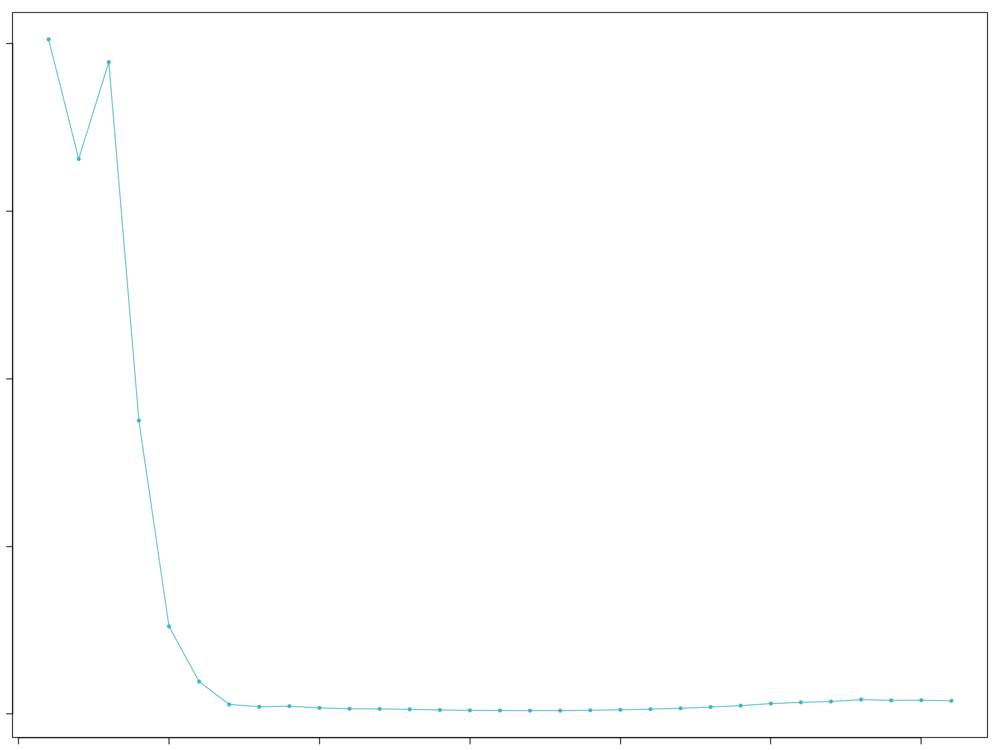

In [21]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[6]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[6]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyMale5"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.001 0.8804413 1.915367e-04  4596.7233
2        2 0.005 0.8837398 4.021353e-05 21976.1788
3        3  0.01 0.8711934 1.425109e-04  6113.1716
4        4  0.02 0.8334506

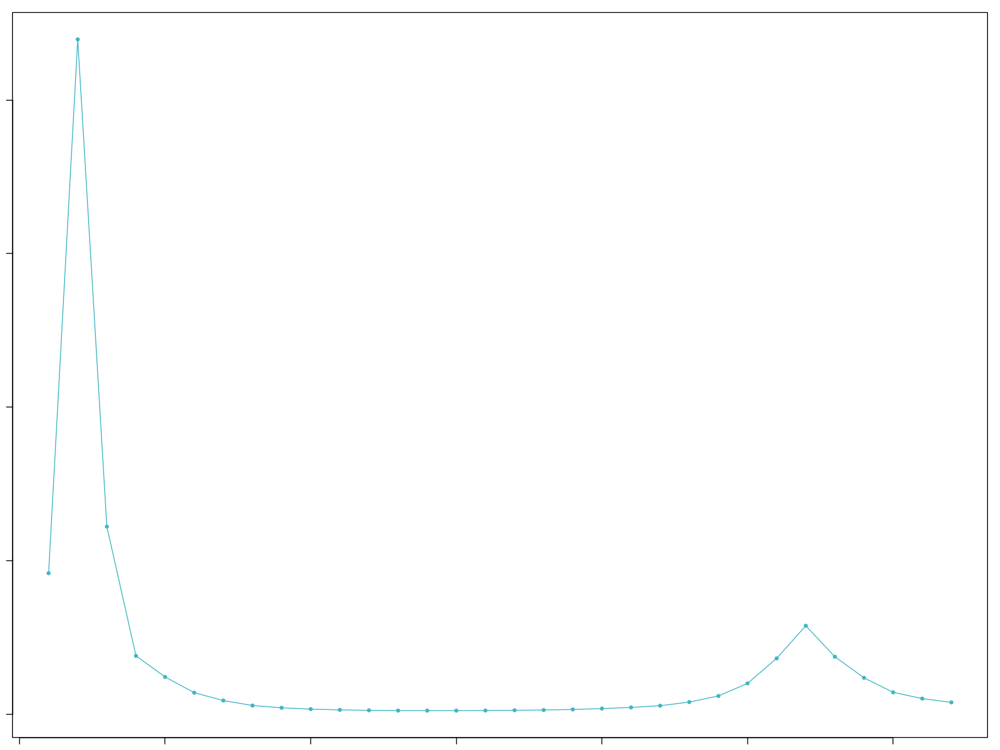

In [22]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[7]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[7]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Early4"
   ParamID    pK    MeanBC       VarBC BCmetric
1        1 0.005 0.8238811 0.001284362 641.4710
2        2  0.01 0.8248908 0.001006339 819.6950
3        3  0.02 0.7938289 0.003220647 246.4812
4        4  0.03 0.7821729 0.003808264 205.3883
5        5  0.

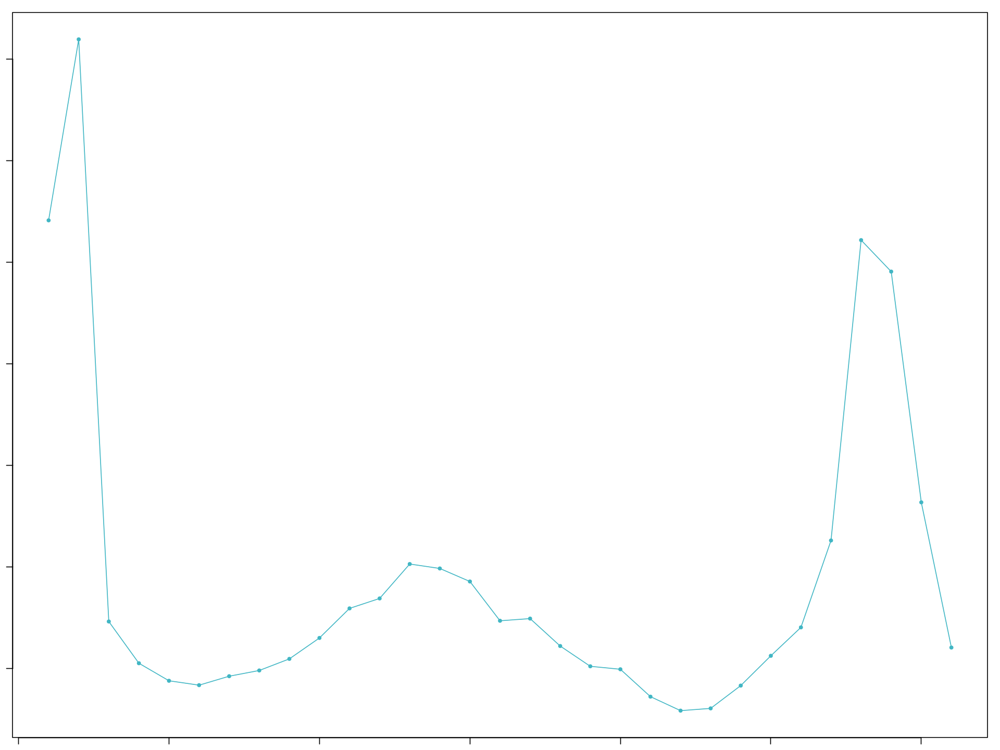

In [23]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[8]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[8]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Late1"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8655533 4.206370e-05 20577.2045
2        2  0.01 0.8559406 1.740941e-04  4916.5402
3        3  0.02 0.8220053 1.340042e-03   613.4175
4        4  0.03 0.7857358 2.560215e-03   306.9023


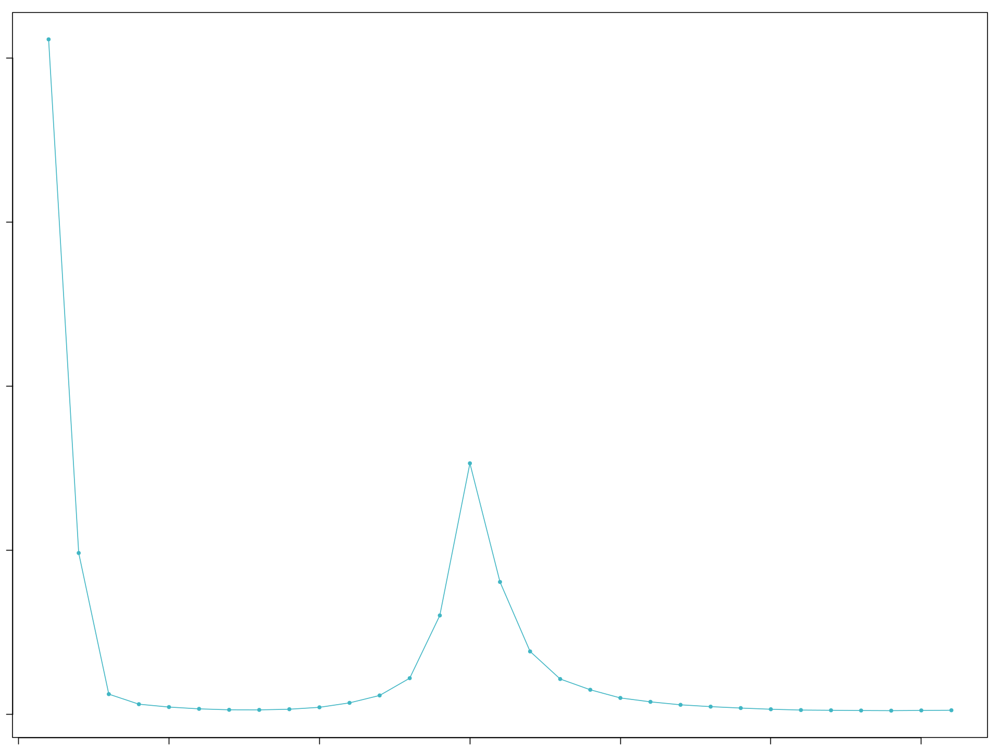

In [24]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[9]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[9]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  PeakFemale4"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8327252 6.783152e-04  1227.6376
2        2  0.01 0.8209479 1.820594e-03   450.9231
3        3  0.02 0.8015495 2.644799e-03   303.0664
4        4  0.03 0.7699150 2.488183e-03   309

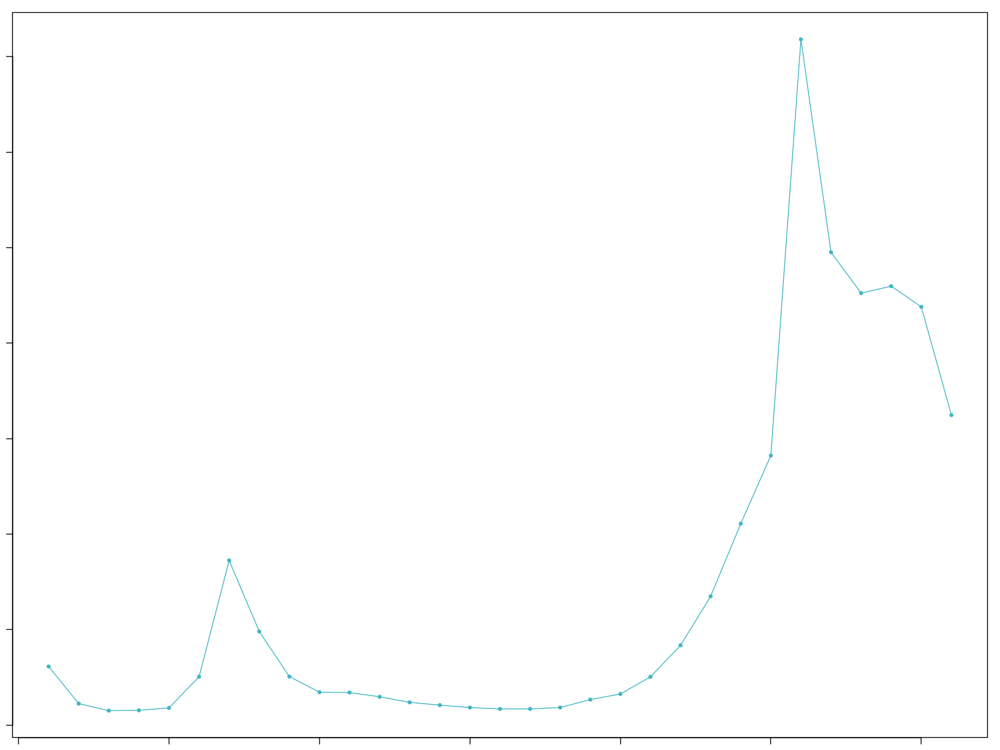

In [45]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[10]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[10]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Peak5"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8356512 2.309903e-05 36176.8902
2        2  0.01 0.8351666 5.533633e-04  1509.2556
3        3  0.02 0.8063463 2.179051e-03   370.0447
4        4  0.03 0.7920524 3.221192e-03   245.8880


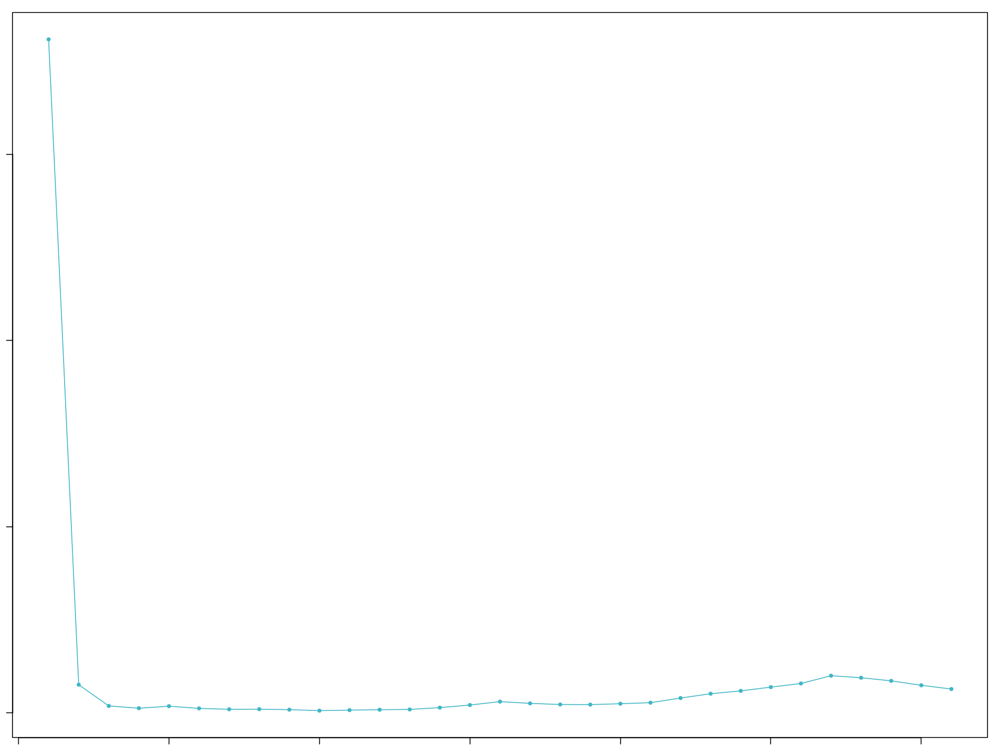

In [25]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[11]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[11]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.001..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  LateFemale4"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.001 0.8441486 0.0005476708 1541.34291
2        2 0.005 0.8583512 0.0002352641 3648.45787
3        3  0.01 0.8370685 0.0007195546 1163.31473
4        4  0.02 0.797281

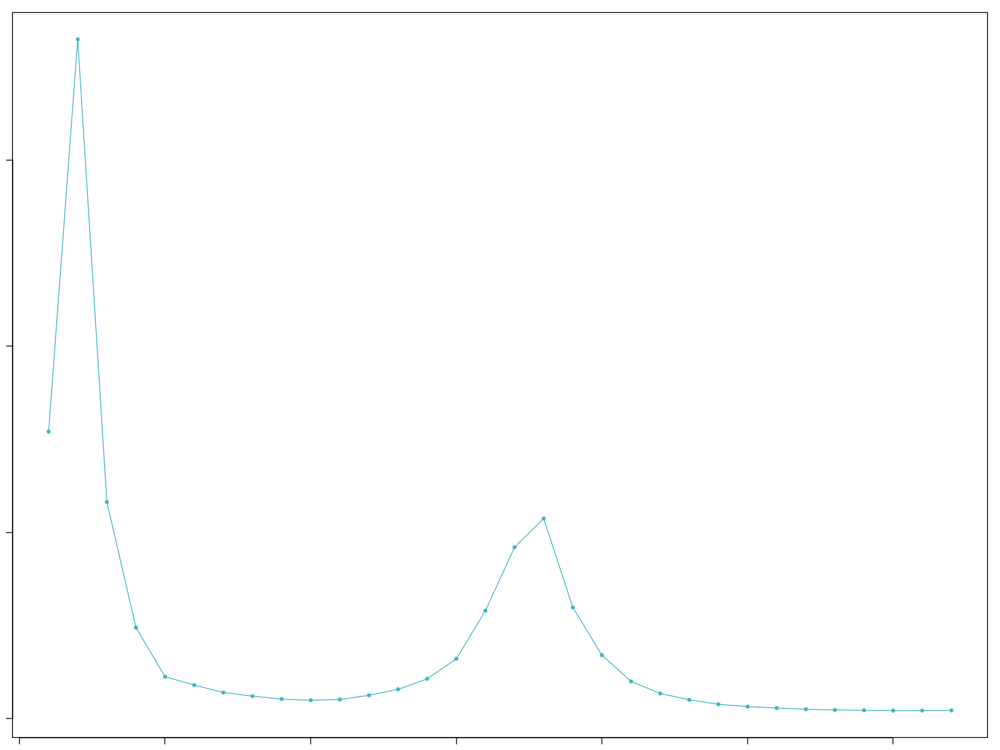

In [26]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[12]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[12]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyCtrlMale5"
   ParamID    pK    MeanBC        VarBC    BCmetric
1        1 0.005 0.9026951 8.684696e-06 103940.8999
2        2  0.01 0.8926528 7.072890e-05  12620.7653
3        3  0.02 0.8744092 1.045264e-04   8365.4395
4        4  0.03 0.8617318 1.370736e-0

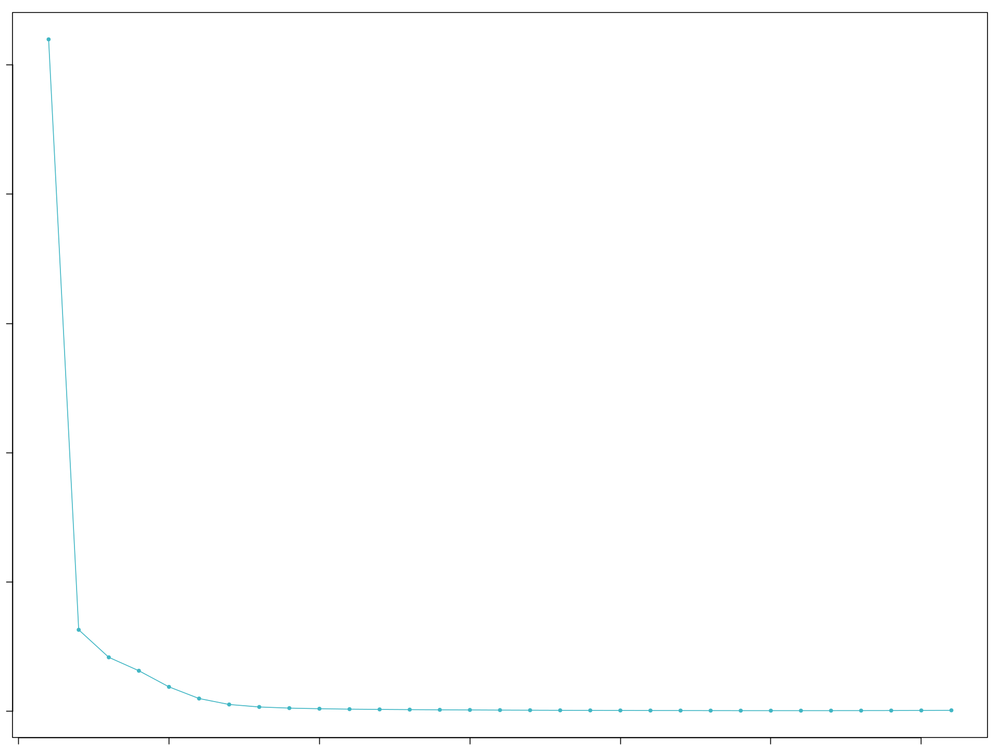

In [47]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[13]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[13]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Naive1"
   ParamID    pK    MeanBC        VarBC  BCmetric
1        1 0.005 0.8465795 0.0004286406 1975.0333
2        2  0.01 0.8400434 0.0014126552  594.6557
3        3  0.02 0.8383540 0.0028448017  294.6968
4        4  0.03 0.8301548 0.0033542769  247.4914
5   

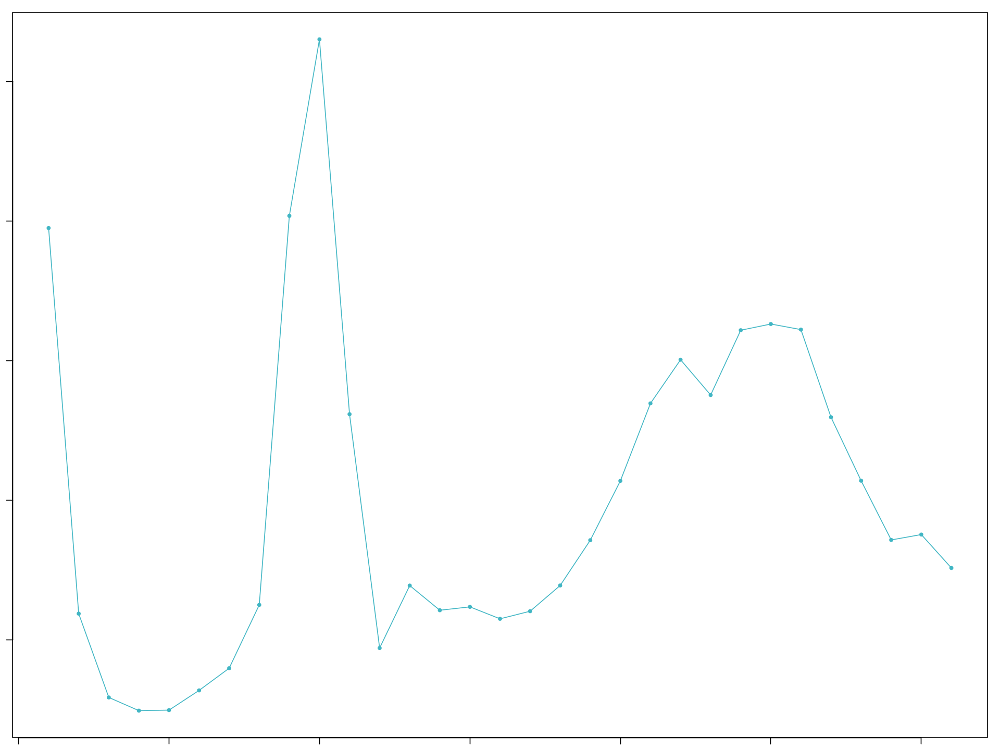

In [27]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[14]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[14]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Naive3"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.9036959 2.139949e-05 42229.7895
2        2  0.01 0.9019203 3.394429e-05 26570.6048
3        3  0.02 0.8695307 1.024308e-04  8488.9605
4        4  0.03 0.8548344 7.966560e-05 10730.2818

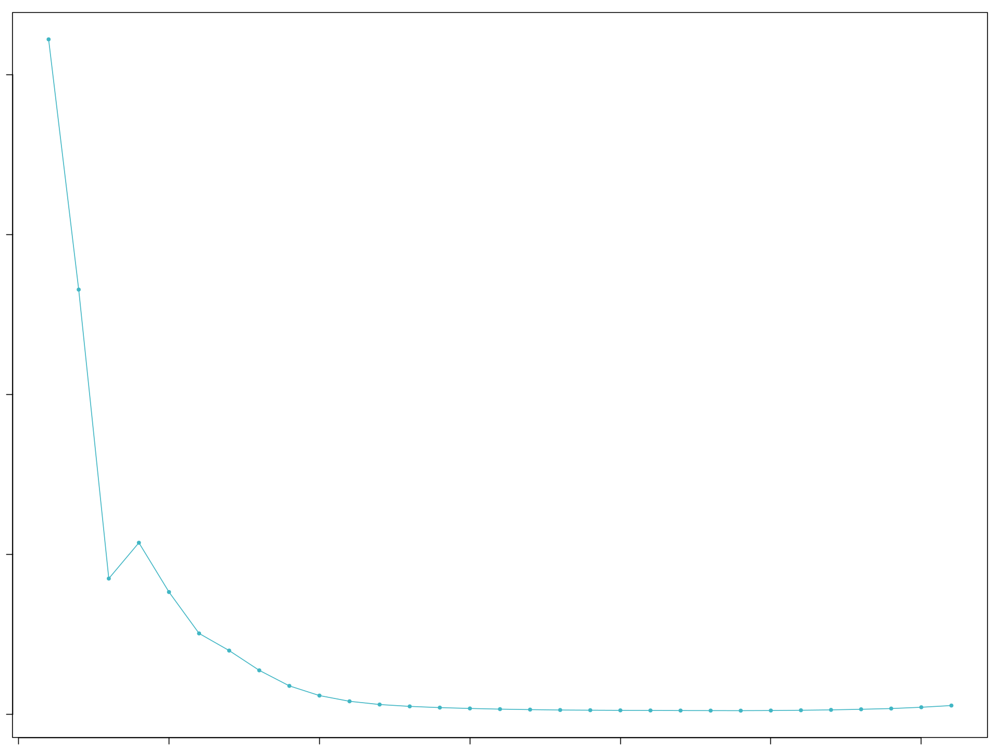

In [28]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[15]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[15]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Late3"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8875999 1.963825e-05 45197.4994
2        2  0.01 0.8830159 1.635127e-04  5400.2889
3        3  0.02 0.8663593 4.407573e-04  1965.6153
4        4  0.03 0.8490038 7.194233e-04  1180.1171


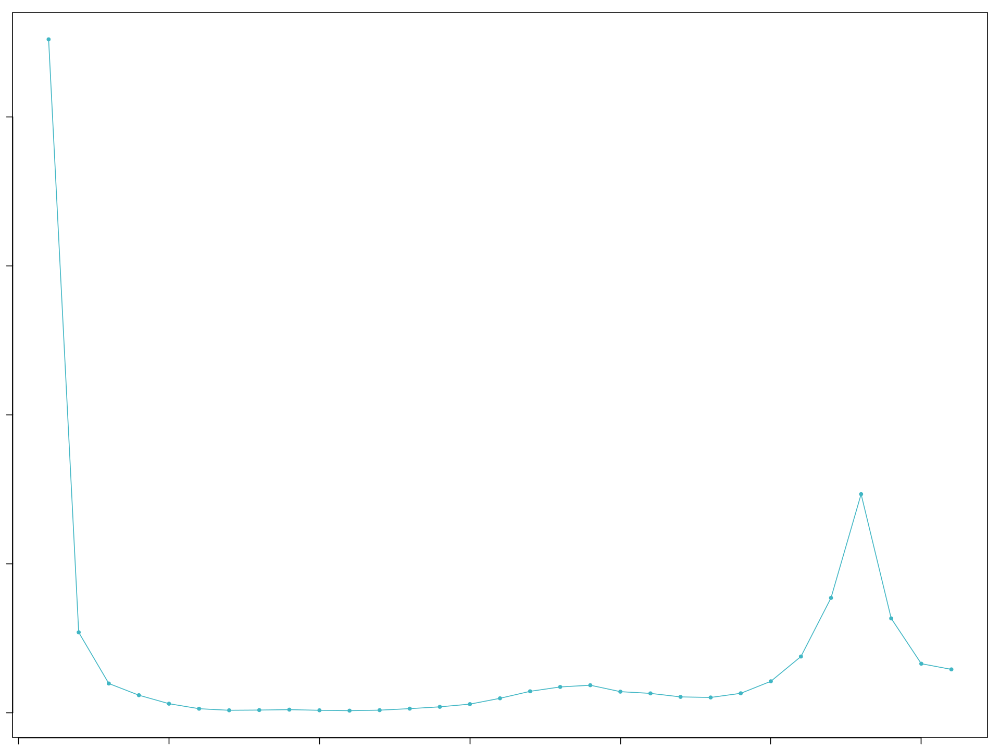

In [29]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[16]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[16]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyCtrlFemale5"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.9031153 1.865959e-05 48399.5132
2        2  0.01 0.9001636 1.144169e-05 78673.9993
3        3  0.02 0.8973334 2.735800e-05 32799.6657
4        4  0.03 0.8791217 1.601102e-04 

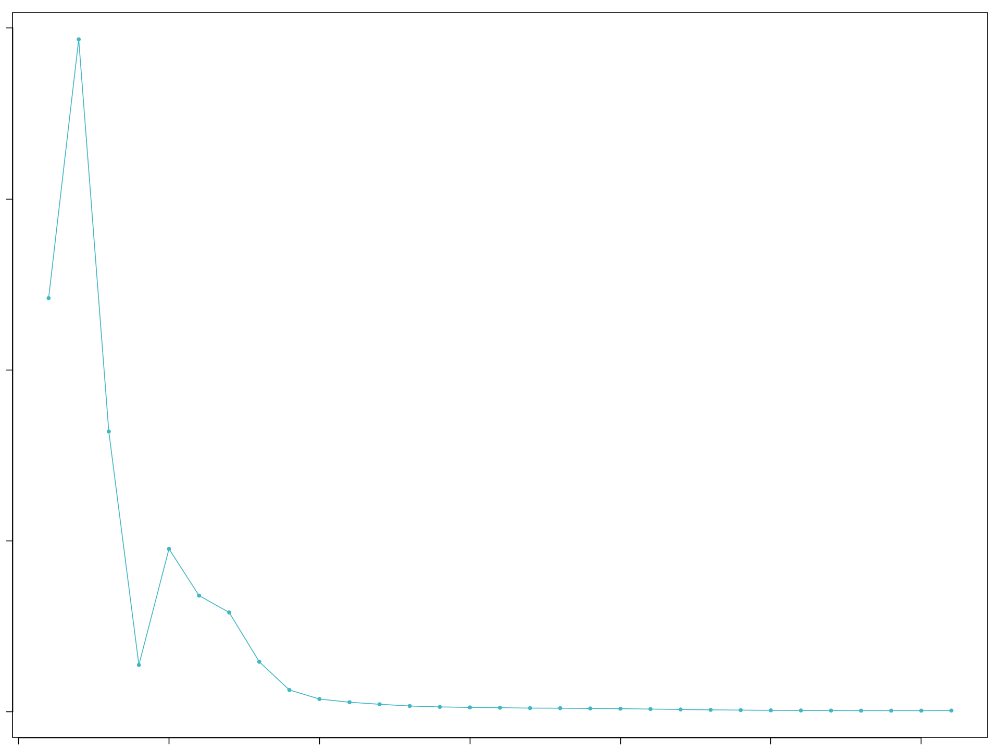

In [30]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[17]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[17]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyFemale3"
   ParamID    pK    MeanBC        VarBC  BCmetric
1        1 0.005 0.8775696 0.0001029700 8522.5779
2        2  0.01 0.8714120 0.0001199589 7264.2526
3        3  0.02 0.8636342 0.0002456428 3515.8136
4        4  0.03 0.8529997 0.0003074626 2774.320

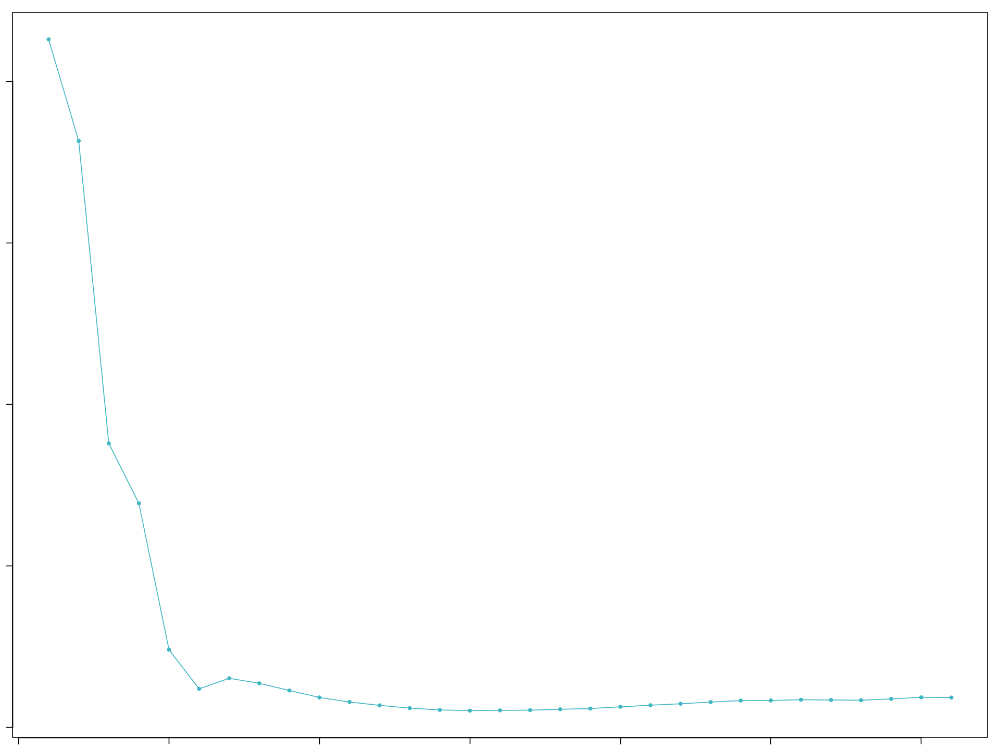

In [31]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[18]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[18]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyMale3"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8693931 4.906454e-05 17719.3795
2        2  0.01 0.8621516 2.333687e-04  3694.3751
3        3  0.02 0.8425189 4.695698e-04  1794.2358
4        4  0.03 0.8242107 9.378175e-04   878.

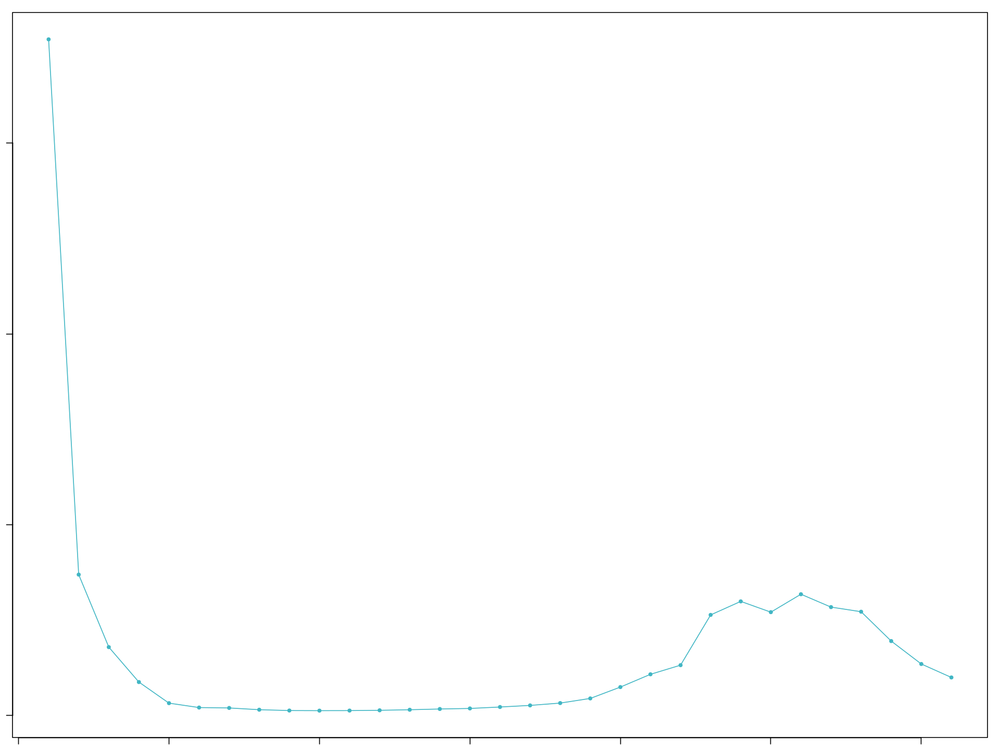

In [32]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[19]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[19]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyCtrl4"
   ParamID    pK    MeanBC        VarBC    BCmetric
1        1 0.005 0.9091689 3.287177e-06 276580.4565
2        2  0.01 0.9042567 1.482930e-05  60977.7202
3        3  0.02 0.8965609 9.751616e-05   9193.9725
4        4  0.03 0.8531210 1.100079e-03   

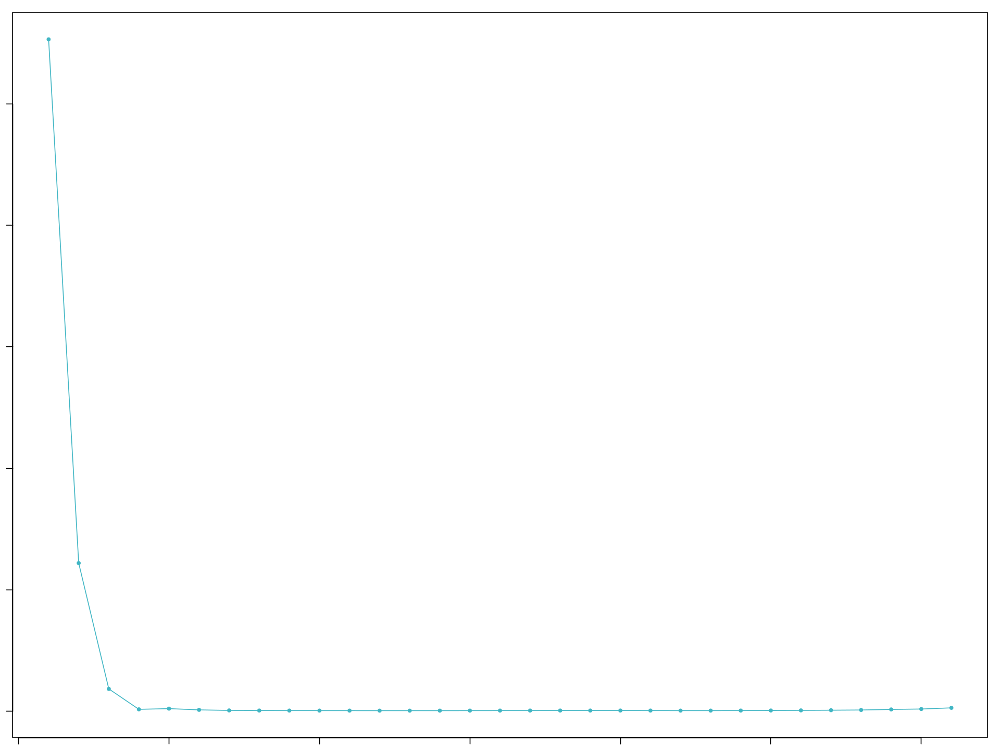

In [33]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[20]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[20]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Late5"
   ParamID    pK    MeanBC        VarBC  BCmetric
1        1 0.005 0.8780435 0.0001255888 6991.4130
2        2  0.01 0.8593791 0.0003976166 2161.3257
3        3  0.02 0.8282639 0.0009767508  847.9787
4        4  0.03 0.8059981 0.0017686900  455.7034
5    

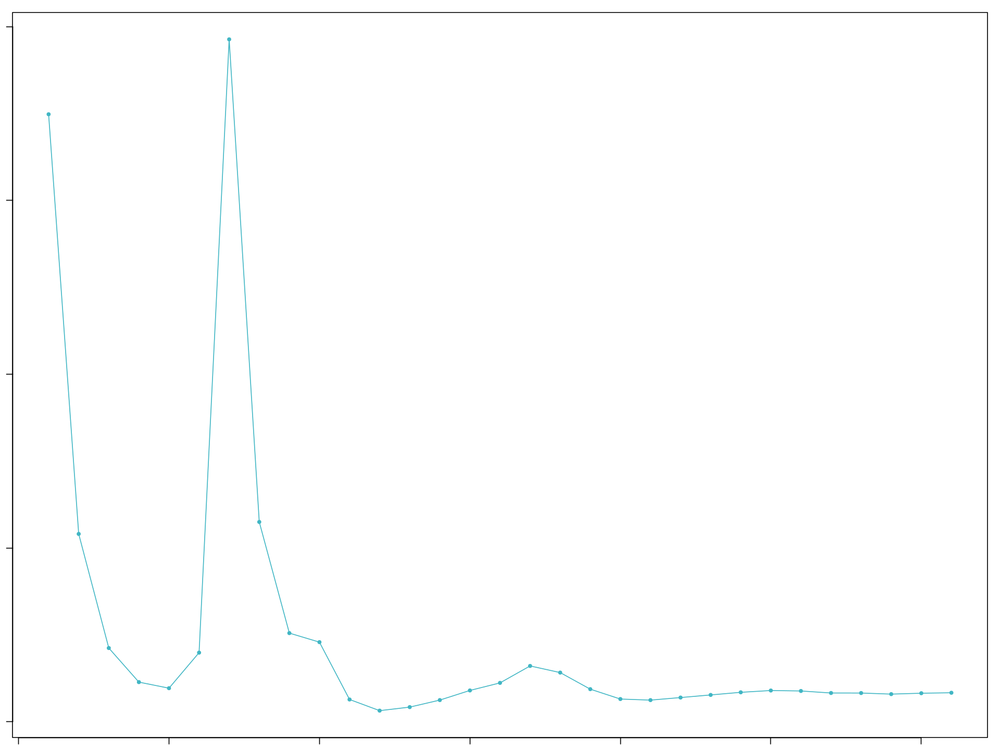

In [34]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[21]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[21]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Peak2"
   ParamID   pK    MeanBC        VarBC   BCmetric
1        1 0.01 0.8364781 0.0005347913 1564.12052
2        2 0.02 0.8318975 0.0008008250 1038.80061
3        3 0.03 0.8226063 0.0010029767  820.16495
4        4 0.04 0.8036528 0.0008383492  958.61338
5        5 0.05 0.7840735

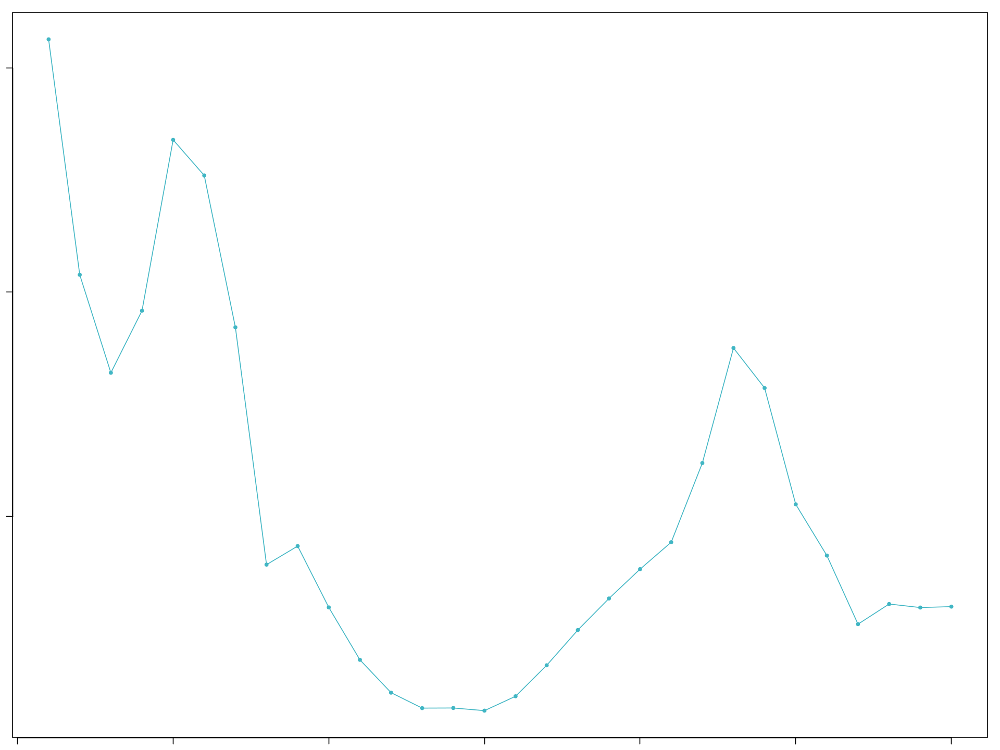

In [35]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[22]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[22]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  PeakCtrl2"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8970821 1.020817e-04  8787.8804
2        2  0.01 0.8950897 5.067473e-05 17663.4320
3        3  0.02 0.8939642 3.034722e-05 29457.8638
4        4  0.03 0.8916939 4.888217e-05 18241.7

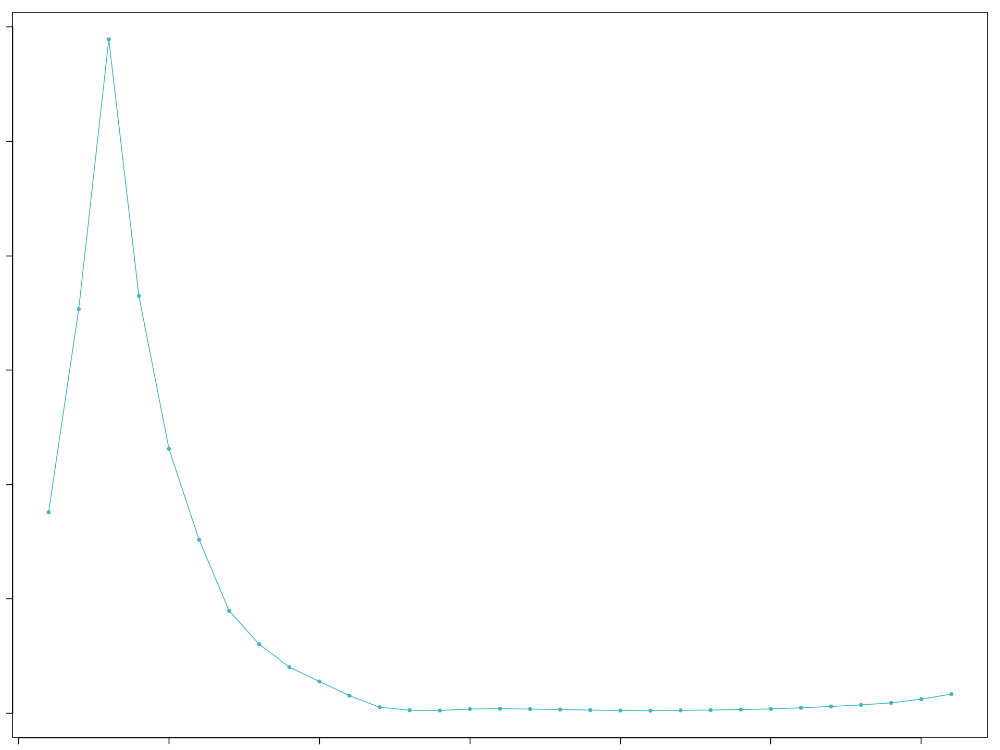

In [36]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[23]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[23]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Late2"
   ParamID   pK    MeanBC        VarBC   BCmetric
1        1 0.01 0.8433361 0.0001042777 8087.40543
2        2 0.02 0.8303806 0.0003283742 2528.76348
3        3 0.03 0.7968010 0.0014159460  562.73401
4        4 0.04 0.7533986 0.0009727316  774.51850
5        5 0.05 0.7227443

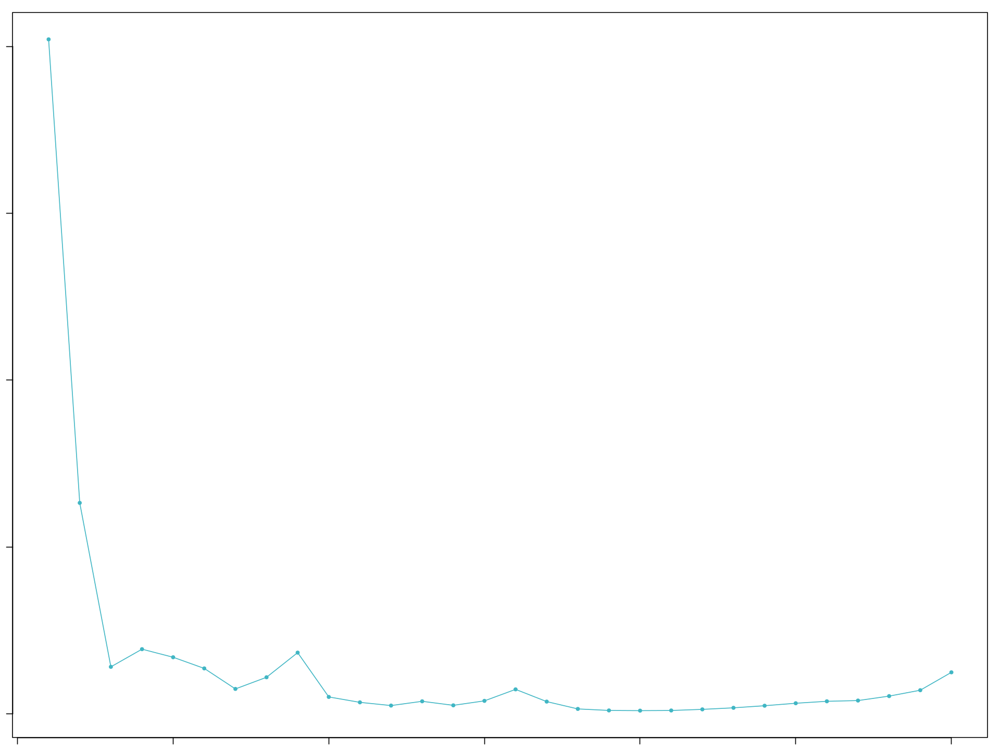

In [37]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[24]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[24]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyCtrl3"
   ParamID    pK    MeanBC        VarBC  BCmetric
1        1 0.005 0.8346656 0.0001240333 6729.3674
2        2  0.01 0.8588893 0.0000904332 9497.5000
3        3  0.02 0.8650265 0.0002310350 3744.1361
4        4  0.03 0.8609493 0.0006831715 1260.2244


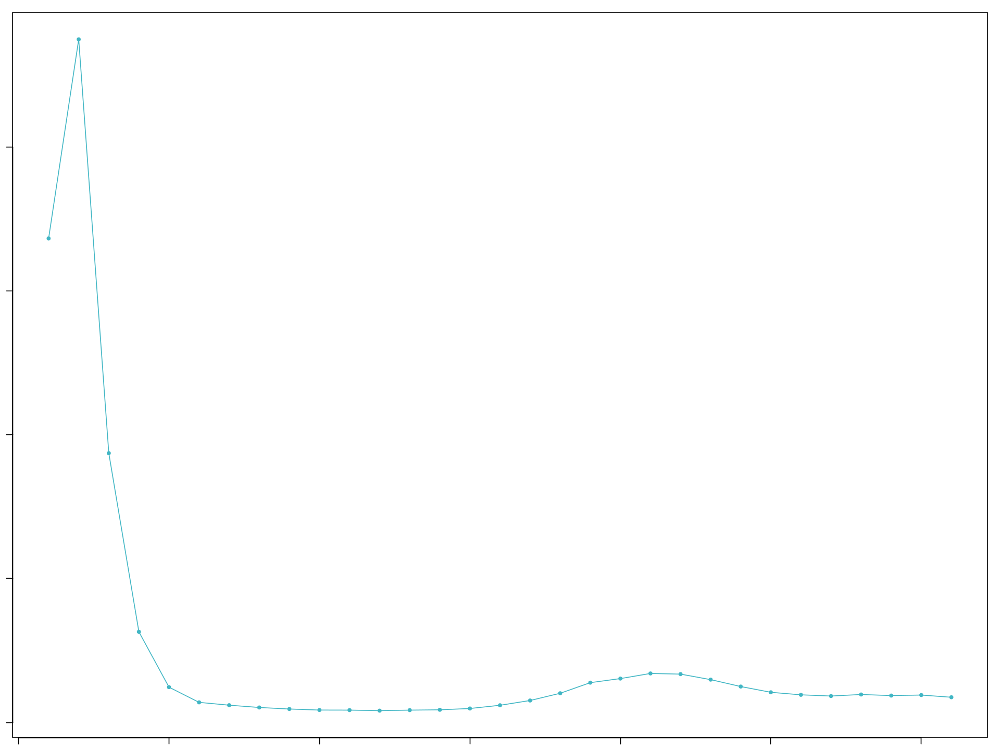

In [38]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[25]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[25]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  PeakMale4"
   ParamID    pK    MeanBC        VarBC  BCmetric
1        1 0.005 0.8206912 0.0005778832 1420.1678
2        2  0.01 0.8251961 0.0018365680  449.3142
3        3  0.02 0.8224639 0.0028303877  290.5835
4        4  0.03 0.8276840 0.0013832555  598.3594
5

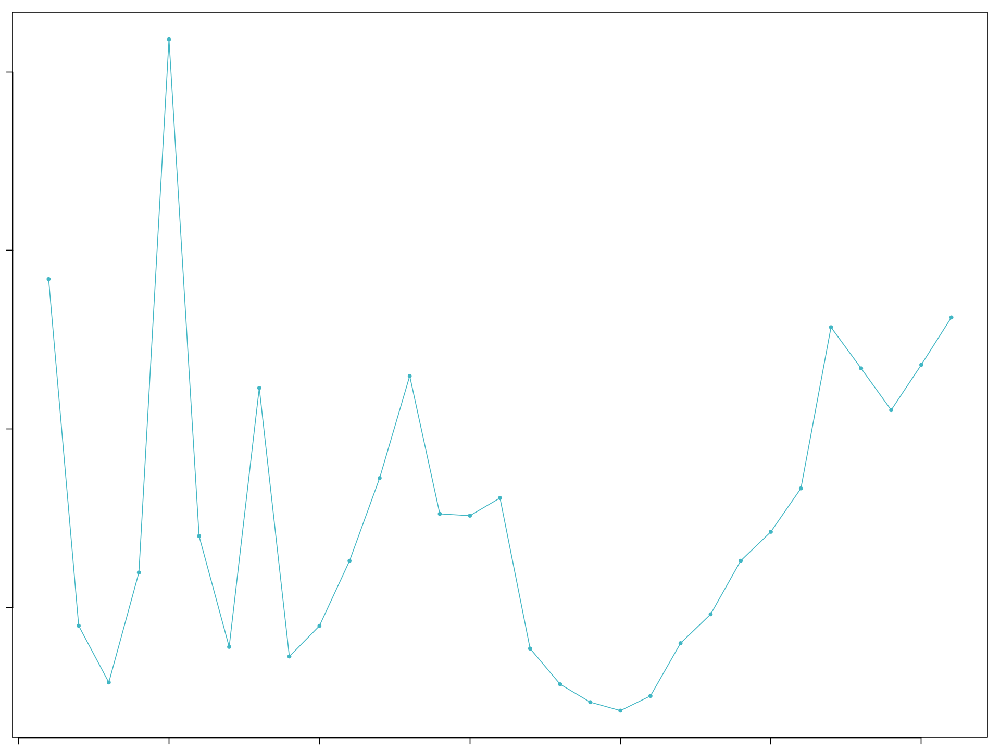

In [39]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[26]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[26]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Peak3"
   ParamID    pK    MeanBC        VarBC  BCmetric
1        1 0.005 0.8560203 0.0002749669 3113.1756
2        2  0.01 0.8509490 0.0003733866 2279.0024
3        3  0.02 0.8292478 0.0009290639  892.5627
4        4  0.03 0.8246260 0.0008416182  979.8100
5    

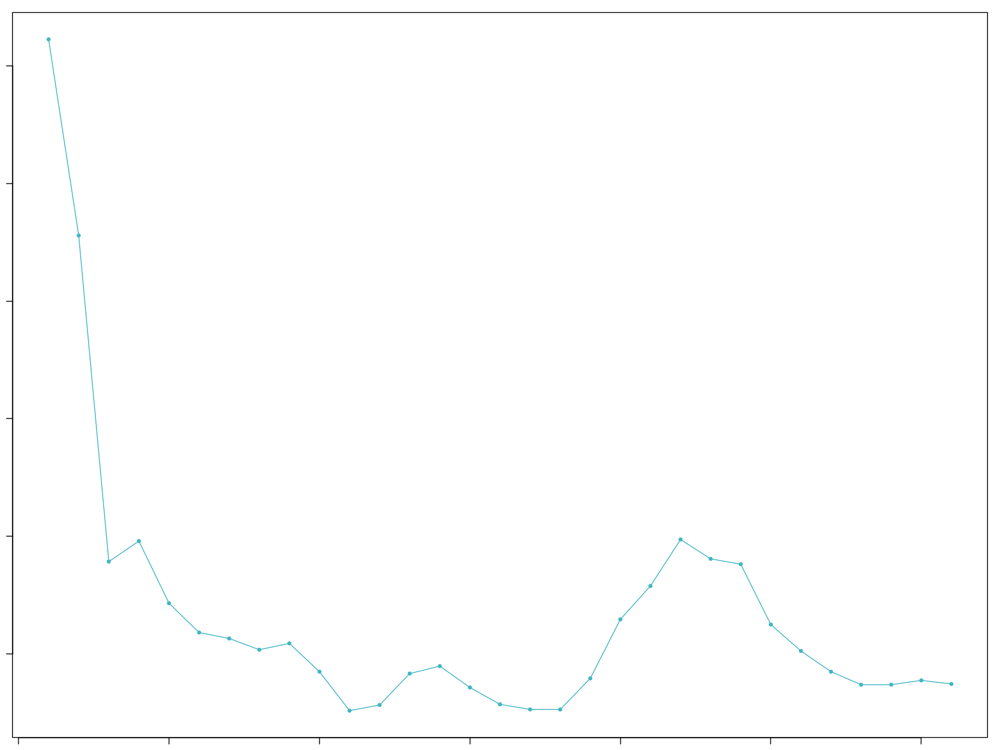

In [40]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[27]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[27]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  Early2"
   ParamID   pK    MeanBC        VarBC   BCmetric
1        1 0.01 0.8993094 1.092312e-04  8233.0813
2        2 0.02 0.8958472 3.866039e-05 23172.2219
3        3 0.03 0.8882352 1.662108e-04  5344.0281
4        4 0.04 0.8818972 2.105536e-04  4188.4685
5        5 0.05 0.869779

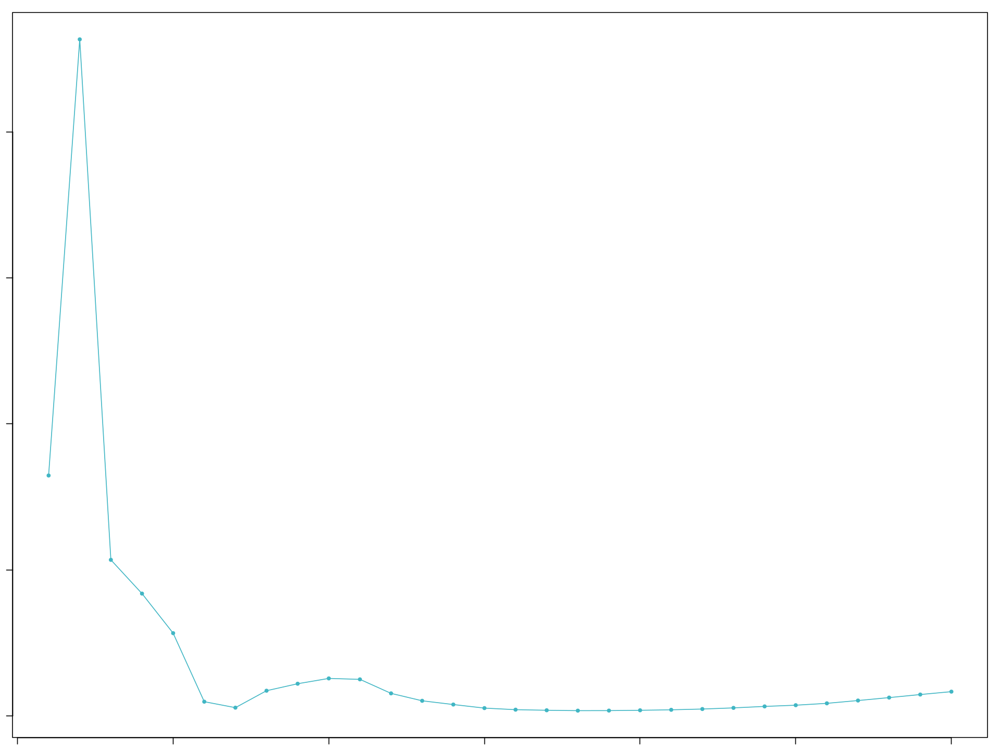

In [41]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[28]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[28]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  LateCtrl1"
   ParamID    pK    MeanBC        VarBC   BCmetric
1        1 0.005 0.8772882 2.091583e-04  4194.3752
2        2  0.01 0.8504888 6.668377e-05 12754.0602
3        3  0.02 0.8274226 5.667549e-04  1459.9303
4        4  0.03 0.7831377 2.092446e-03   374.2

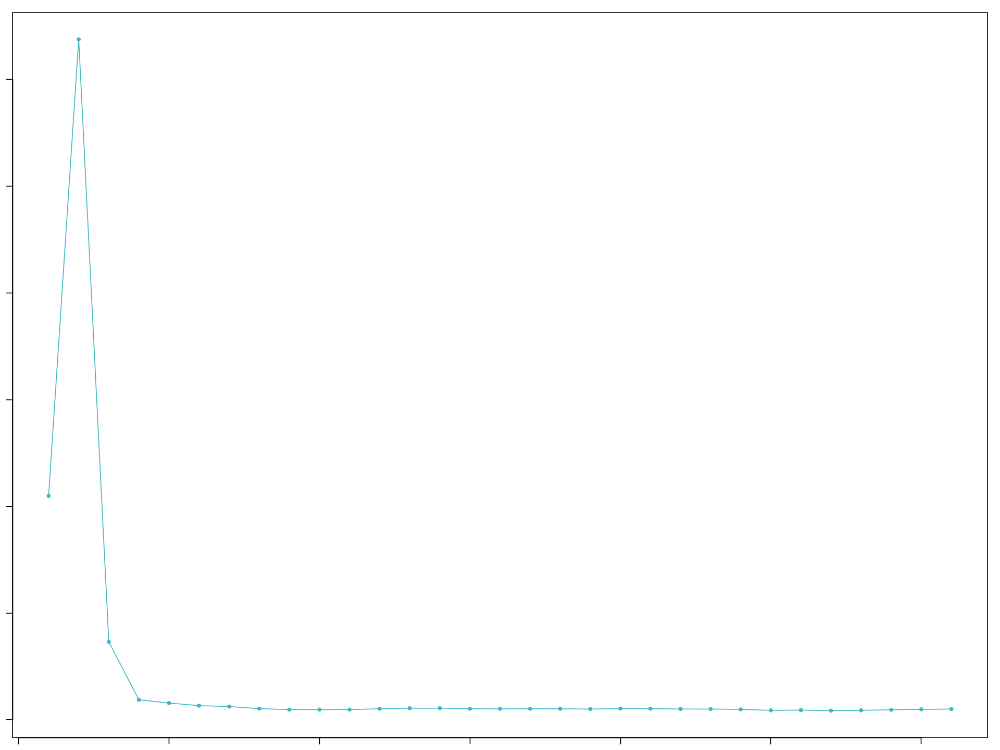

In [42]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[29]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[29]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.005..."
[1] "pK = 0.01..."
[1] "pK = 0.02..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  LateMale4"
   ParamID    pK    MeanBC       VarBC  BCmetric
1        1 0.005 0.8190847 0.001018283 804.37795
2        2  0.01 0.8001932 0.004160204 192.34473
3        3  0.02 0.7649430 0.006208936 123.20034
4        4  0.03 0.7477857 0.004603507 162.43827
5     

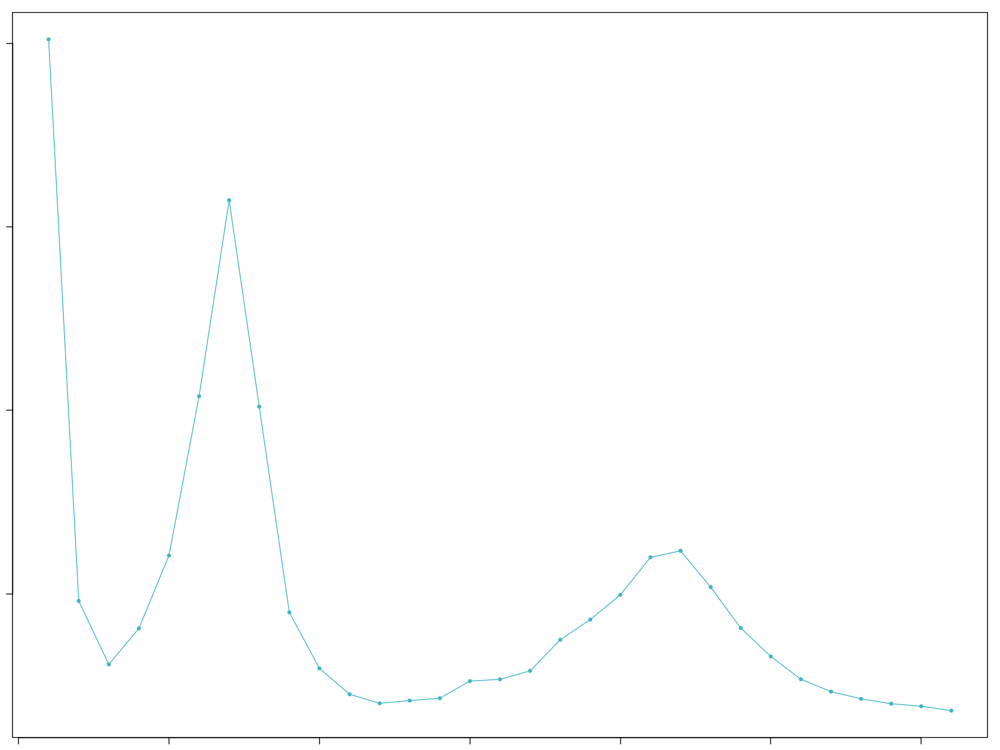

In [43]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[30]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[30]))
print(bcmvn)

[1] "Creating artificial doublets for pN = 5%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 10%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 15%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 20%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 25%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
[1] "Creating artificial doublets for pN = 30%"
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Defining neighborhoods..."
[1] "Computing pANN across all pK..."
[1] "pK = 0.03..."
[1] "pK = 0.04..."
[1] "pK = 0.05..."
[1] "pK = 0.06..."
[1] "pK = 0.07..."
[1] "pK = 0.08..."
[1] "pK = 0.09..."
[1] "pK = 0.1..."
[1] "pK = 0.11..."
[1] "pK = 0.12..."
[1] "pK = 0.13..."
[1] "pK = 0.14..."
[1] "pK = 0.15..."
[1] "pK = 0.16..."
[1] "pK = 0.17..."
[1] "pK = 0.18..."
[1] "pK = 0.19..."
[1] "pK = 0.2..."
[1] "pK = 0.21..."
[1] "pK = 0.22..."
[1] "pK = 0.23..."
[1] "pK = 0.24..."
[1] "pK = 0.25..."
[1] "pK = 0.26..."
[1] "pK = 0.27..."
[1] "pK = 0.28..."
[1] "pK = 0.29..."
[1] "pK = 0.3..."
NULL
[1] "Sample :  EarlyCtrl2"
   ParamID   pK    MeanBC        VarBC    BCmetric
1        1 0.03 0.8941729 7.783292e-05 11488.36314
2        2 0.04 0.8897353 8.913543e-05  9981.83756
3        3 0.05 0.8866323 1.102737e-04  8040.28698
4        4 0.06 0.8829189 1.945654e-04  4537.90239
5        5 0.07 0.8747321 3.645338e-04  2399.59127
6 

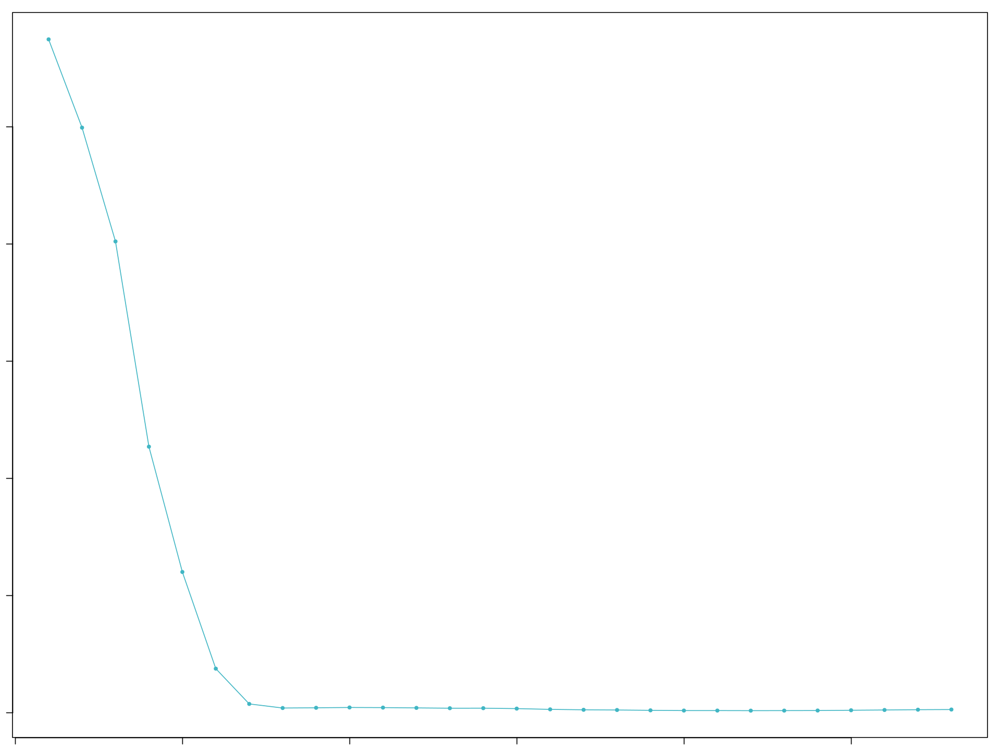

In [44]:
#Find best pk for doublet finding
sweep.res <- paramSweep(tmp_doublets.list[[31]], PCs = 1:15, sct = FALSE)
sweep.stats <- summarizeSweep(sweep.res, GT = FALSE)
bcmvn <- find.pK(sweep.stats)
print(paste("Sample : ", names(tmp_doublets.list)[31]))
print(bcmvn)

In [46]:
best_pk.v <- c(0.005,0.005,0.005,0.005,0.03,0.005,0.005,0.01,0.005,0.25,0.005,0.005,0.005,0.09,0.005,0.005,0.01,0.005,0.005,0.005,0.06,0.01,0.02,0.01,0.01,0.04,0.005,0.02,0.01,0.005,0.03)
names(best_pk.v) <- names(tmp_doublets.list)

In [47]:
for (sample in 1:length(tmp_doublets.list)) {

    homotypic.prop <- modelHomotypic(tmp_doublets.list[[sample]]$seurat_clusters)
    nExp_poi <- round(best_pk.v[sample]*nrow(tmp_doublets.list[[sample]]@meta.data))
    nExp_poi.adj <- round(nExp_poi*(1-homotypic.prop))
    print(names(tmp_doublets.list)[sample])
    print(paste0("Number of expected doublet : ",nExp_poi.adj))

    pN_value <- 0.25

    tmp_doublets.list[[sample]] <- doubletFinder(tmp_doublets.list[[sample]], PCs = 1:15, pN = pN_value, pK = best_pk.v[sample], nExp = nExp_poi.adj, reuse.pANN = FALSE, sct=FALSE)
}

[1] "LateCtrl2"
[1] "Number of expected doublet : 36"


Loading required package: fields

Loading required package: spam

Spam version 2.10-0 (2023-10-23) is loaded.
Type 'help( Spam)' or 'demo( spam)' for a short introduction 
and overview of this package.
Help for individual functions is also obtained by adding the
suffix '.spam' to the function name, e.g. 'help( chol.spam)'.


Attaching package: 'spam'


The following object is masked from 'package:stats4':

    mle


The following objects are masked from 'package:base':

    backsolve, forwardsolve



Try help(fields) to get started.

Loading required package: KernSmooth

KernSmooth 2.23 loaded
Copyright M. P. Wand 1997-2009



[1] "Creating 2845 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Naive2"
[1] "Number of expected doublet : 31"
[1] "Creating 2353 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "LateCtrl3"
[1] "Number of expected doublet : 32"
[1] "Creating 2481 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyFemale5"
[1] "Number of expected doublet : 49"
[1] "Creating 3713 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "PeakCtrl3"
[1] "Number of expected doublet : 51"
[1] "Creating 722 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Early1"
[1] "Number of expected doublet : 18"
[1] "Creating 1408 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyMale5"
[1] "Number of expected doublet : 43"
[1] "Creating 3546 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Early4"
[1] "Number of expected doublet : 25"
[1] "Creating 1080 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Late1"
[1] "Number of expected doublet : 20"
[1] "Creating 1512 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "PeakFemale4"
[1] "Number of expected doublet : 1012"
[1] "Creating 1617 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Peak5"
[1] "Number of expected doublet : 18"
[1] "Creating 1370 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "LateFemale4"
[1] "Number of expected doublet : 44"
[1] "Creating 3372 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyCtrlMale5"
[1] "Number of expected doublet : 35"
[1] "Creating 2754 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Naive1"
[1] "Number of expected doublet : 457"
[1] "Creating 1941 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Naive3"
[1] "Number of expected doublet : 26"
[1] "Creating 2084 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Late3"
[1] "Number of expected doublet : 19"
[1] "Creating 1443 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyCtrlFemale5"
[1] "Number of expected doublet : 69"
[1] "Creating 2812 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyFemale3"
[1] "Number of expected doublet : 14"
[1] "Creating 1146 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyMale3"
[1] "Number of expected doublet : 15"
[1] "Creating 1253 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyCtrl4"
[1] "Number of expected doublet : 30"
[1] "Creating 2356 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Late5"
[1] "Number of expected doublet : 333"
[1] "Creating 2183 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Peak2"
[1] "Number of expected doublet : 15"
[1] "Creating 592 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "PeakCtrl2"
[1] "Number of expected doublet : 52"
[1] "Creating 1088 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Late2"
[1] "Number of expected doublet : 15"
[1] "Creating 566 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyCtrl3"
[1] "Number of expected doublet : 30"
[1] "Creating 1208 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "PeakMale4"
[1] "Number of expected doublet : 117"
[1] "Creating 1172 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Peak3"
[1] "Number of expected doublet : 16"
[1] "Creating 1248 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "Early2"
[1] "Number of expected doublet : 17"
[1] "Creating 379 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "LateCtrl1"
[1] "Number of expected doublet : 22"
[1] "Creating 865 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "LateMale4"
[1] "Number of expected doublet : 22"
[1] "Creating 1665 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."
[1] "EarlyCtrl2"
[1] "Number of expected doublet : 9"
[1] "Creating 159 artificial doublets..."
[1] "Creating Seurat object..."
[1] "Normalizing Seurat object..."


Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Finding variable genes..."


Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


[1] "Scaling data..."


Centering and scaling data matrix

  |======================================================================| 100%


[1] "Running PCA..."
[1] "Calculating PC distance matrix..."
[1] "Computing pANN..."
[1] "Classifying doublets.."


In [48]:
nb_expected_doublets_doubletFinder <- c(36,31,32,49,51,18,43,25,20,1012,18,44,35,457,26,19,69,14,15,30,333,15,52,15,30,117,16,17,22,22,9)
names(nb_expected_doublets_doubletFinder) <- names(tmp_doublets.list)

In [49]:
nb_expected_doublets_doubletFinder <- nb_expected_doublets_doubletFinder[names(orig.ident_colors)]

In [50]:
nb_expected_doublets_doubletFinder

Naive1           Naive2           Naive3       EarlyCtrl2 
             457               31               26                9 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
              30               30               35               69 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
              52               51               22               36 
       LateCtrl3           Early1           Early2     EarlyFemale3 
              32               18               17               14 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
              15               25               43               49 
           Peak2            Peak3        PeakMale4      PeakFemale4 
              15               16              117             1012 
           Peak5            Late1            Late2            Late3 
              18               20               15               19 
       LateMale4      LateFemale4            Late5 
              22               44              333

In [51]:
DF_df <- c()
for (sample in 1:length(tmp_doublets.list)) {
    DF_tmp <- tmp_doublets.list[[sample]]@meta.data[,(ncol(tmp_doublets.list[[sample]]@meta.data)-1):ncol(tmp_doublets.list[[sample]]@meta.data)]
    colnames(DF_tmp) <- c("pANN", "DF.classifications")
    DF_df <- rbind(DF_df, DF_tmp)
}

In [52]:
MORNAATACC@meta.data[c("pANN", "DF.classifications")] <- DF_df[colnames(MORNAATACC[["RNA"]]), c("pANN", "DF.classifications")]

### 6.2 QC on doublets

In [44]:
table(MORNAATACC$orig.ident, MORNAATACC$DF.classifications)

                  
                   Doublet Singlet
  Naive1               457    5365
  Naive2                31    7028
  Naive3                26    6227
  EarlyCtrl2             9     468
  EarlyCtrl3            30    3593
  EarlyCtrl4            30    7039
  EarlyCtrlMale5        35    8227
  EarlyCtrlFemale5      69    8368
  PeakCtrl2             52    3211
  PeakCtrl3             51    2115
  LateCtrl1             22    2574
  LateCtrl2             36    8498
  LateCtrl3             32    7411
  Early1                18    4207
  Early2                17    1121
  EarlyFemale3          14    3424
  EarlyMale3            15    3744
  Early4                25    3214
  EarlyMale5            43   10596
  EarlyFemale5          49   11089
  Peak2                 15    1762
  Peak3                 16    3728
  PeakMale4            117    3400
  PeakFemale4         1012    3839
  Peak5                 18    4093
  Late1                 20    4515
  Late2                 15    1682
 

In [54]:
table(MORNAATACC$orig.ident, MORNAATACC$DF.classifications)[,"Doublet"]

Naive1           Naive2           Naive3       EarlyCtrl2 
             457               31               26                9 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
              30               30               35               69 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
              52               51               22               36 
       LateCtrl3           Early1           Early2     EarlyFemale3 
              32               18               17               14 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
              15               25               43               49 
           Peak2            Peak3        PeakMale4      PeakFemale4 
              15               16              117             1012 
           Peak5            Late1            Late2            Late3 
              18               20               15               19 
       LateMale4      LateFemale4            Late5 
              22               44              333

In [56]:
table(MORNAATACC$orig.ident, MORNAATACC$DF.classifications)[,"Doublet"]/table(MORNAATACC$orig.ident)*100


          Naive1           Naive2           Naive3       EarlyCtrl2 
       7.8495362        0.4391557        0.4158004        1.8867925 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
       0.8280431        0.4243882        0.4236262        0.8178262 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
       1.5936255        2.3545706        0.8474576        0.4218420 
       LateCtrl3           Early1           Early2     EarlyFemale3 
       0.4299342        0.4260355        1.4938489        0.4072135 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
       0.3990423        0.7718432        0.4041733        0.4399354 
           Peak2            Peak3        PeakMale4      PeakFemale4 
       0.8441193        0.4273504        3.3266989       20.8616780 
           Peak5            Late1            Late2            Late3 
       0.4378497        0.4410143        0.8839128        0.4389004 
       LateMale4      LateFemale4

In [57]:
nb_aimed_cells <- c(5000,7000,8000,5750,4500,10000,10000,10000,2300,7300,7000,8000,6000,7500,5400,3350,2100,8000,7000,10000,1000,9800,5000,10000,10000,5300,4000,8000,9000,7000,10000)
#Recovery efficiency factor from 10xgenomics 1.61
nb_loaded_cells <- nb_aimed_cells*1.61
names(nb_loaded_cells) <- names(orig.ident_colors)
nb_loaded_cells

Naive1           Naive2           Naive3       EarlyCtrl2 
          8050.0          11270.0          12880.0           9257.5 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
          7245.0          16100.0          16100.0          16100.0 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
          3703.0          11753.0          11270.0          12880.0 
       LateCtrl3           Early1           Early2     EarlyFemale3 
          9660.0          12075.0           8694.0           5393.5 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
          3381.0          12880.0          11270.0          16100.0 
           Peak2            Peak3        PeakMale4      PeakFemale4 
          1610.0          15778.0           8050.0          16100.0 
           Peak5            Late1            Late2            Late3 
         16100.0           8533.0           6440.0          12880.0 
       LateMale4      LateFemale4            Late5 
         14490.0          11270.0          16100.0

In [58]:
nb_expected_doublets_10x <- c(0.4,0.8,1.6,2.4,3.2,4.0,4.8,5.6,6.4,7.2,8)
names(nb_expected_doublets_10x) <- c(825,1650,3300,4950,6600,8250,9900,11550,13200,14850,16500)

In [59]:
nb_expected_percentage_doublets_10x <- round(nb_loaded_cells/2065.5,2)

In [60]:
initial_nb_cells <- c(6937,8166,7043,564,5514,7837,9124,9603,3746,2463,2817,9352,8403,4641,1323,3771,4185,5347,11937,12832,2023,5017,4033,5471,4646,4957,1887,4749,5761,11516,6982)
names(initial_nb_cells) <- names(orig.ident_colors)

In [61]:
nb_expected_doublets_10x <- initial_nb_cells*nb_expected_percentage_doublets_10x/100

In [62]:
nb_expected_doublets_10x

Naive1           Naive2           Naive3       EarlyCtrl2 
        270.5430         445.8636         439.4832          25.2672 
      EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 EarlyCtrlFemale5 
        193.5414         610.5023         710.7596         748.0737 
       PeakCtrl2        PeakCtrl3        LateCtrl1        LateCtrl2 
         67.0534         140.1447         153.8082         583.5648 
       LateCtrl3           Early1           Early2     EarlyFemale3 
        393.2604         271.4985          55.6983          98.4231 
      EarlyMale3           Early4       EarlyMale5     EarlyFemale5 
         68.6340         333.6528         651.7602         999.6128 
           Peak2            Peak3        PeakMale4      PeakFemale4 
         15.7794         383.2988         157.2870         426.1909 
           Peak5            Late1            Late2            Late3 
        361.9234         204.7241          58.8744         296.3376 
       LateMale4      LateFemale4            Late5 
        404.4222         628.7736         543.8978

In [63]:
table(MORNAATACC$orig.ident, MORNAATACC$DF.classifications)

                  
                   Doublet Singlet
  Naive1               457    5365
  Naive2                31    7028
  Naive3                26    6227
  EarlyCtrl2             9     468
  EarlyCtrl3            30    3593
  EarlyCtrl4            30    7039
  EarlyCtrlMale5        35    8227
  EarlyCtrlFemale5      69    8368
  PeakCtrl2             52    3211
  PeakCtrl3             51    2115
  LateCtrl1             22    2574
  LateCtrl2             36    8498
  LateCtrl3             32    7411
  Early1                18    4207
  Early2                17    1121
  EarlyFemale3          14    3424
  EarlyMale3            15    3744
  Early4                25    3214
  EarlyMale5            43   10596
  EarlyFemale5          49   11089
  Peak2                 15    1762
  Peak3                 16    3728
  PeakMale4            117    3400
  PeakFemale4         1012    3839
  Peak5                 18    4093
  Late1                 20    4515
  Late2                 15    1682
 

In [64]:
mat <- matrix(c(table(MORNAATACC$orig.ident, MORNAATACC$DF.classifications)[,"Doublet"], nb_expected_doublets_10x), ncol=2, byrow=FALSE)
colnames(mat) <- c('DF_pred', 'Exp_10X')
rownames(mat) <- names(orig.ident_colors)
tab <- as.table(mat)
names(dimnames(tab)) <- c("Sample", "Pred")
tab

                  Pred
Sample               DF_pred   Exp_10X
  Naive1            457.0000  270.5430
  Naive2             31.0000  445.8636
  Naive3             26.0000  439.4832
  EarlyCtrl2          9.0000   25.2672
  EarlyCtrl3         30.0000  193.5414
  EarlyCtrl4         30.0000  610.5023
  EarlyCtrlMale5     35.0000  710.7596
  EarlyCtrlFemale5   69.0000  748.0737
  PeakCtrl2          52.0000   67.0534
  PeakCtrl3          51.0000  140.1447
  LateCtrl1          22.0000  153.8082
  LateCtrl2          36.0000  583.5648
  LateCtrl3          32.0000  393.2604
  Early1             18.0000  271.4985
  Early2             17.0000   55.6983
  EarlyFemale3       14.0000   98.4231
  EarlyMale3         15.0000   68.6340
  Early4             25.0000  333.6528
  EarlyMale5         43.0000  651.7602
  EarlyFemale5       49.0000  999.6128
  Peak2              15.0000   15.7794
  Peak3              16.0000  383.2988
  PeakMale4         117.0000  157.2870
  PeakFemale4      1012.0000  426.1909
  

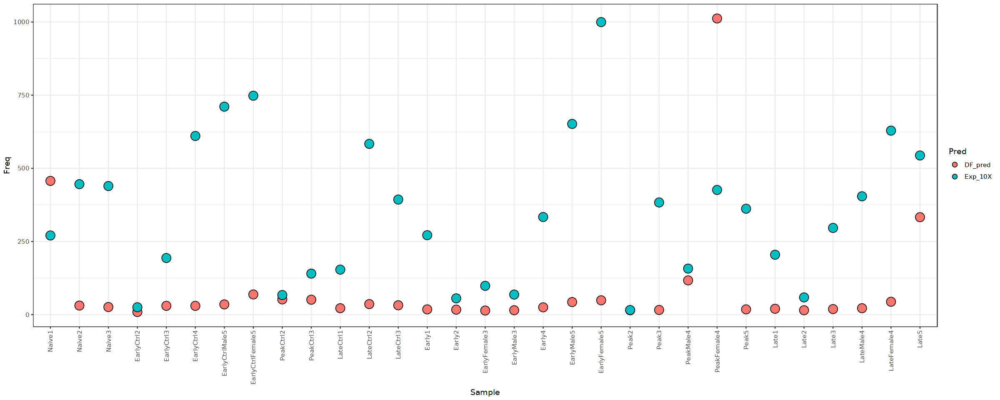

In [65]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(data = as.data.frame(tab), aes(y = Freq, x = Sample)) +
    geom_dotplot(aes(fill = Pred),
                 binaxis = "y",
                 binwidth = 0.1,
                 dotsize = 300,
                 stackdir = "centerwhole", 
                 method="dotdensity",
                 stackgroups = T,
                 binpositions="all"
                 ) +
    theme_bw()+
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [66]:
annot <- MORNAATACC@meta.data[order(MORNAATACC$pANN, decreasing=FALSE),]

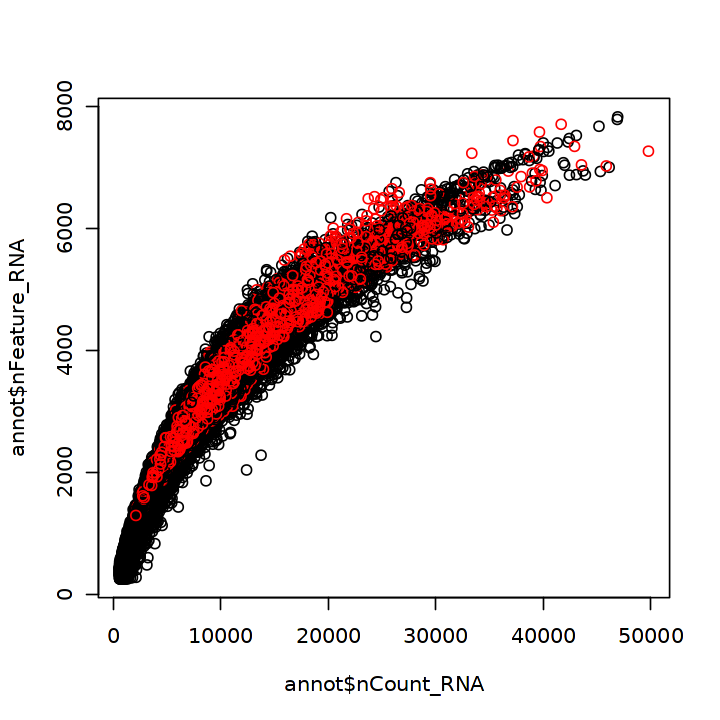

In [67]:
options(repr.plot.width=6, repr.plot.height=6)
plot(annot$nCount_RNA, annot$nFeature_RNA, col=mapvalues(annot$DF.classifications, from=c('Singlet','Doublet'), to=c('black','red')))

### 6.3 Visualize doublets on UMAPs

In [ ]:
options(repr.plot.width=8, repr.plot.height=6)
for (sample in 1:length(tmp_doublets.list)) {
    name_col_doublet <- colnames(tmp_doublets.list[[sample]]@meta.data)[length(colnames(tmp_doublets.list[[sample]]@meta.data))]
    print(DimPlot(tmp_doublets.list[[sample]], group.by=name_col_doublet, reduction = "umap", pt.size = 1) + plot_annotation(title = names(tmp_doublets.list)[sample]))
}

In [68]:
tmp_doublets.list <- NULL

In [70]:
MORNAATACC_doublets <- NormalizeData(MORNAATACC, normalization.method = "LogNormalize", scale.factor = 10000)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [71]:
MORNAATACC_doublets <- FindVariableFeatures(MORNAATACC_doublets, selection.method = "vst", nfeatures = 2000)

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [72]:
MORNAATACC_doublets <- ScaleData(MORNAATACC_doublets)

Centering and scaling data matrix

  |======================================================================| 100%


In [73]:
MORNAATACC_doublets <- RunPCA(MORNAATACC_doublets)

PC_ 1 
Positive:  Trf, Apod, Ptgds, Dgki, Gsn, Endod1, Sypl, Tmsb4x, Tenm2, A330015K06Rik 
	   Tppp3, Bcas1, Fabp5, Fam13c, A330049N07Rik, 4930420G21Rik, Selenop, Tuba1a, Grik2, Ftl1 
	   Pmp22, Cldn14, Plin3, Rtkn2, Klk6, Fmnl2, Chn2, Synm, Hmgcs1, Dcaf17 
Negative:  Ptprz1, Kcnd2, Sox6, Nrxn1, Nrcam, Ntm, Serpine2, Nrxn3, Dlgap1, Sox5 
	   Plcb1, Klf12, Fgf14, Zeb1, Spon1, Lrp1, Gpm6a, Ntrk3, Fam155a, Grm5 
	   Nebl, Lsamp, Ntrk2, Gpc6, Trio, Fat3, Sparcl1, Lhfpl3, Ptprg, Vcan 
PC_ 2 
Positive:  Ctss, Ptprc, Mpeg1, Lyn, Laptm5, Tyrobp, Cyba, Plek, Csf1r, C1qa 
	   Ctsc, Inpp5d, C1qb, Cd84, C1qc, Cd74, Lyz2, Srgn, Runx1, Cd86 
	   Cd53, Fcer1g, Dock2, Ctsh, Ly86, Fyb, Fcgr3, Sirpa, Cybb, Itgam 
Negative:  Cadm2, Lrrc4c, Grid2, Il1rapl1, Lsamp, Nlgn1, Bcas1, Adgrl3, Gria4, Nrxn1 
	   Ptprz1, Kcnd2, Ptgds, Ctnnd2, Anks1b, Cntn1, Pcdh7, Opcml, Gria2, Ntm 
	   Adgrb3, Luzp2, Nrxn3, Fam155a, Dlgap1, Fgf14, Grik2, Brinp3, Tuba1a, Lhfpl3 
PC_ 3 
Positive:  Nxph1, Tnr, Vcan, Pdgfra, Lrrtm4, P

In [74]:
MORNAATACC_doublets <- FindNeighbors(MORNAATACC_doublets, reduction = "pca", dims = 1:40, prune.SNN = 0, graph.name="snn_RNA")

Computing nearest neighbor graph

Computing SNN

Only one graph name supplied, storing nearest-neighbor graph only



In [75]:
MORNAATACC_doublets <- RunUMAP(MORNAATACC_doublets, reduction = "pca", reduction.name="umap_RNA", dims = 1:40)

20:30:23 UMAP embedding parameters a = 0.9922 b = 1.112

20:30:23 Read 158801 rows and found 40 numeric columns

20:30:23 Using Annoy for neighbor search, n_neighbors = 30

20:30:23 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

20:30:49 Writing NN index file to temp file /tmp/Rtmpylfze0/file547f76eea56

20:30:49 Searching Annoy index using 1 thread, search_k = 3000

20:32:15 Annoy recall = 100%

20:32:25 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

20:32:36 Initializing from normalized Laplacian + noise (using RSpectra)

20:33:21 Commencing optimization for 200 epochs, with 7376494 positive edges

Using method 'umap'
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
*

In [76]:
MORNAATACC_doublets$orig.ident <- factor(x = MORNAATACC_doublets$orig.ident, levels = names(orig.ident_colors))
MORNAATACC_doublets$orig.ident_merge <- factor(x = MORNAATACC_doublets$orig.ident_merge, levels = names(orig.ident_merge_colors))

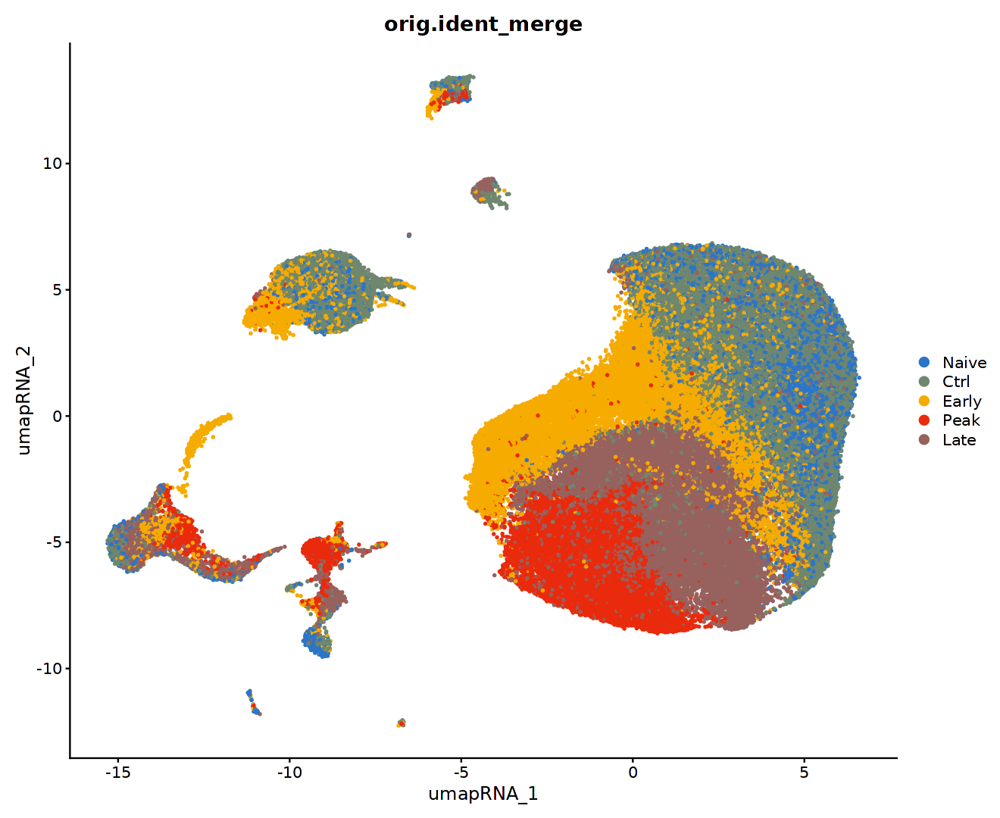

In [77]:
options(repr.plot.width=11, repr.plot.height=9)
DimPlot(MORNAATACC_doublets, group.by="orig.ident_merge", reduction="umap_RNA", shuffle=TRUE, seed=seed, cols=orig.ident_merge_colors, pt.size=0.5, label=FALSE, raster=FALSE)

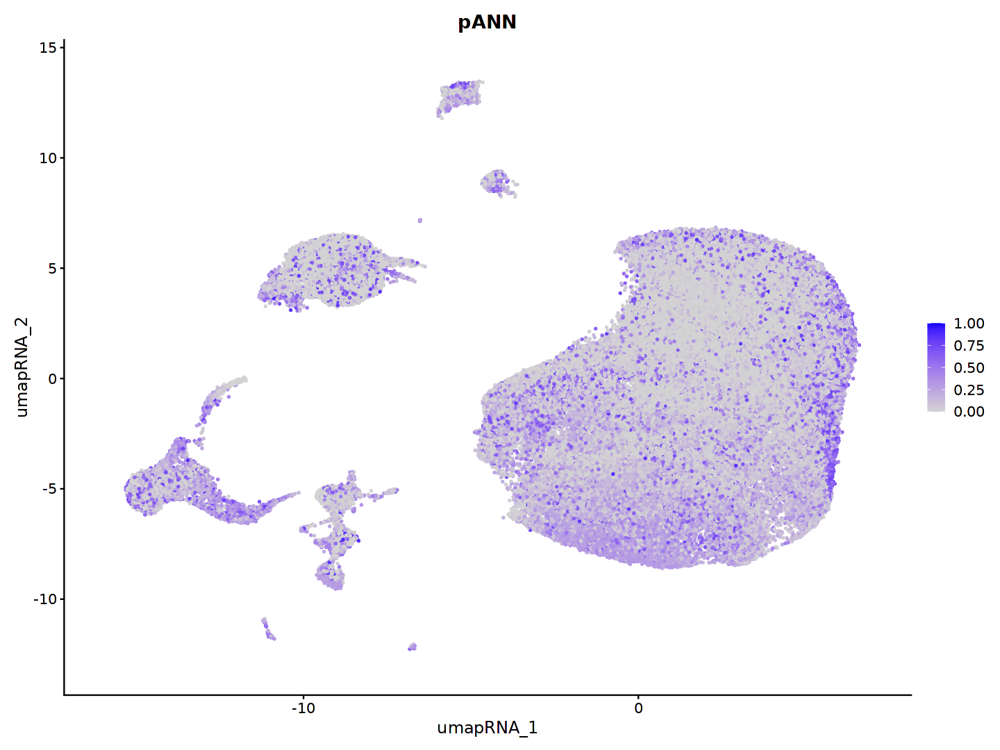

In [78]:
options(repr.plot.width=12, repr.plot.height=9)
FeaturePlot(MORNAATACC_doublets, feature = "pANN", pt.size = 0.5, raster=FALSE)

In [79]:
doublet_names <- rownames(MORNAATACC@meta.data[MORNAATACC$DF.classifications == "Doublet",])

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


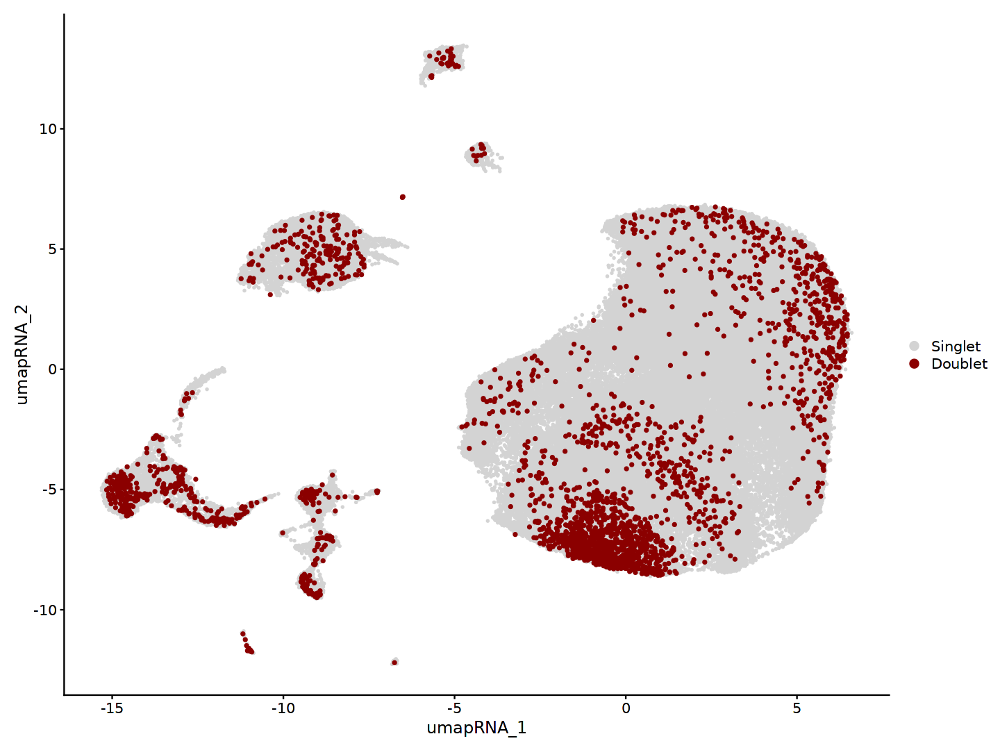

In [80]:
options(repr.plot.width=12, repr.plot.height=9)
DimPlot(MORNAATACC_doublets, pt.size = 0.5, cells.highlight= list(doublet_names), raster=FALSE) + scale_color_manual(labels = c("Singlet", "Doublet"), values = c("lightgrey", "darkred"))

In [81]:
#Doublet coming from PeakFemale4
doublet_names_PeakFemale4 <- rownames(MORNAATACC@meta.data[doublet_names,][MORNAATACC@meta.data[doublet_names,"orig.ident"] == "PeakFemale4",])

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


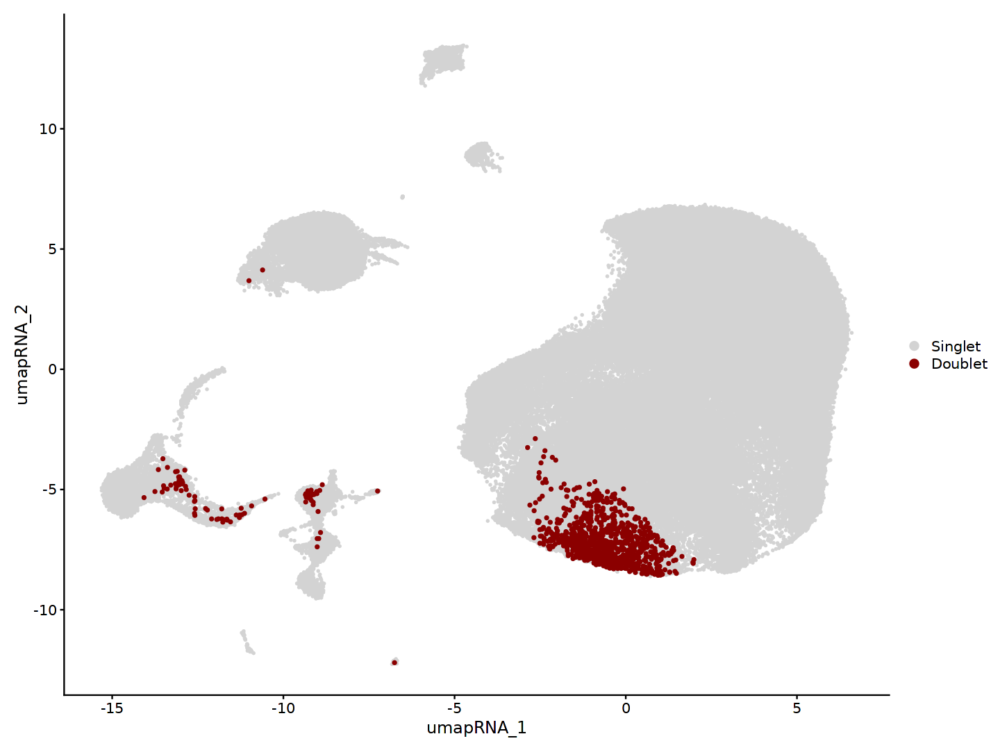

In [82]:
options(repr.plot.width=12, repr.plot.height=9)
DimPlot(MORNAATACC_doublets, pt.size = 0.5, cells.highlight= list(doublet_names_PeakFemale4), raster=FALSE) + scale_color_manual(labels = c("Singlet", "Doublet"), values = c("lightgrey", "darkred"))

### 6.4 Remove doublets

In [83]:
MORNAATACC

An object of class Seurat 
288993 features across 158801 samples within 4 assays 
Active assay: RNA (32285 features, 0 variable features)
 2 layers present: counts, data
 3 other assays present: RAW, peaks, GenePromAcc

In [84]:
#Doublets do not cluster together. OL at Peak stage are more classified as Doublet supposely because of their immune profile
MORNAATACC <- subset(MORNAATACC, subset = DF.classifications == "Singlet")

In [85]:
MORNAATACC

An object of class Seurat 
288993 features across 156109 samples within 4 assays 
Active assay: RNA (32285 features, 0 variable features)
 2 layers present: counts, data
 3 other assays present: RAW, peaks, GenePromAcc

[Save](#X.1-Savings)

## 7. Cell sex classification

### 7.1 Models creation

#### 7.1.1 Load Ensembl database

In [23]:
#The following cell grab Ensembl data from the web, so it may be unstable, try it again and again or use the work around below
#Change host if needed
#https://useast.ensembl.org
#https://asia.ensembl.org
#httr::set_config(httr::config(ssl_verifypeer = FALSE))
#mart <- useMart("ENSEMBL_MART_ENSEMBL", dataset = "mmusculus_gene_ensembl", host="https://useast.ensembl.org", verbose=TRUE)
#genes.table <-try(biomaRt::getBM(attributes = c("ensembl_gene_id", "external_gene_name", "description", "gene_biotype", "chromosome_name", "start_position"), mart = mart, useCache = F, verbose=TRUE))

ERROR: Error in bmRequest(request = request, httr_config = httr_config, verbose = verbose): Gateway Timeout (HTTP 504).


In [32]:
#Ensembl connection issue, work around
httr::set_config(httr::config(ssl_verifypeer = FALSE))
mart <- useMart("ENSEMBL_MART_ENSEMBL", dataset = "mmusculus_gene_ensembl", host="https://ensembl.org", verbose=TRUE)
genes.table <-try(biomaRt::getBM(attributes = c("ensembl_gene_id", "external_gene_name", "description", "gene_biotype", "chromosome_name", "start_position"), mart = mart, useCache = F, verbose=TRUE))

BioMartServer running BioMart version: 0.7
Mart virtual schema: default
Mart host: https://ensembl.org:443/biomart/martservice


Checking attributes ...
Attempting web service request:
https://ensembl.org:443/biomart/martservice?type=attributes&dataset=mmusculus_gene_ensembl&requestid=biomaRt&mart=ENSEMBL_MART_ENSEMBL&virtualSchema=default

 ok

Checking filters ...
Attempting web service request:
https://ensembl.org:443/biomart/martservice?type=filters&dataset=mmusculus_gene_ensembl&requestid=biomaRt&mart=ENSEMBL_MART_ENSEMBL&virtualSchema=default

 ok

<?xml version='1.0' encoding='UTF-8'?><!DOCTYPE Query><Query  virtualSchemaName = 'default' uniqueRows = '1' count='0' datasetConfigVersion='0.6' header='1' formatter='TSV' requestid='biomaRt'> <Dataset name = 'mmusculus_gene_ensembl'><Attribute name = 'ensembl_gene_id'/><Attribute name = 'external_gene_name'/><Attribute name = 'description'/><Attribute name = 'gene_biotype'/><Attribute name = 'chromosome_name'/><Attribute name = 'start_position'/></Dataset></Query>



Error in .processResults(postRes, mart = mart, hostURLsep = sep, fullXmlQuery = fullXmlQuery,  : 
  The query to the BioMart webservice returned an invalid result.
The number of columns in the result table does not equal the number of attributes in the query.
Please report this on the support site at http://support.bioconductor.org


In [12]:
%put OS_path_inputs

In [15]:
%get OS_path_inputs --from R\ 4.3.2
wget -O $OS_path_inputs/ensembl_gene_table.tsv 'http://www.ensembl.org/biomart/martservice?query=<?xml version="1.0" encoding="UTF-8"?><!DOCTYPE Query><Query  virtualSchemaName = "default" uniqueRows = "1" count="0" datasetConfigVersion="0.6" header="1" formatter="TSV" requestid="biomaRt"> <Dataset name = "mmusculus_gene_ensembl"><Attribute name = "ensembl_gene_id"/><Attribute name = "external_gene_name"/><Attribute name = "description"/><Attribute name = "gene_biotype"/><Attribute name = "chromosome_name"/><Attribute name = "start_position"/></Dataset></Query>'

--2024-03-23 12:30:44--  http://www.ensembl.org/biomart/martservice?query=%3C?xml%20version=%221.0%22%20encoding=%22UTF-8%22?%3E%3C!DOCTYPE%20Query%3E%3CQuery%20%20virtualSchemaName%20=%20%22default%22%20uniqueRows%20=%20%221%22%20count=%220%22%20datasetConfigVersion=%220.6%22%20header=%221%22%20formatter=%22TSV%22%20requestid=%22biomaRt%22%3E%20%3CDataset%20name%20=%20%22mmusculus_gene_ensembl%22%3E%3CAttribute%20name%20=%20%22ensembl_gene_id%22/%3E%3CAttribute%20name%20=%20%22external_gene_name%22/%3E%3CAttribute%20name%20=%20%22description%22/%3E%3CAttribute%20name%20=%20%22gene_biotype%22/%3E%3CAttribute%20name%20=%20%22chromosome_name%22/%3E%3CAttribute%20name%20=%20%22start_position%22/%3E%3C/Dataset%3E%3C/Query%3E
Resolving www.ensembl.org (www.ensembl.org)... 193.62.193.83
Connecting to www.ensembl.org (www.ensembl.org)|193.62.193.83|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/plain]
Saving to: ‘/sing_data/Data/MORNAATACC/Inputs//e

In [88]:
genes.table <- read.table(paste0(OS_path_inputs,"ensembl_gene_table.tsv"), sep = "\t", header=TRUE, quote="", stringsAsFactors = FALSE)
colnames(genes.table) <- c("ensembl_gene_id", "external_gene_name", "description", "gene_biotype", "chromosome_name", "start_position")

#### 7.1.2 Format sex specific samples

In [12]:
Idents(MORNAATACC) <- "orig.ident"
groundThruth_sex <- subset(x = MORNAATACC, idents = c("EarlyCtrlMale5", "EarlyCtrlFemale5", "EarlyFemale3", "EarlyMale3", "EarlyMale5", "EarlyFemale5", "PeakMale4", "PeakFemale4", "LateMale4", "LateFemale4"))

In [13]:
sex_vector <- groundThruth_sex$orig.ident
sex_vector <- ifelse(sex_vector %like% "Female", "F", "M")
names(sex_vector) <- colnames(groundThruth_sex)

In [18]:
groundThruth_sex@meta.data[names(sex_vector),'sex'] <- sex_vector

In [19]:
table(groundThruth_sex$sex)


    F     M 
36792 30940 

In [23]:
MORNAATACC <- NULL

In [24]:
sub_female <- sample(colnames(groundThruth_sex)[groundThruth_sex$sex=="F"],30940)
sub_cells <- c(sub_female, colnames(groundThruth_sex)[groundThruth_sex$sex=="M"])
groundThruth_sex_mitigated <- groundThruth_sex[,sub_cells]

In [25]:
table(groundThruth_sex_mitigated$sex)


    F     M 
30940 30940 

In [26]:
DefaultAssay(groundThruth_sex_mitigated) <- "RNA"

In [27]:
groundThruth_sex_mitigated <- NormalizeData(groundThruth_sex_mitigated, normalization.method = "LogNormalize", scale.factor = 10000)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [28]:
groundThruth_sex_mitigated <- FindVariableFeatures(groundThruth_sex_mitigated, selection.method = "vst", nfeatures = 500)

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [29]:
groundThruth_sex_mitigated <- ScaleData(groundThruth_sex_mitigated, features = rownames(groundThruth_sex_mitigated))

Centering and scaling data matrix

  |======================================================================| 100%


In [30]:
groundThruth_sex_mitigated <- RunPCA(groundThruth_sex_mitigated)

PC_ 1 
Positive:  Apod, Klk6, 9330111N05Rik, Cntn3, Hopx, 2310002F09Rik, Gm32122, Aff3, Klk8, Grm7 
	   Ifi27l2a, Ctsd, H2-T23, Arhgap15, Serpina3n, Fam169a, Hba-a1, S100a9, Hmcn1, Fga 
	   Itprid1, S100a8, Ctla4, Dock2, Synpr, Man1a, Retnlg, Piezo2, Ucn2, Ifit2 
Negative:  Ptprz1, Sox6, Kcnd2, Vcan, Nrcam, Sgcd, Nrxn1, Nrxn3, Nxph1, Dlgap1 
	   Grm5, Fam155a, Sntg1, Ptprt, Tnr, Zeb1, Prkg1, Lhfpl3, Csmd1, Sox5 
	   Fgf14, Pdgfra, Serpine2, Klf12, Plcb1, Cacng4, Rbfox1, Spon1, Ntm, Lrrtm4 
PC_ 2 
Positive:  Slc4a4, Trpm3, Slc39a12, Gja1, Slc7a10, Aqp4, Pla2g7, Rgs6, Agt, Mgat4c 
	   Gpc5, Gabrb1, Rmst, Gm3764, Nhsl1, Pitpnc1, Slc1a2, Atp1a2, Clu, Gria1 
	   Atp1b2, Prex2, Sparcl1, Car10, Trim9, Cst3, Plce1, Trp63, Mt3, Utrn 
Negative:  Tnr, Vcan, Nxph1, Ppfibp1, Dscam, Lrrtm4, Sema3d, Opcml, Pdgfra, Itga9 
	   Slc35f1, Gria3, Mmp16, Adarb2, Tafa2, Prkg1, Mybpc1, Csmd1, Megf11, Cntn6 
	   Nrg3, Cspg4, Galnt13, Neto1, Rims1, Lrrc7, Dpp10, Cdh13, Rbfox1, C1ql1 
PC_ 3 
Positive:  Vim, Ctss

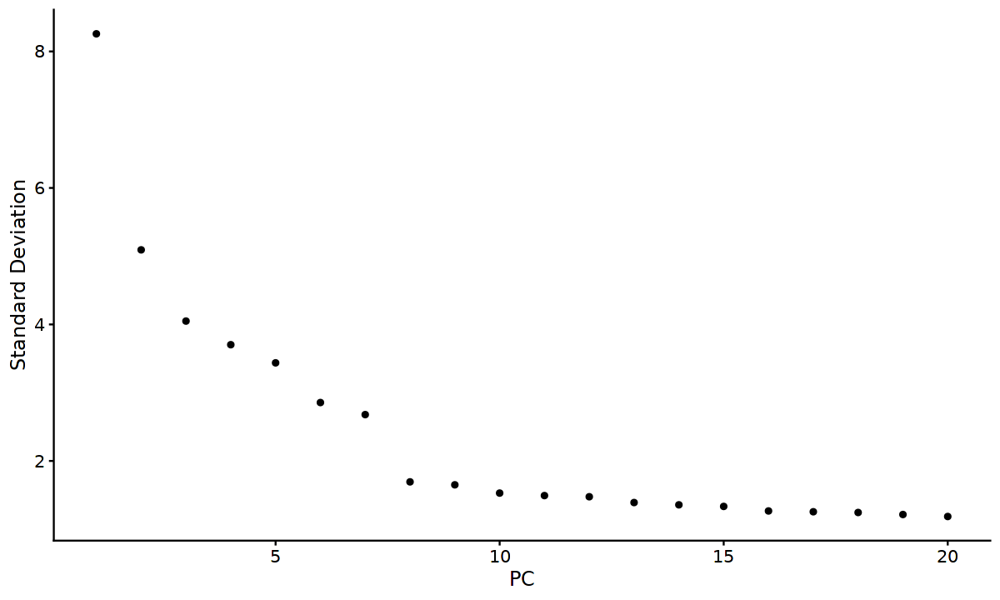

In [31]:
options(repr.plot.width=10, repr.plot.height=6)
ElbowPlot(groundThruth_sex_mitigated)

In [32]:
groundThruth_sex_mitigated <- FindNeighbors(groundThruth_sex_mitigated, reduction = "pca", dims = 1:10)

Computing nearest neighbor graph

Computing SNN



In [33]:
groundThruth_sex_mitigated <- RunUMAP(groundThruth_sex_mitigated, reduction = "pca", dims = 1:10)

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
09:50:54 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by 'BiocGenerics'

09:50:54 Read 61880 rows and found 10 numeric columns

09:50:54 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by 'BiocGenerics'

09:50:54 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

09:51:03 Writing NN index file to 

In [34]:
genes.table <- genes.table[genes.table$external_gene_name %in% rownames(groundThruth_sex_mitigated), ]

chrY.gene = genes.table$external_gene_name[genes.table$chromosome_name == "Y"]
chrX.gene = genes.table$external_gene_name[genes.table$chromosome_name == "X"]

In [35]:
groundThruth_sex_mitigated$pct_chrY = colSums(groundThruth_sex_mitigated@assays$RNA$counts[chrY.gene, ])/colSums(groundThruth_sex_mitigated@assays$RNA$counts)
groundThruth_sex_mitigated$pct_chrX = colSums(groundThruth_sex_mitigated@assays$RNA$counts[chrX.gene, ])/colSums(groundThruth_sex_mitigated@assays$RNA$counts)

cd_features <- list('Xist')
groundThruth_sex_mitigated <- AddModuleScore(
  object = groundThruth_sex_mitigated,
  features = cd_features,
  ctrl = 200,
  name = 'Xist_score'
)

In [36]:
annot <- groundThruth_sex_mitigated@meta.data[,c("sex","pct_chrY","pct_chrX","Xist_score1")]
colnames(annot) <- c("Sex", "pct_chrY", "pct_chrX", "Xist_score")

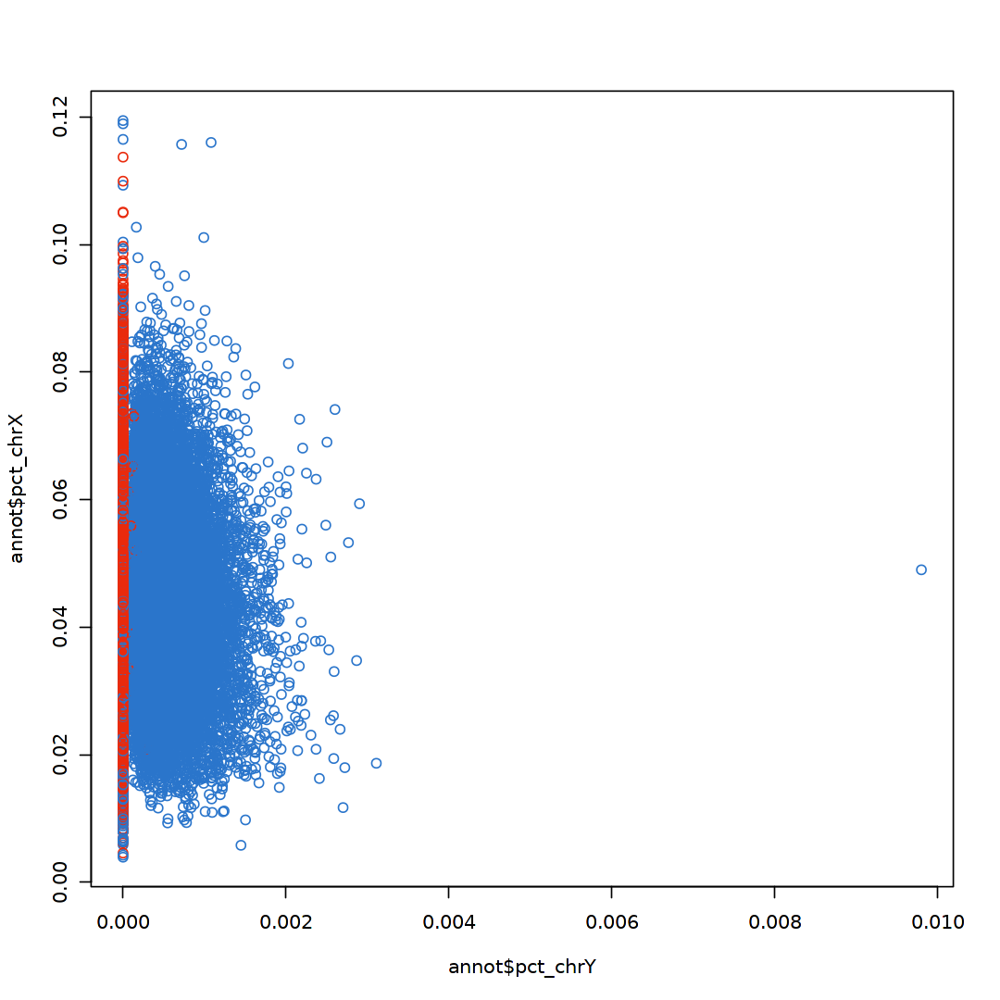

In [37]:
options(repr.plot.width=9, repr.plot.height=9)
plot(annot$pct_chrY, annot$pct_chrX, col=mapvalues(annot$Sex, from=names(sex_colors), to=sex_colors))

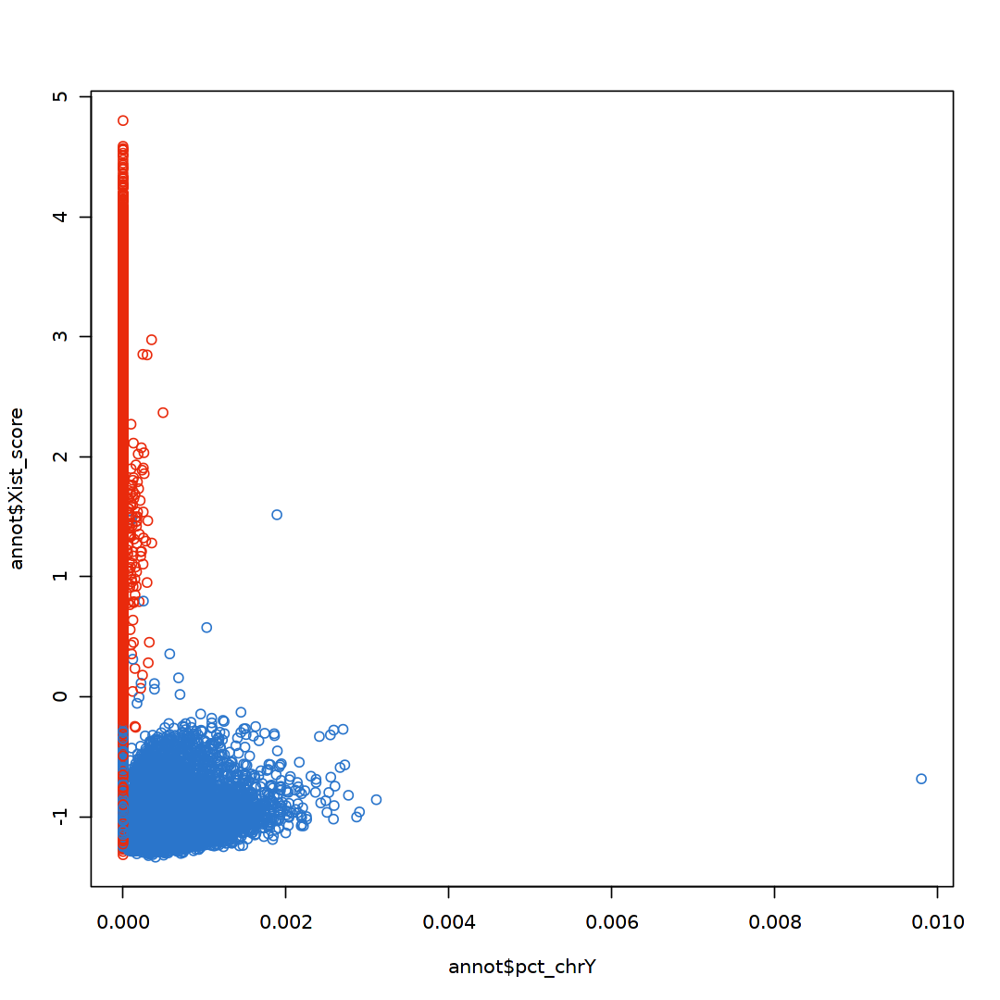

In [38]:
options(repr.plot.width=9, repr.plot.height=9)
plot(annot$pct_chrY, annot$Xist_score, col=mapvalues(annot$Sex, from=names(sex_colors), to=sex_colors))

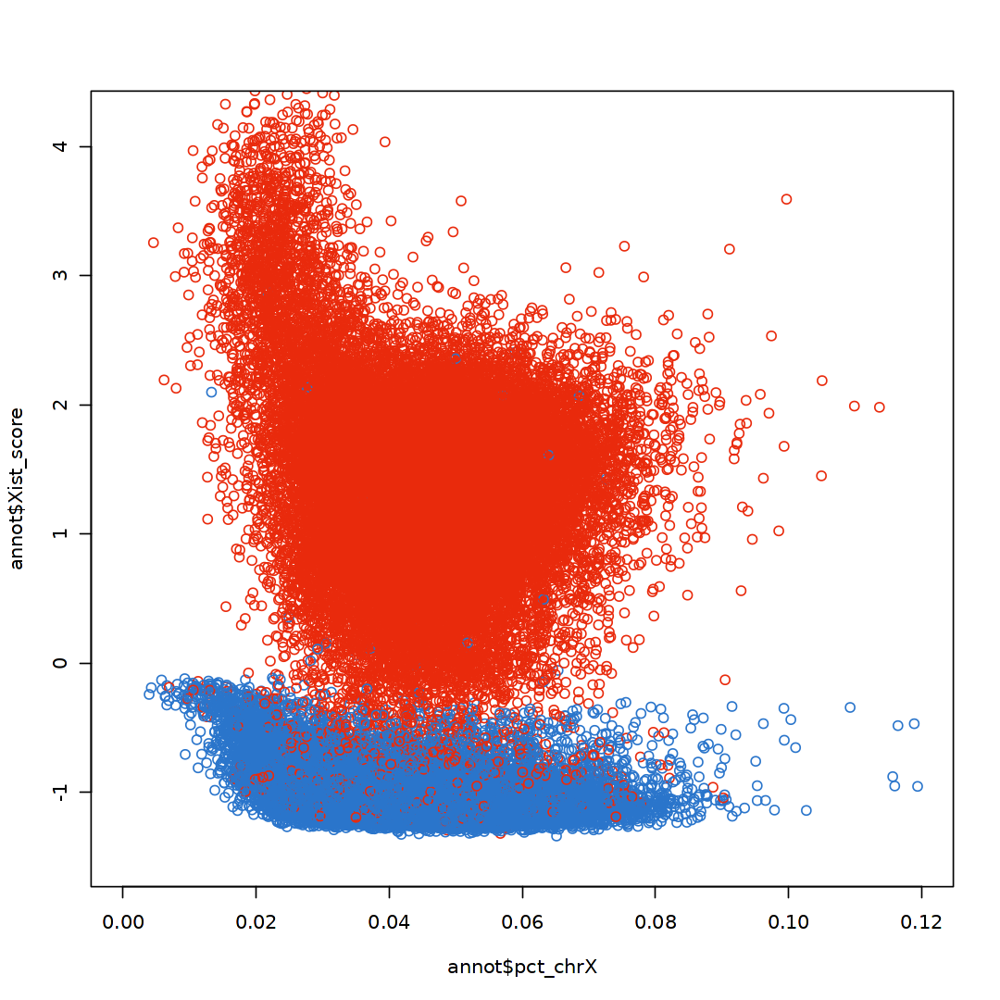

In [39]:
options(repr.plot.width=9, repr.plot.height=9)
plot(annot$pct_chrX, annot$Xist_score, col=mapvalues(annot$Sex, from=names(sex_colors), to=sex_colors), xlim=c(0,0.12), ylim=c(-1.5,4.2))

The following `from` values were not present in `x`: M

The following `from` values were not present in `x`: F



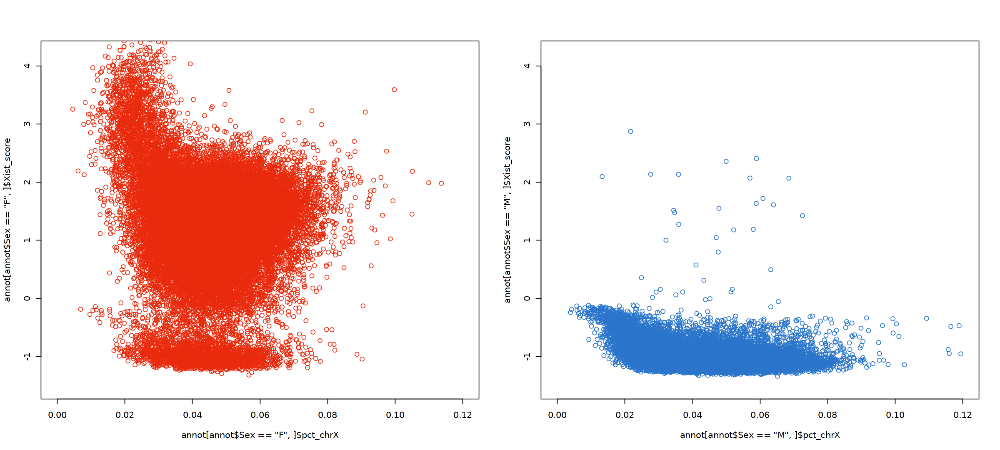

In [40]:
options(repr.plot.width=20, repr.plot.height=9)
par(mfrow=c(1,2))
plot(annot[annot$Sex=="F",]$pct_chrX, annot[annot$Sex=="F",]$Xist_score, col=mapvalues(annot[annot$Sex=="F",]$Sex, from=names(sex_colors), to=sex_colors), xlim=c(0,0.12), ylim=c(-1.5,4.2))
plot(annot[annot$Sex=="M",]$pct_chrX, annot[annot$Sex=="M",]$Xist_score, col=mapvalues(annot[annot$Sex=="M",]$Sex, from=names(sex_colors), to=sex_colors), xlim=c(0,0.12), ylim=c(-1.5,4.2))

In [41]:
sub <- sample(rownames(annot), round(0.30*length(rownames(annot))))

In [42]:
test_sample <- annot[sub,]
train_sample <- annot[!(rownames(annot) %in% sub),]

In [43]:
cv_folds <- createFolds(train_sample$Sex, k = 5, returnTrain = TRUE)

In [44]:
control <- trainControl(method = "cv",
                     number = 5,
                     search = 'grid',
                     classProbs = TRUE,
                     savePredictions = "final",
                     index = cv_folds,
                     summaryFunction = twoClassSummary)

#### 7.1.3 Training parameters

In [45]:
nrow(train_sample)

[1] 43316

In [46]:
tuneGrid <- expand.grid(.mtry = c(1:2))

In [53]:
ntrees <- c(5000, 10000)    
nodesize <- c(20, 30, 50, 80)

params <- expand.grid(ntrees = ntrees, nodesize = nodesize)

In [54]:
store_maxnode <- vector("list", nrow(params))
for(i in 1:nrow(params)){
    nodesize <- params[i,2]
    ntree <- params[i,1]
    print(nodesize)
    print(ntree)
    set.seed(65)
    rf_model <- train(Sex~., data = train_sample, method = "rf", importance=TRUE, metric = "ROC", tuneGrid = tuneGrid, trControl = control, ntree = ntree, nodesize = nodesize)
    store_maxnode[[i]] <- rf_model
}

[1] 20
[1] 5000
[1] 20
[1] 10000
[1] 30
[1] 5000
[1] 30
[1] 10000
[1] 50
[1] 5000
[1] 50
[1] 10000
[1] 80
[1] 5000
[1] 80
[1] 10000


In [55]:
names(store_maxnode) <- paste("ntrees:", params$ntrees, "nodesize:", params$nodesize)

In [56]:
results_mtry <- resamples(store_maxnode)

In [57]:
summary(results_mtry)


Call:
summary.resamples(object = results_mtry)

Models: ntrees: 5000 nodesize: 20, ntrees: 10000 nodesize: 20, ntrees: 5000 nodesize: 30, ntrees: 10000 nodesize: 30, ntrees: 5000 nodesize: 50, ntrees: 10000 nodesize: 50, ntrees: 5000 nodesize: 80, ntrees: 10000 nodesize: 80 
Number of resamples: 5 

ROC 
                                Min.   1st Qu.    Median      Mean   3rd Qu.
ntrees: 5000 nodesize: 20  0.9912206 0.9916337 0.9921863 0.9919655 0.9922476
ntrees: 10000 nodesize: 20 0.9913253 0.9916312 0.9921823 0.9919822 0.9922332
ntrees: 5000 nodesize: 30  0.9914523 0.9917227 0.9922410 0.9920464 0.9922571
ntrees: 10000 nodesize: 30 0.9914540 0.9917302 0.9922397 0.9920457 0.9922565
ntrees: 5000 nodesize: 50  0.9916225 0.9918259 0.9922091 0.9920788 0.9922307
ntrees: 10000 nodesize: 50 0.9916245 0.9918308 0.9921990 0.9920778 0.9922254
ntrees: 5000 nodesize: 80  0.9915905 0.9917158 0.9920850 0.9920067 0.9921791
ntrees: 10000 nodesize: 80 0.9916916 0.9918093 0.9920666 0.9920396 0.9921792


In [58]:
lapply(store_maxnode, function(x) x$results[x$results$ROC == max(x$results$ROC),])

,mtry,ROC,Sens,Spec,ROCSD,SensSD,SpecSD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2,2,0.9919655,0.9255912,0.9753988,0.0005297188,0.002801857,0.002071914
,mtry,ROC,Sens,Spec,ROCSD,SensSD,SpecSD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2,2,0.9919822,0.9253607,0.9753064,0.0004919522,0.002763666,0.002331709
,mtry,ROC,Sens,Spec,ROCSD,SensSD,SpecSD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2,2,0.9920464,0.9231478,0.9796532,0.0004479684,0.003358941,0.002283054
,mtry,ROC,Sens,Spec,ROCSD,SensSD,SpecSD
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>


#### 7.1.4 Generate model

In [59]:
#Best params
ntrees = 5000
nodesize  = 50

In [60]:
tuneGrid <- expand.grid(.mtry = 1)

In [61]:
rf_gridsearch <- train(Sex~., data = train_sample, method = "rf", importance=TRUE, metric = "ROC", tuneGrid = tuneGrid, trControl = control, ntree = ntrees, nodesize = nodesize)

In [62]:
print(rf_gridsearch)

Random Forest 

43316 samples
    3 predictor
    2 classes: 'F', 'M' 

No pre-processing
Resampling: Cross-Validated (5 fold) 
Summary of sample sizes: 34653, 34653, 34652, 34653, 34653 
Resampling results:

  ROC        Sens       Spec    
  0.9916892  0.9113457  0.996578

Tuning parameter 'mtry' was held constant at a value of 1


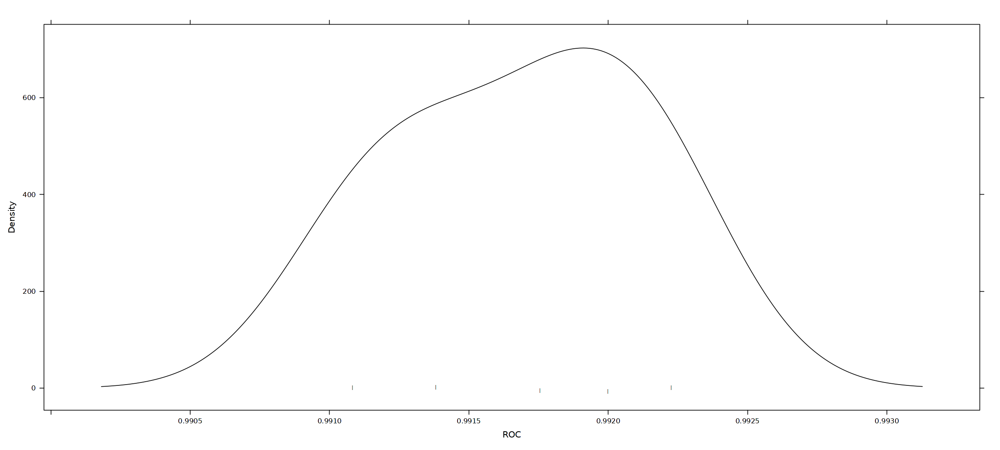

In [63]:
trellis.par.set(caretTheme())
densityplot(rf_gridsearch, pch = "|")

In [64]:
rf_imp <- varImp(rf_gridsearch)

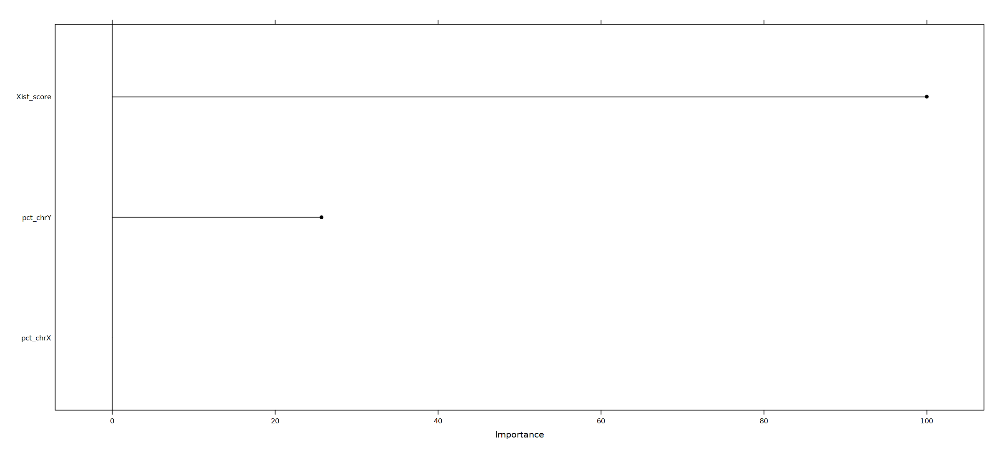

In [65]:
plot(rf_imp, top = 3)

In [66]:
groundThruth_sex_mitigated <- NULL
groundThruth <- NULL

[Save](#X.1-Savings)

### 7.2 Validation

#### 7.2.1 With the test sample

In [68]:
predictions <- predict(rf_gridsearch, test_sample)
predictions <- as.vector(predictions)

In [69]:
predictions_prob <- predict(rf_gridsearch, test_sample, type = "prob")

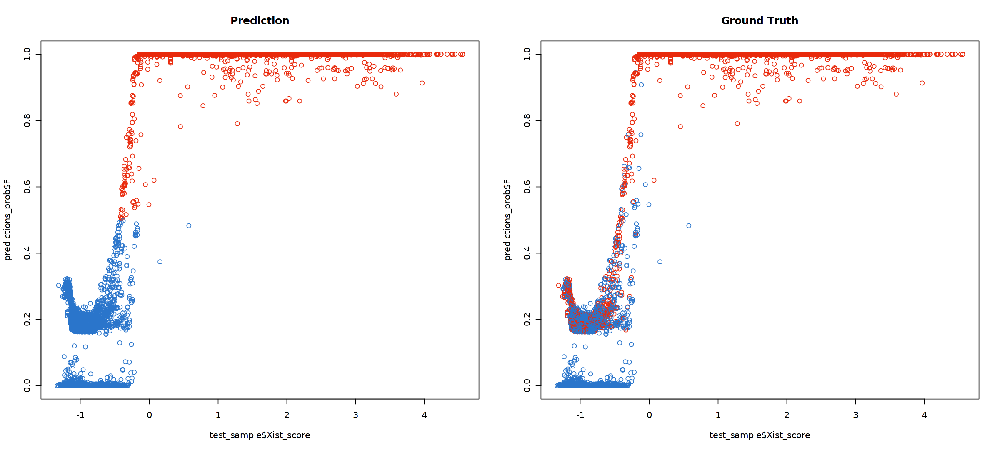

In [70]:
options(repr.plot.width=20, repr.plot.height=9)
par(mfrow=c(1,2))
plot(test_sample$Xist_score, predictions_prob$F, main="Prediction", col=mapvalues(predictions, from=names(sex_colors), to=sex_colors))
plot(test_sample$Xist_score, predictions_prob$F, main="Ground Truth", col=mapvalues(test_sample$Sex, from=names(sex_colors), to=sex_colors))

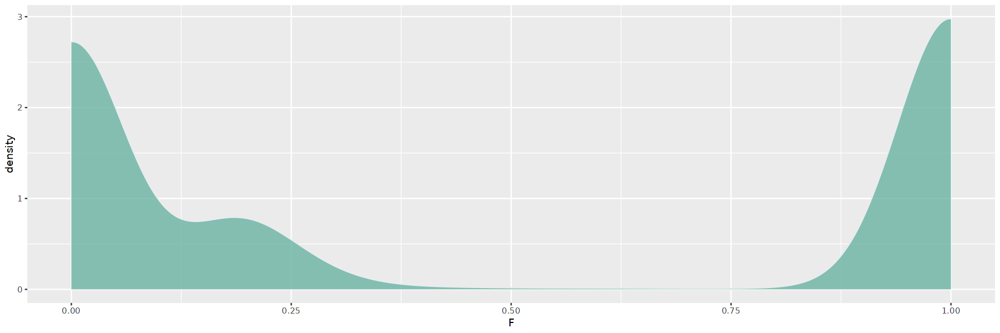

In [71]:
options(repr.plot.width=15, repr.plot.height=5)
ggplot(predictions_prob,aes(x=F)) + geom_density(fill="#69b3a2", color="#e9ecef", alpha=0.8)

In [72]:
u_pred <- unique(predictions)
u_test <- unique(test_sample$Sex)
cm <- Matrix::sparseMatrix(i = match(predictions, u_pred), j = match(test_sample$Sex, 
    u_test), x = rep(1, length(predictions)), dims = c(length(u_pred), length(u_test)))
rownames(cm) <- u_pred
colnames(cm) <- u_test

In [73]:
cm

2 x 2 sparse Matrix of class "dgCMatrix"
     M    F
M 9287  834
F   28 8415

In [74]:
accuracy = (cm['F','F']+cm['M','M'])/(cm['F','F']+cm['M','M']+cm['F','M']+cm['M','F'])
sensitivity = cm['F','F']/(cm['F','F']+cm['M','F'])
specificity = cm['M','M']/(cm['M','M']+cm['F','M'])

In [75]:
accuracy

[1] 0.953566

In [76]:
sensitivity

[1] 0.9098281

In [77]:
specificity

[1] 0.9969941

#### 7.2.2 With Nature 2016 paper

In [78]:
annot_Science2016 <- readRDS(file=paste0(datasets_path,"Marques_Science2016/annoscience.rds"))
emat_Science2016 <- readRDS(file=paste0(datasets_path,"Marques_Science2016/ematscience.rds"))

In [79]:
Science2016 <- CreateSeuratObject(emat_Science2016, project = "SeuratProject", assay = "RNA", min.cells = 0, min.features = 0, names.field = 1, names.delim = "_", meta.data = annot_Science2016)

Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"


In [80]:
DefaultAssay(Science2016) <- "RNA"

In [81]:
Science2016 <- NormalizeData(Science2016, normalization.method = "LogNormalize", scale.factor = 10000)

Normalizing layer: counts

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [82]:
Science2016 <- FindVariableFeatures(Science2016, selection.method = "vst", nfeatures = 1000)

Finding variable features for layer counts

Calculating gene variances
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|
Calculating feature variances of standardized and clipped values
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [83]:
Science2016 <- ScaleData(Science2016, features = rownames(Science2016))

Centering and scaling data matrix

  |======================================================================| 100%


In [84]:
Science2016 <- RunPCA(Science2016)

PC_ 1 
Positive:  Gpm6a, Snhg11, Meg3, Stmn2, Resp18, Celf4, Gprasp2, Snap25, Ndrg4, Pnck 
	   Scg2, Tagln3, Caly, Atp1a3, Tmem130, Zcchc12, Nsg2, Gria2, Ttc3, Slc12a5 
	   Disp2, Syt4, Tmem59l, Eno2, Ahi1, Chgb, Tubb2a, Hap1, Nsg1, Basp1 
Negative:  Car2, Mag, Apod, Anln, Glul, Tubb4a, Clic4, Sepp1, Serpinb1a, Gstp1 
	   Tppp3, Cyp2j12, Nudt4, Grm3, Plin3, Cd59a, Neat1, Klk6, Pmp22, Ptgds 
	   Rasgrp3, Il33, Rab37, Npsr1, H2afj, Anxa5, Arc, S100b, S100a6, Wfdc18 
PC_ 2 
Positive:  Mag, Nfasc, Resp18, Slc12a5, Scg2, Tmem130, Atp1a3, Zcchc12, Stmn2, Ndn 
	   Caly, Nrsn2, Ndrg4, Ahi1, Celf4, Snap25, Zcchc18, Eno2, Nap1l5, Clic4 
	   Gabrg2, Zwint, Tppp3, Prkar1b, Meg3, Uchl1, Tmem59l, Syt1, Chgb, Disp2 
Negative:  Igf2, Dcn, Col1a2, Slc6a13, Nupr1, Igfbp2, Itih5, Pcolce, Vtn, Tbx18 
	   Lum, Bgn, Edn3, Col3a1, Col4a5, Colec12, Spp1, Lama1, Cp, Fcgrt 
	   Serpinh1, Lgals1, Prelp, Ctgf, Cped1, Itih2, Col1a1, Cyp1b1, Flrt2, Col4a1 
PC_ 3 
Positive:  Apod, Car2, Tppp3, Sepp1, Gstp1, Glul, Ma

In [85]:
Science2016 <- FindNeighbors(Science2016, reduction = "pca", dims = 1:10, graph.name="sex_RNA")

Computing nearest neighbor graph

Computing SNN

Only one graph name supplied, storing nearest-neighbor graph only



In [86]:
Science2016 <- RunUMAP(Science2016, reduction = "pca", reduction.name="umapsex_RNA", dims = 1:10)

16:56:41 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by 'BiocGenerics'

16:56:41 Read 5069 rows and found 10 numeric columns

16:56:41 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by 'BiocGenerics'

16:56:41 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:56:42 Writing NN index file to temp file /tmp/RtmprqKfoX/fileec466880a9b

16:56:42 Searching Annoy index using 1 thread, search_k = 3000

16:56:44 Annoy recall = 100%

16:56:46 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:56:48 Initializing from normalized Laplacian + no

In [87]:
genes.table <- genes.table[genes.table$external_gene_name %in% rownames(Science2016), ]

chrY.gene = genes.table$external_gene_name[genes.table$chromosome_name == "Y"]
chrX.gene = genes.table$external_gene_name[genes.table$chromosome_name == "X"]

In [88]:
Science2016$pct_chrY = colSums(Science2016@assays$RNA$counts[chrY.gene, ])/colSums(Science2016@assays$RNA$counts)
Science2016$pct_chrX = colSums(Science2016@assays$RNA$counts[chrX.gene, ])/colSums(Science2016@assays$RNA$counts)

cd_features <- list('Xist')
Science2016 <- AddModuleScore(
  object = Science2016 ,
  features = cd_features,
  ctrl = 100,
  name = 'Xist_score'
)

In [89]:
annot_Science2016 <- Science2016@meta.data[,c(9,12,13,14)]

annot_Science2016 <- annot_Science2016[annot_Science2016$sex %in% c(1, -1),]

mapSet = setNames(c("F", "M"), c(1, -1))
names(mapSet) <- as.character(names(mapSet))
annot_Science2016$Sex <- mapSet[as.character(unlist(annot_Science2016$sex))]

In [90]:
annot_Science2016 <- annot_Science2016[,c(5,2,3,4)]

In [91]:
colnames(annot_Science2016) <- c("Sex", "pct_chrY", "pct_chrX", "Xist_score")

In [92]:
predictions <- predict(rf_gridsearch, annot_Science2016)
predictions <- as.vector(predictions)

In [93]:
u_pred <- unique(predictions)
u_test <- unique(annot_Science2016$Sex)
cm <- Matrix::sparseMatrix(i = match(predictions, u_pred), j = match(annot_Science2016$Sex, 
    u_test), x = rep(1, length(predictions)), dims = c(length(u_pred), length(u_test)))
rownames(cm) <- u_pred
colnames(cm) <- u_test

In [94]:
cm

2 x 2 sparse Matrix of class "dgCMatrix"
     F    M
F 1667   10
M  132 2323

In [95]:
accuracy = (cm['F','F']+cm['M','M'])/(cm['F','F']+cm['M','M']+cm['F','M']+cm['M','F'])
sensitivity = cm['F','F']/(cm['F','F']+cm['M','F'])
specificity = cm['M','M']/(cm['M','M']+cm['F','M'])

In [96]:
accuracy

[1] 0.9656341

In [97]:
sensitivity

[1] 0.9266259

In [98]:
specificity

[1] 0.9957137

## 8. Remove LateCtrl1 sample

In [90]:
MORNAATACC <- subset(MORNAATACC, subset = orig.ident != "LateCtrl1")

In [91]:
#Colors after removing LateCtrl1
orig.ident_colors <- c("#1F5898", "#2A75CB", "5695DC", 
                       "#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#BCC8BC", "#D2DAD2", "#E9EDE9", 
                       "#7A5600", "#B88100", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6",
                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8",
                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
names(orig.ident_colors) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#5B1865", "#E54F6D",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
names(orig.ident_colors_contrast) <- c("Naive1", "Naive2", "Naive3", 
                              "EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "Early2", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")

date_tissue_coll_colors <- scales::viridis_pal()(17)
names(date_tissue_coll_colors) <- c('2021_04_30','2021_05_03','2021_05_31','2021_09_30','2021_10_06','2021_11_26','2022_03_09','2022_03_10','2022_08_03','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2022_05_12','2022_05_16')

date_exp_colors <- scales::viridis_pal()(7)
names(date_exp_colors) <- c('2021_04_20','2021_09_22','2021_11_17','2022_01_31','2022_07_18','2023_01_09','2023_06_05')

EAE_score_mean_colors <- scales::viridis_pal()(7)
names(EAE_score_mean_colors) <- c(0,0.5,2,2.25,2.33,2.5,3)

In [92]:
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3")

In [93]:
MORNAATACC$orig.ident <- factor(x = MORNAATACC$orig.ident, levels = names(orig.ident_colors))
MORNAATACC$date_tissue_collection <- factor(x = MORNAATACC$date_tissue_collection, levels = names(date_tissue_coll_colors))
MORNAATACC$date_experiment <- factor(x = MORNAATACC$date_experiment, levels = names(date_exp_colors))
MORNAATACC$EAE_score_mean <- factor(x = MORNAATACC$EAE_score_mean, levels = names(EAE_score_mean_colors))

## 9. Apply sex to all cells

In [94]:
genes.table <- genes.table[genes.table$external_gene_name %in% rownames(MORNAATACC), ]

chrY.gene = genes.table$external_gene_name[genes.table$chromosome_name == "Y"]
chrX.gene = genes.table$external_gene_name[genes.table$chromosome_name == "X"]

In [95]:
MORNAATACC$pct_chrY = colSums(MORNAATACC@assays$RNA$counts[chrY.gene, ])/colSums(MORNAATACC@assays$RNA$counts)
MORNAATACC$pct_chrX = colSums(MORNAATACC@assays$RNA$counts[chrX.gene, ])/colSums(MORNAATACC@assays$RNA$counts)

cd_features <- list('Xist')
MORNAATACC <- AddModuleScore(
  object = MORNAATACC,
  features = cd_features,
  ctrl = 200,
  name = 'Xist_score'
)

In [96]:
colnames(MORNAATACC@meta.data)[(ncol(MORNAATACC@meta.data)-2):ncol(MORNAATACC@meta.data)] <- c("pct_chrY", "pct_chrX", "Xist_score")

In [97]:
annot_MORNAATACC <- MORNAATACC@meta.data[,c("pct_chrY", "pct_chrX", "Xist_score")]

In [98]:
predictions <- predict(rf_gridsearch, annot_MORNAATACC)
predictions <- as.vector(predictions)

In [99]:
predictions_prob <- predict(rf_gridsearch, annot_MORNAATACC, type = "prob")

In [100]:
MORNAATACC$Sex_predictions <- predictions

In [101]:
MORNAATACC$Sex_predictions_F <- predictions_prob$F
MORNAATACC$Sex_predictions_M <- predictions_prob$M

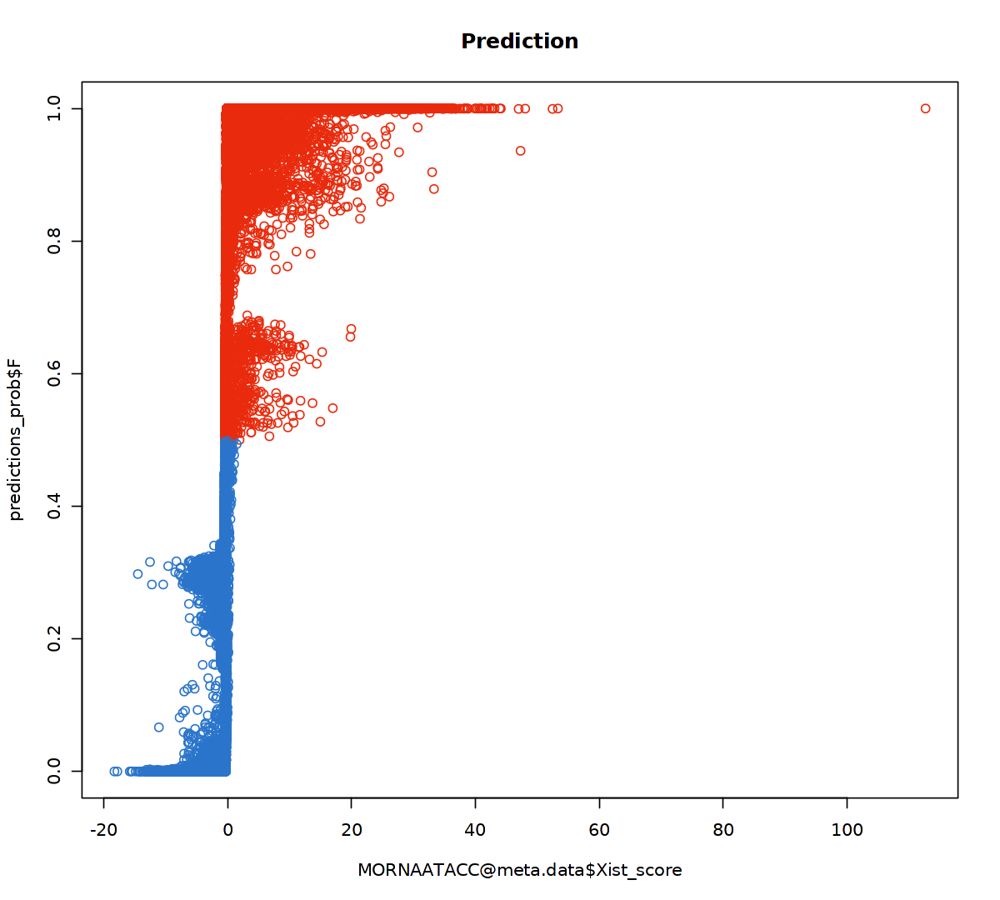

In [25]:
options(repr.plot.width=10, repr.plot.height=9)
plot(MORNAATACC@meta.data$Xist_score, predictions_prob$F, main="Prediction", col=mapvalues(predictions, from=names(sex_colors), to=sex_colors))

In [103]:
cm <- table(MORNAATACC$orig.ident, MORNAATACC$Sex_predictions)

In [104]:
cm

                  
                       F     M
  Naive1            1952  3413
  Naive2            2866  4162
  Naive3            2577  3650
  EarlyCtrl2         156   312
  EarlyCtrl3        1940  1653
  EarlyCtrl4        2747  4292
  EarlyCtrlMale5      26  8201
  EarlyCtrlFemale5  7214  1154
  PeakCtrl2         1304  1907
  PeakCtrl3          785  1330
  LateCtrl2         3859  4639
  LateCtrl3         3826  3585
  Early1            1774  2433
  Early2             386   735
  EarlyFemale3      2717   707
  EarlyMale3          24  3720
  Early4            1931  1283
  EarlyMale5         111 10485
  EarlyFemale5      9241  1848
  Peak2              802   960
  Peak3             2135  1593
  PeakMale4            9  3391
  PeakFemale4       3323   516
  Peak5             1276  2817
  Late1             1479  3036
  Late2              681  1001
  Late3             1381  2929
  LateMale4           70  4903
  LateFemale4       8901  1171
  Late5             3146  3070

In [105]:
male_sample <- c("EarlyCtrlMale5", "EarlyMale3", "EarlyMale5", "PeakMale4", "LateMale4")
female_sample <- c("EarlyCtrlFemale5", "EarlyFemale3", "EarlyFemale5", "PeakFemale4", "LateFemale4")

In [106]:
accuracy = (sum(cm[female_sample,'F'])+sum(cm[male_sample,'M']))/(sum(cm[female_sample,'F'])+sum(cm[male_sample,'M'])+sum(cm[female_sample,'M'])+sum(cm[male_sample,'F']))

In [108]:
accuracy

[1] 0.9167897

In [109]:
t <- cm[c(male_sample, female_sample),]
t <- t[,rev(names(sex_colors))]

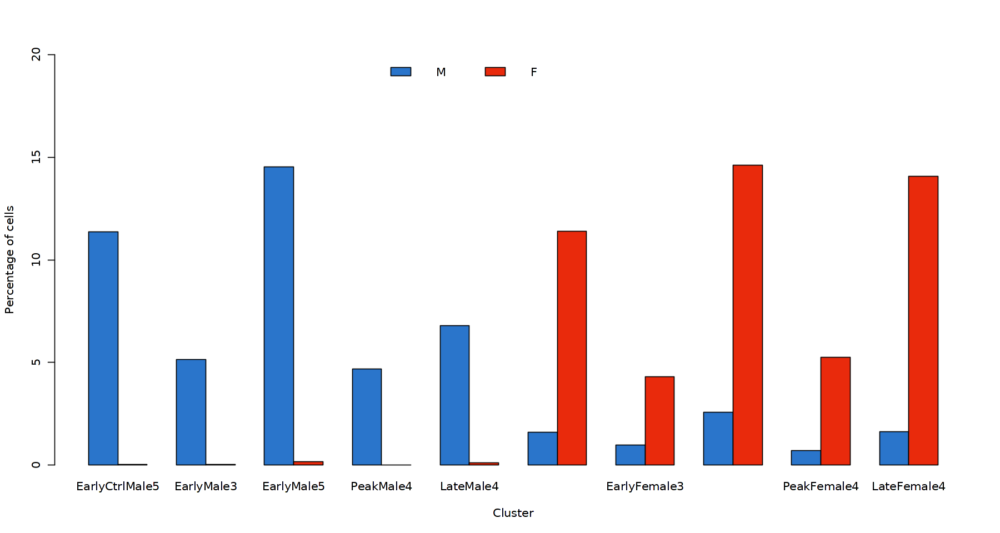

In [110]:
t_percent <- round(prop.table(t, 2) * 100 ,digits = 2)/ncol(t)
options(repr.plot.width=15, repr.plot.height=8)
barplot(t(t_percent), beside=TRUE, xlab = "Cluster", ylab="Percentage of cells", legend = TRUE, ylim = c(0, round_any(as.integer(max(t_percent)), 10, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

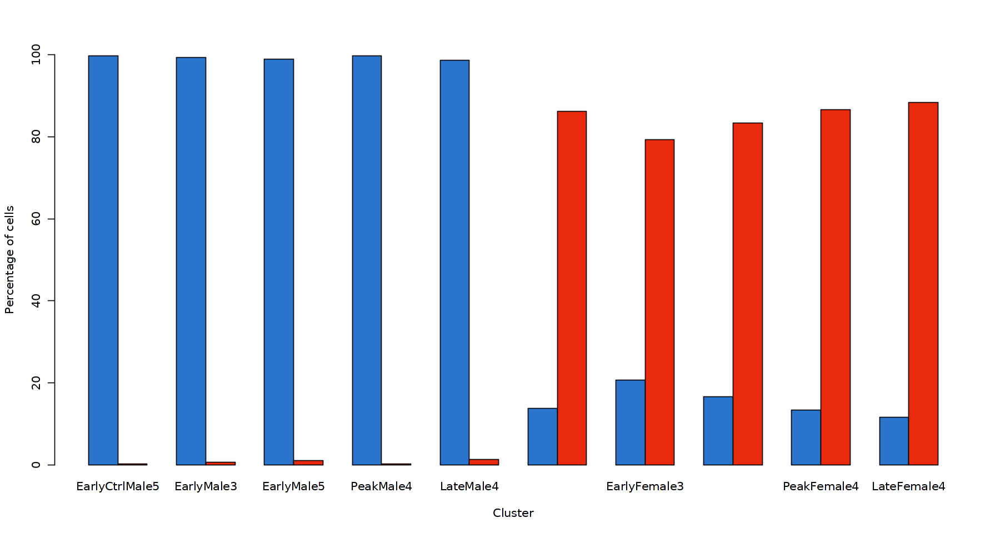

In [111]:
t_percent <- round(prop.table(t, 1) * 100 ,digits = 2)
options(repr.plot.width=15, repr.plot.height=8)
barplot(t(t_percent), beside=TRUE, xlab = "Cluster", ylab="Percentage of cells", legend = FALSE, ylim = c(0, round_any(as.integer(max(t_percent)), 10, f = ceiling)), col = rev(sex_colors), args.legend = list(bty = "n", x = "top", ncol = 3))

In [112]:
conf <- c()
conf <- c(conf, t["EarlyCtrlMale5","M"]*100/sum(t["EarlyCtrlMale5",]))
conf <- c(conf, t["EarlyMale3","M"]*100/sum(t["EarlyMale3",]))
conf <- c(conf, t["EarlyMale5","M"]*100/sum(t["EarlyMale5",]))
conf <- c(conf, t["PeakMale4","M"]*100/sum(t["PeakMale4",]))
conf <- c(conf, t["LateMale4","M"]*100/sum(t["LateMale4",]))
conf <- c(conf, t["EarlyCtrlFemale5","F"]*100/sum(t["EarlyCtrlFemale5",]))
conf <- c(conf, t["EarlyFemale3","F"]*100/sum(t["EarlyFemale3",]))
conf <- c(conf, t["EarlyFemale5","F"]*100/sum(t["EarlyFemale5",]))
conf <- c(conf, t["PeakFemale4","F"]*100/sum(t["PeakFemale4",]))
conf <- c(conf, t["LateFemale4","F"]*100/sum(t["LateFemale4",]))
names(conf) <- c("M", "M", "M", "M", "M", "F", "F", "F", "F", "F")

In [113]:
t_conf <- data.frame(Confidence=conf, Sex=names(conf), Color=rep(rev(sex_colors),each=5))

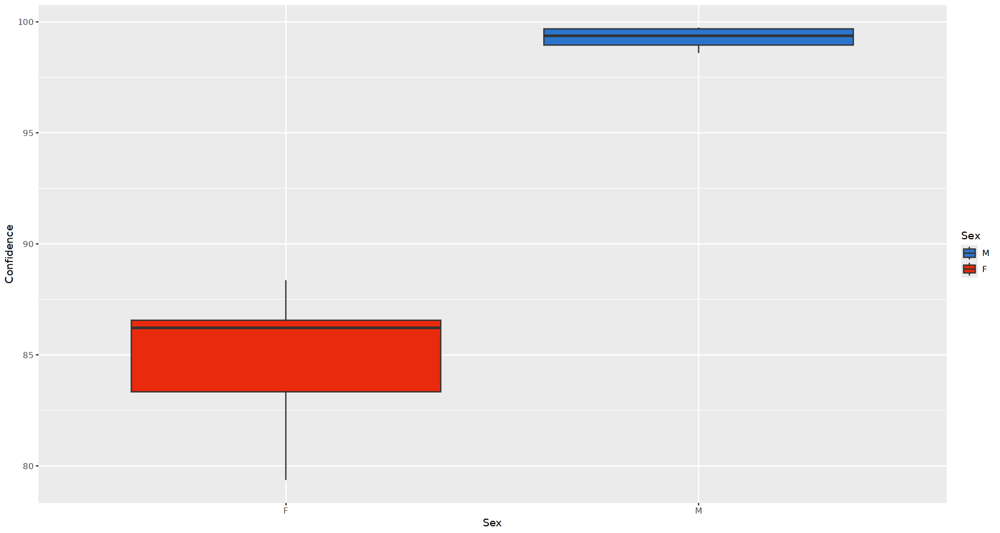

In [114]:
options(repr.plot.width=15, repr.plot.height=8)
ggplot(t_conf, aes(x = Sex, y = Confidence, fill = Sex)) +
  geom_boxplot() +
  scale_fill_manual(breaks = t_conf$Sex, values = t_conf$Color)

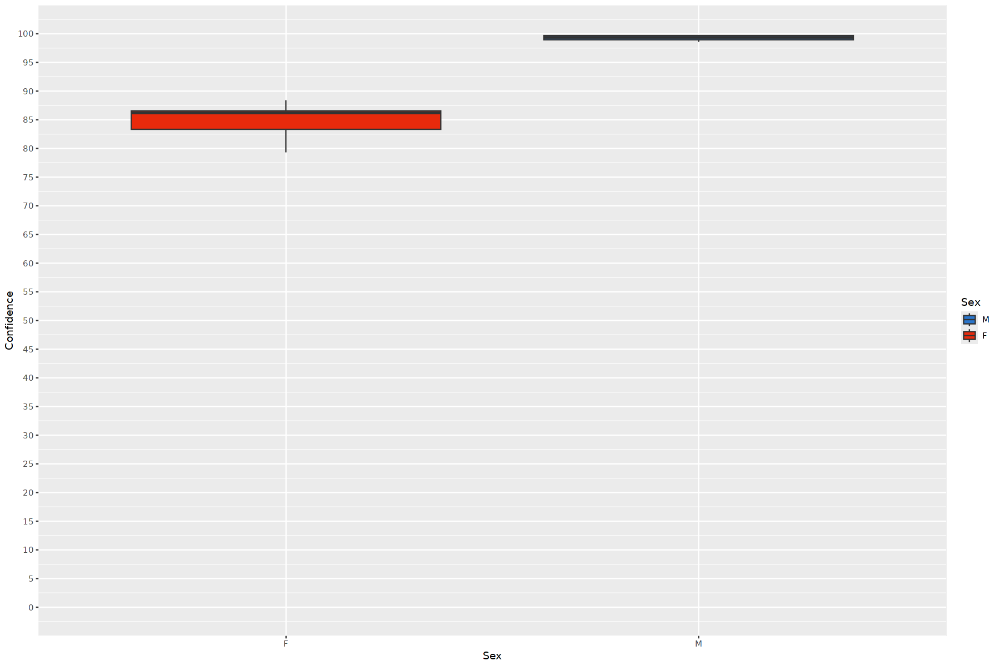

In [115]:
options(repr.plot.width=15, repr.plot.height=10)
ggplot(t_conf, aes(x = Sex, y = Confidence, fill = Sex)) +
  geom_boxplot() +
  scale_fill_manual(breaks = t_conf$Sex, values = t_conf$Color) +
  scale_y_continuous(breaks = seq(0, 100, 5), limits = c(0,100))

In [116]:
MORNAATACC$Sex <- MORNAATACC$Sex_predictions
for (i in 1:nrow(MORNAATACC@meta.data)){
    if (MORNAATACC@meta.data[i,"orig.ident"] %in% male_sample){
        MORNAATACC@meta.data[i,"Sex"] <- "M"
    } else if(MORNAATACC@meta.data[i,"orig.ident"] %in% female_sample){
        MORNAATACC@meta.data[i,"Sex"] <- "F"
    }
}

In [117]:
MORNAATACC$Sex <- factor(x = MORNAATACC$Sex, levels = names(sex_colors))

In [118]:
table(MORNAATACC$orig.ident, MORNAATACC$Sex)

                  
                       F     M
  Naive1            1952  3413
  Naive2            2866  4162
  Naive3            2577  3650
  EarlyCtrl2         156   312
  EarlyCtrl3        1940  1653
  EarlyCtrl4        2747  4292
  EarlyCtrlMale5       0  8227
  EarlyCtrlFemale5  8368     0
  PeakCtrl2         1304  1907
  PeakCtrl3          785  1330
  LateCtrl2         3859  4639
  LateCtrl3         3826  3585
  Early1            1774  2433
  Early2             386   735
  EarlyFemale3      3424     0
  EarlyMale3           0  3744
  Early4            1931  1283
  EarlyMale5           0 10596
  EarlyFemale5     11089     0
  Peak2              802   960
  Peak3             2135  1593
  PeakMale4            0  3400
  PeakFemale4       3839     0
  Peak5             1276  2817
  Late1             1479  3036
  Late2              681  1001
  Late3             1381  2929
  LateMale4            0  4973
  LateFemale4      10072     0
  Late5             3146  3070

In [119]:
tmp <- subset(MORNAATACC, subset = orig.ident %in% c("EarlyCtrlMale5", "EarlyCtrlFemale5", "EarlyMale3", "EarlyFemale3", "EarlyMale5", "EarlyFemale5", "PeakMale4", "PeakFemale4", "LateMale4", "LateFemale4"))

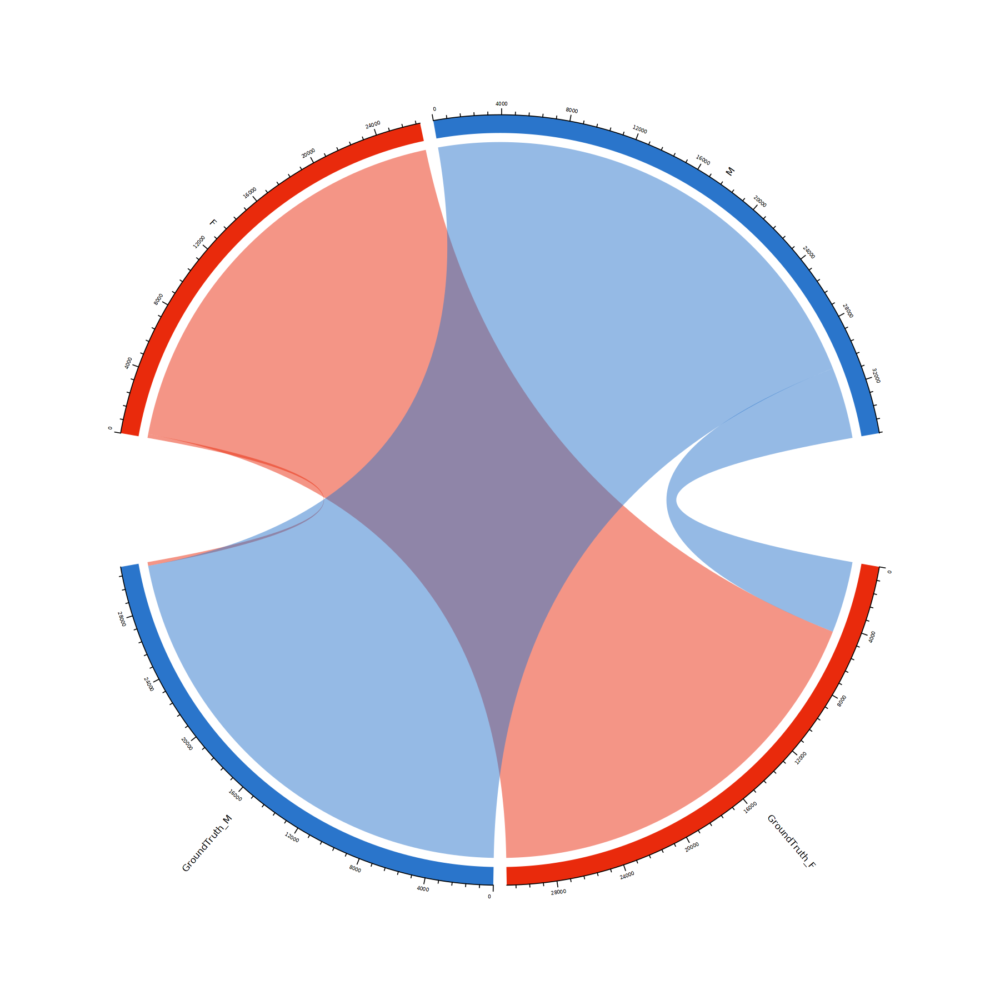

In [120]:
options(repr.plot.width=15, repr.plot.height=15)
set.seed(115)
mat = as.matrix(table(tmp@meta.data$Sex_predictions, tmp@meta.data$Sex))
colnames(mat) <- paste0("GroundTruth_", colnames(mat))
for(col in 1:ncol(mat)) mat[,col] <- as.integer(mat[,col]/(sum(mat[,col])/min(colSums(mat))))
circos.clear()
par(cex = 0.8)
groundtruth_colors <- sex_colors
names(groundtruth_colors) <- colnames(mat)
chordDiagram(mat, annotationTrack = c("grid", "axis"), preAllocateTracks = list(track.height = max(strwidth(unlist(dimnames(mat))))/3), big.gap = 20, small.gap = 2, order = c(colnames(mat), names(sex_colors)), grid.col=c(rev(sex_colors), groundtruth_colors))
circos.track(track.index = 1, panel.fun = function(x, y) {circos.text(CELL_META$xcenter, CELL_META$ylim[1], CELL_META$sector.index, facing = "clockwise", niceFacing = TRUE, adj = c(-0.3, 0.5))}, bg.border = NA)

In [121]:
tmp <- NULL

## X. Checkpoints

### X.1 Savings

In [61]:
#2.4
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_AfterLoading.rds"))

In [12]:
#2.4
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_AfterLoading.rds"))

In [21]:
#3.1
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_AfterTSS.rds"))

In [141]:
#3.1
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_AfterTSS.rds"))

In [85]:
#3.3
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_AfterQC.rds"))

In [9]:
#3.3
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_AfterQC.rds"))

In [255]:
#4
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_AfterRecalPeaks.rds"))

In [9]:
#4
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_AfterRecalPeaks.rds"))

In [42]:
#5
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_AfterGeneAcc.rds"))

In [29]:
#5
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_AfterGeneAcc.rds"))

In [69]:
#6.4
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_AfterDoublets.rds"))

In [10]:
#6.4
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_AfterDoublets.rds"))

In [67]:
#7.1
saveRDS(rf_gridsearch, paste0(OS_path_outputs, "sex_model.rds"))

In [86]:
#7.1
rf_gridsearch <- readRDS(paste0(OS_path_outputs, "sex_model.rds"))

In [122]:
#End MORNAATACC_1
saveRDS(MORNAATACC, paste0(OS_path_outputs, "MORNAATACC_1.rds"))

In [8]:
#End MORNAATACC_1
MORNAATACC <- readRDS(paste0(OS_path_outputs, "MORNAATACC_1.rds"))